In [1]:
# Import libraries
from sklearn.ensemble import GradientBoostingClassifier
import xgboost as xgb
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import StackingClassifier
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from Paquetes.HelperFunctions import violin_plot_numeric, null_percentage, value_counts_all_cols, train_models, validate_models
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder, OneHotEncoder
from sklearn.base import BaseEstimator, ClassifierMixin, TransformerMixin
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import plotly.express as px
from tqdm import tqdm
from sklearn.model_selection import cross_val_score, KFold, StratifiedKFold, GroupKFold, RepeatedStratifiedKFold
import lightgbm as lgb
from sklearn.metrics import log_loss
import xgboost as xgb
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score, recall_score, classification_report
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.svm import SVC
from sklearn.multiclass import OneVsRestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import StackingClassifier
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import os
import imblearn
from Paquetes.metrics import  clasification_metrics
from Paquetes.cross_validate import cv_function
# Imbalanced learn library
import imblearn


# MULTI-CLASS PREDICTION ABOUT CIRRHOSIS

Your Goal: For this Episode of the Series, your task is to use a multi-class approach to predict the the outcomes of patients with cirrhosis. Good luck!

### Import dataset

URL: https://www.kaggle.com/competitions/playground-series-s3e26/overview

In [2]:
import pandas as pd
import numpy as np
train = pd.read_csv("./data/train.csv")
test = pd.read_csv("./data/test.csv")
sample = pd.read_csv("./data/sample_submission.csv")

### EDA

#### First approach: Basic exploration of the dataset shape and its columns information.


In [3]:
train.head()

,id,N_Days,Drug,Age,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Status
0,0,999,D-penicillamine,21532,M,N,N,N,N,2.3,316.0,3.35,172.0,1601.0,179.80,63.0,394.0,9.7,3.0,D
1,1,2574,Placebo,19237,F,N,N,N,N,0.9,364.0,3.54,63.0,1440.0,134.85,88.0,361.0,11.0,3.0,C
2,2,3428,Placebo,13727,F,N,Y,Y,Y,3.3,299.0,3.55,131.0,1029.0,119.35,50.0,199.0,11.7,4.0,D
3,3,2576,Placebo,18460,F,N,N,N,N,0.6,256.0,3.50,58.0,1653.0,71.30,96.0,269.0,10.7,3.0,C
4,4,788,Placebo,16658,F,N,Y,N,N,1.1,346.0,3.65,63.0,1181.0,125.55,96.0,298.0,10.6,4.0,C


In [4]:
test.head()

,id,N_Days,Drug,Age,Sex,Ascites,Hepatomegaly,Spiders,Edema,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage
0,7905,3839,D-penicillamine,19724,F,N,Y,N,N,1.2,546.0,3.37,65.0,1636.0,151.90,90.0,430.0,10.6,2.0
1,7906,2468,D-penicillamine,14975,F,N,N,N,N,1.1,660.0,4.22,94.0,1257.0,151.90,155.0,227.0,10.0,2.0
2,7907,51,Placebo,13149,F,N,Y,N,Y,2.0,151.0,2.96,46.0,961.0,69.75,101.0,213.0,13.0,4.0
3,7908,2330,D-penicillamine,20510,F,N,N,N,N,0.6,293.0,3.85,40.0,554.0,125.55,56.0,270.0,10.6,2.0
4,7909,1615,D-penicillamine,21904,F,N,Y,N,N,1.4,277.0,2.97,121.0,1110.0,125.00,126.0,221.0,9.8,1.0


In [5]:
desc_df = train.describe(include="all")
desc_df = desc_df.T
desc_df['unique'] = train.nunique()
desc_df['count'] = desc_df['count'].astype('int16')
desc_df['missing'] = train.shape[0] - desc_df['count']
desc_df['DType'] = train.dtypes
display(desc_df)

,count,unique,top,freq,mean,std,min,25%,50%,75%,max,missing,DType
id,7905,7905,NaN,NaN,3952.0,2282.121272,0.0,1976.0,3952.0,5928.0,7904.0,0,int64
N_Days,7905,461,NaN,NaN,2030.173308,1094.233744,41.0,1230.0,1831.0,2689.0,4795.0,0,int64
Drug,7905,2,Placebo,4010,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
Age,7905,391,NaN,NaN,18373.14649,3679.958739,9598.0,15574.0,18713.0,20684.0,28650.0,0,int64
Sex,7905,2,F,7336,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
Ascites,7905,2,N,7525,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
Hepatomegaly,7905,2,Y,4042,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
Spiders,7905,2,N,5966,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
Edema,7905,3,N,7161,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,object
Bilirubin,7905,111,NaN,NaN,2.594485,3.81296,0.3,0.7,1.1,3.0,28.0,0,float64


#### Missing values:

In [6]:
# secondary check (first one was done in the previous step, in the description of the columns) 
train.isnull().sum()

id               0
N_Days           0
Drug             0
Age              0
Sex              0
Ascites          0
Hepatomegaly     0
Spiders          0
Edema            0
Bilirubin        0
Cholesterol      0
Albumin          0
Copper           0
Alk_Phos         0
SGOT             0
Tryglicerides    0
Platelets        0
Prothrombin      0
Stage            0
Status           0
dtype: int64

No need to delete any row because there is not any missing values in the dataset.

#### Duplicated rows:

In [7]:
duplicate_rows = train.duplicated()

if not duplicate_rows.any():
    print("There are no duplicated rows in the dataset.")
else:
    print("Index of Deleted Duplicate Rows:")
    print(train.index[duplicate_rows])
    train.drop(train.index[duplicate_rows], inplace=True)

There are no duplicated rows in the dataset.


#### Imbalance of the target:

In [8]:
import plotly.express as px

status_percentages = train['Status'].value_counts(normalize=True) * 100

fig = px.pie(status_percentages.reset_index(), names='Status', values='proportion', title='Tarjet imbalance')
fig.show()


The target variable exhibits a significant imbalance, particularly in the 'CL' category.

#### Correlation:

In [9]:
from Paquetes.categorical_variables_association import identify_associations
LABEL = "Status"
CAT_FEATS = ["Drug", "Sex", "Ascites", "Hepatomegaly", "Spiders", "Edema", "Stage"] # train.select_dtypes(include=['object', 'bool']).columns, but removing the label column and adding 'Stage' because it is a discrete numerical variable. 
NUM_FEATS = [x for x in train.columns if x not in CAT_FEATS and x != LABEL]
ORG_FEATS = train.drop(LABEL, axis=1).columns.tolist() # original feats

identify_associations(train, CAT_FEATS)

p_values: 
                      Drug           Sex       Ascites   Hepatomegaly  \
Drug          0.000000e+00  8.526959e-05  3.638579e-05   2.335023e-08   
Sex           8.526959e-05  0.000000e+00  2.059298e-03   4.067653e-09   
Ascites       3.638579e-05  2.059298e-03  0.000000e+00   1.178137e-60   
Hepatomegaly  2.335023e-08  4.067653e-09  1.178137e-60   0.000000e+00   
Spiders       8.710678e-01  1.963521e-02  2.657517e-77  1.485341e-188   
Edema         5.347728e-03  1.135080e-09  0.000000e+00   1.007444e-89   
Stage         3.565950e-02  2.213108e-03  1.113955e-65   0.000000e+00   

                    Spiders          Edema          Stage  
Drug           8.710678e-01   5.347728e-03   3.565950e-02  
Sex            1.963521e-02   1.135080e-09   2.213108e-03  
Ascites        2.657517e-77   0.000000e+00   1.113955e-65  
Hepatomegaly  1.485341e-188   1.007444e-89   0.000000e+00  
Spiders        0.000000e+00  5.624272e-123  1.389001e-162  
Edema         5.624272e-123   0.000000e+00  

For categorical variables you can find association between the variables (instead of correlation) using Chi-squared test of independence. This test is quite lenient , in the sense, even for a weak association it will show a low p-value (so it is difficult to distinguish between weak and strong associations). 

To further validate the result of Chi-squared test of independence , you can calculate Crammers V-test which will give a specific value between 0 and 1:
- 0.1: Generally a weak association.
- 0.3: Generally a moderate association.
- 0.5 o superior: Generally a strong association.

So in this case:
- There is a strong association between the variables 'Edema' and 'Ascites' (0,66).
- There are moderate associations between the variables 'Hepatomegaly' and 'Spiders' (0,33), 'Hepatomegaly' and 'Status' (0,40) and 'Status' and 'Spiders' (0,32).

In [10]:
test.columns

Index(['id', 'N_Days', 'Drug', 'Age', 'Sex', 'Ascites', 'Hepatomegaly',
       'Spiders', 'Edema', 'Bilirubin', 'Cholesterol', 'Albumin', 'Copper',
       'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin',
       'Stage'],
      dtype='object')

In [11]:
train.columns

Index(['id', 'N_Days', 'Drug', 'Age', 'Sex', 'Ascites', 'Hepatomegaly',
       'Spiders', 'Edema', 'Bilirubin', 'Cholesterol', 'Albumin', 'Copper',
       'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin',
       'Stage', 'Status'],
      dtype='object')

In [12]:
train.shape

(7905, 20)

In [13]:
test.columns

Index(['id', 'N_Days', 'Drug', 'Age', 'Sex', 'Ascites', 'Hepatomegaly',
       'Spiders', 'Edema', 'Bilirubin', 'Cholesterol', 'Albumin', 'Copper',
       'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets', 'Prothrombin',
       'Stage'],
      dtype='object')

In [14]:
train.drop(columns = 'id', inplace = True)
test.drop(columns = 'id', inplace = True)

In [15]:
from Paquetes.visualization import Eda
train_eda = Eda(train)

In [16]:
train_eda.infocat

__________________________________________________________________
Categorias para la columna == Drug:  ['Placebo', 'D-penicillamine']
Frecuencia de las categorias : 
 Drug
Placebo            4010
D-penicillamine    3895
Name: count, dtype: int64
Numero de categorias en la columna == Drug ---  2
Numero de valores nulos en la columna == Drug ---  0
Informacion generica == Drug : 
  count        7905
unique          2
top       Placebo
freq         4010
Name: Drug, dtype: object
__________________________________________________________________
__________________________________________________________________
Categorias para la columna == Sex:  ['F', 'M']
Frecuencia de las categorias : 
 Sex
F    7336
M     569
Name: count, dtype: int64
Numero de categorias en la columna == Sex ---  2
Numero de valores nulos en la columna == Sex ---  0
Informacion generica == Sex : 
  count     7905
unique       2
top          F
freq      7336
Name: Sex, dtype: object
___________________________________

__________________________________________________________________
Numero de valores diferentes en la columna == N_Days ---  461
Tamaño de la columna == N_Days ---  7905
% de valores unicos frente al numero de muestras de la columna == N_Days ---  5.832 %
Media de la columna == N_Days ---  2030.1733
------------------------------------------------------------------
Maximo valor de la columna == N_Days ---  4795
Informacion del maximo valor en la columna : N_Days:
 N_Days            4795.00
Age              19025.00
Bilirubin            1.00
Cholesterol        331.00
Albumin              3.70
Copper              54.00
Alk_Phos           466.00
SGOT                99.33
Tryglicerides      133.00
Platelets          243.00
Prothrombin         10.60
Stage                3.00
Name: 565, dtype: float64
------------------------------------------------------------------
Numero de valores nulos en la columna == N_Days ---   0
Numero de valores '0' en la columna == N_Days ---   0
Porcentaje de va

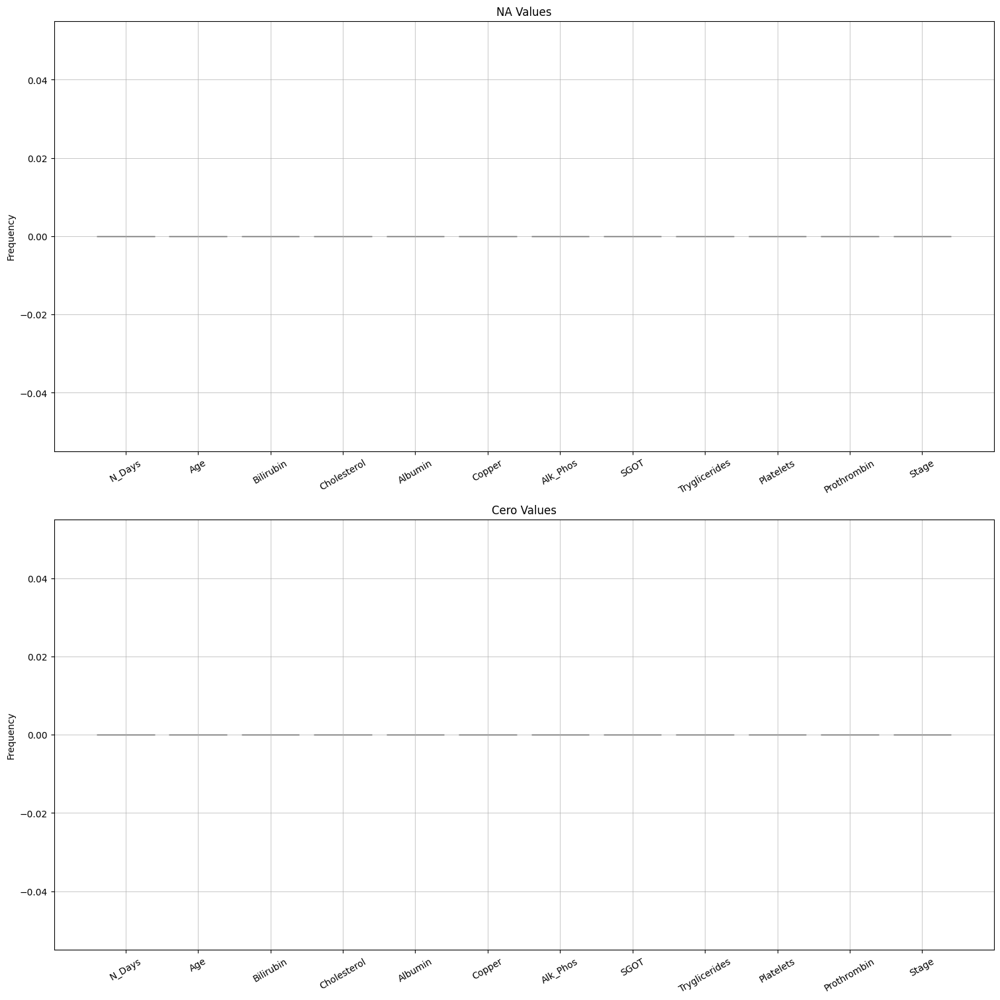

In [17]:
fture_num_df_info = train_eda.infonum

In [18]:
fture_num_df_info.head(12)

,N_Days,Age,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin,Stage
COUNT,7905.00,7905.00,7905.00,7905.00,7905.00,7905.0,7905.00,7905.00,7905.00,7905.00,7905.00,7905.00
MIN,41.00,9598.00,0.30,120.00,1.96,4.0,289.00,26.35,33.00,62.00,9.00,1.00
25%,1230.00,15574.00,0.70,248.00,3.35,39.0,834.00,75.95,84.00,211.00,10.00,2.00
50%,1831.00,18713.00,1.10,298.00,3.58,63.0,1181.00,108.50,104.00,265.00,10.60,3.00
75%,2689.00,20684.00,3.00,390.00,3.77,102.0,1857.00,137.95,139.00,316.00,11.00,4.00
MAX,4795.00,28650.00,28.00,1775.00,4.64,588.0,13862.40,457.25,598.00,563.00,18.00,4.00
MEAN,2030.17,18373.15,2.59,350.56,3.55,83.9,1816.75,114.60,115.34,265.23,10.63,3.03
STD,1094.23,3679.96,3.81,195.38,0.35,75.9,1903.75,48.79,52.53,87.47,0.78,0.87
NA,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00
NA %,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00


In [19]:
# Viloin plots
"""train_eda.plot_violin(                     
                                kde_feature = train_eda.num_cols,
                                diving_feature = "Status",
                                color_feature = "Edema",
                                cmap = 0
                        )"""

'train_eda.plot_violin(                     \n                                kde_feature = train_eda.num_cols,\n                                diving_feature = "Status",\n                                color_feature = "Edema",\n                                cmap = 0\n                        )'

*Preliminary label encoding of target feature for plotting*

In [20]:
train_eda.data["target_num"]  = train_eda.data['Status'].map({'C':0,'D':1,'CL':2})
train_eda_ = Eda(train_eda.data)
train_eda = Eda(data= train_eda.data.drop(columns = 'target_num'))

### Is the multiclass clasification problem linearly separable? -- First pair sample approach

In [21]:
#sns.pairplot(train_eda_.num_data, hue='target_num', height=3, corner=True)

### Scatter plots showing posible outliers using the RIC (*rango intercuartílico*) method:

RIC = Q3 - Q1 

Límite superior = Q3 + (umbral *RIC)

Límite inferior = Q3 - (umbral *RIC)

In [22]:
"""train_eda_.plot_scatter(
                            fig_x_size = 17, 
                            fig_cols = 2,
                            linewidth =  1,  
                            layout = 'constrained' , 
                            x =  train_eda.num_cols, 
                            y = train_eda.num_cols,  
                            size = None, 
                            hue = "target_num", 
                            color = 1, 
                            plotting_lib = 'seaborn', 
                            umbral = 10, 
                            show_outliers = True, 
                            method = "RIC",
                            opacity = 1,
                            plotly_colorscale = 22, 
                            plotly_bgcolor = "white",
                            save_figure = False,
                            name_figure = ""                           
                        )"""

'train_eda_.plot_scatter(\n                            fig_x_size = 17, \n                            fig_cols = 2,\n                            linewidth =  1,  \n                            layout = \'constrained\' , \n                            x =  train_eda.num_cols, \n                            y = train_eda.num_cols,  \n                            size = None, \n                            hue = "target_num", \n                            color = 1, \n                            plotting_lib = \'seaborn\', \n                            umbral = 10, \n                            show_outliers = True, \n                            method = "RIC",\n                            opacity = 1,\n                            plotly_colorscale = 22, \n                            plotly_bgcolor = "white",\n                            save_figure = False,\n                            name_figure = ""                           \n                        )'

### Correlation Matrix calculating the pearson coefficient between each pair of numerical features

In [23]:
"""train_eda_.plot_corr_heatmap(
                                fig_x_size = 10, 
                                fig_y_size = 8, 
                                layout = 'constrained' , 
                                linewidth = 0.5, 
                                cmap = 'coolwarm', # 'Set1', 'Set2', 'Set3', 'Paired','Accent', 'Prism', 'Dark2','Paired', 'coolwarm', 'viridis', 'cubehelix'
                                annot = True, # If True, plot el valor numerico de corrrelacion (entre variables) en la celda del mapa de calor
                                fmt = '.2f' # Especificacion del formato numerico
                                
                                )"""

"train_eda_.plot_corr_heatmap(\n                                fig_x_size = 10, \n                                fig_y_size = 8, \n                                layout = 'constrained' , \n                                linewidth = 0.5, \n                                cmap = 'coolwarm', # 'Set1', 'Set2', 'Set3', 'Paired','Accent', 'Prism', 'Dark2','Paired', 'coolwarm', 'viridis', 'cubehelix'\n                                annot = True, # If True, plot el valor numerico de corrrelacion (entre variables) en la celda del mapa de calor\n                                fmt = '.2f' # Especificacion del formato numerico\n                                \n                                )"

### Bar plots

In [24]:
"""train_eda.plot_bar(
                                    layout = 'constrained',
                                    rotation = 10 ,
                                    fig_x_size = 12,
                                    fig_y_size = 5,
                                    fig_rows = 1,
                                    fig_cols = 2,
                                    plot_limit_categories = 10    
                                )"""

"train_eda.plot_bar(\n                                    layout = 'constrained',\n                                    rotation = 10 ,\n                                    fig_x_size = 12,\n                                    fig_y_size = 5,\n                                    fig_rows = 1,\n                                    fig_cols = 2,\n                                    plot_limit_categories = 10    \n                                )"

### Combined bar plots

id provando con varias variables categoricas 

In [25]:
"""train_eda_.plot_combined_bar(
                                layout = 'constrained',
                                fig_x_size = 10,
                                fig_cols = 2,
                                value_feature = str(train_eda.num_cols[2]),
                                target_feature =  'Status',
                                max_categories = 10,
                                divide_feature = None,
                                errorbar = None,
                                estimator = np.mean,
                                orient = 'v',
                                color = 0,
                                verbose = 0,
                                )"""

"train_eda_.plot_combined_bar(\n                                layout = 'constrained',\n                                fig_x_size = 10,\n                                fig_cols = 2,\n                                value_feature = str(train_eda.num_cols[2]),\n                                target_feature =  'Status',\n                                max_categories = 10,\n                                divide_feature = None,\n                                errorbar = None,\n                                estimator = np.mean,\n                                orient = 'v',\n                                color = 0,\n                                verbose = 0,\n                                )"

In [26]:
"""for _,col in enumerate(train_eda.num_cols):
    train_eda_.plot_combined_bar(
                                    layout = 'constrained',
                                    fig_x_size = 10,
                                    fig_cols = 2,
                                    value_feature = str(col),
                                    target_feature =  'Status',
                                    max_categories = 10,
                                    divide_feature = None,
                                    errorbar = 'sd',
                                    estimator = np.mean,
                                    orient = 'v',
                                    color = 3,
                                    verbose = 0,
                                    )"""

"for _,col in enumerate(train_eda.num_cols):\n    train_eda_.plot_combined_bar(\n                                    layout = 'constrained',\n                                    fig_x_size = 10,\n                                    fig_cols = 2,\n                                    value_feature = str(col),\n                                    target_feature =  'Status',\n                                    max_categories = 10,\n                                    divide_feature = None,\n                                    errorbar = 'sd',\n                                    estimator = np.mean,\n                                    orient = 'v',\n                                    color = 3,\n                                    verbose = 0,\n                                    )"

In [27]:
"""for _,col in enumerate( train_eda.cat_cols):
    train_eda_.plot_combined_bar(
                                    layout = 'constrained',
                                    fig_x_size = 10,
                                    fig_cols = 3,
                                    value_feature = str(train_eda.num_cols[2]),
                                    target_feature =  col,
                                    max_categories = 10,
                                    divide_feature = None,
                                    errorbar = None,
                                    estimator = np.mean,
                                    orient = 'v',
                                    color = 5,
                                    verbose = 0,
                                    )"""

"for _,col in enumerate( train_eda.cat_cols):\n    train_eda_.plot_combined_bar(\n                                    layout = 'constrained',\n                                    fig_x_size = 10,\n                                    fig_cols = 3,\n                                    value_feature = str(train_eda.num_cols[2]),\n                                    target_feature =  col,\n                                    max_categories = 10,\n                                    divide_feature = None,\n                                    errorbar = None,\n                                    estimator = np.mean,\n                                    orient = 'v',\n                                    color = 5,\n                                    verbose = 0,\n                                    )"

### Histograms and kde plots

In [28]:
"""train_eda.plot_hist(
                        bins = 100 ,
                        divide_feature = None,
                        layout = 'constrained',
                        fig_x_size = 14 ,
                        fig_y_size = 8,
                        fig_rows = 1 ,
                        fig_cols = 2 ,
                        linewidth = 0.5 ,
                        density = True,
                        stacked = True
                      )"""

"train_eda.plot_hist(\n                        bins = 100 ,\n                        divide_feature = None,\n                        layout = 'constrained',\n                        fig_x_size = 14 ,\n                        fig_y_size = 8,\n                        fig_rows = 1 ,\n                        fig_cols = 2 ,\n                        linewidth = 0.5 ,\n                        density = True,\n                        stacked = True\n                      )"

### Histograms subdividing by target feature

In [29]:
"""train_eda.plot_hist(
                        bins = 100 ,
                        divide_feature = 'Status',
                        layout = 'constrained',
                        fig_x_size = 14 ,
                        fig_y_size = 8,
                        fig_rows = 1 ,
                        fig_cols = 2 ,
                        linewidth = 0.5 ,
                        density = True,
                        stacked = True
                      )"""

"train_eda.plot_hist(\n                        bins = 100 ,\n                        divide_feature = 'Status',\n                        layout = 'constrained',\n                        fig_x_size = 14 ,\n                        fig_y_size = 8,\n                        fig_rows = 1 ,\n                        fig_cols = 2 ,\n                        linewidth = 0.5 ,\n                        density = True,\n                        stacked = True\n                      )"

### Box plots

In [30]:
"""train_eda.plot_boxplot (                              
                            fig_x_size =  12, # Tamaño de cada figura en x
                            fig_y_size = 12, # Numero de columnas del grid de figura
                            linewidth = 0.5,  # El ancho de linea de la figura (el marco de la figura) y de cada axes tambien
                            layout=  None , # Motor de ajuste de los ejes para evitar solapamiento
                            color= 4 # index del palette en seaborn_palettes
                        )"""

'train_eda.plot_boxplot (                              \n                            fig_x_size =  12, # Tamaño de cada figura en x\n                            fig_y_size = 12, # Numero de columnas del grid de figura\n                            linewidth = 0.5,  # El ancho de linea de la figura (el marco de la figura) y de cada axes tambien\n                            layout=  None , # Motor de ajuste de los ejes para evitar solapamiento\n                            color= 4 # index del palette en seaborn_palettes\n                        )'

## **FEATURE ENGINEERING, TRANSFORMACIÓN Y CODIFICACIÓN**


**En los bloques de código proporcionados a continuación se definen una serie de transformadores personalizados que se utilizan en un pipeline de preprocesamiento de datos**

Estos transformadores se utilizan para realizar diversas operaciones de manipulación y transformación. 

Cada clase transformer realiza, ya sea, la creación de una nueva característica o, la codificación o, la transformacion númerica de los datos que atraviesan el piepline.

Las nuevas features incluidas y una breve descripción de estas se expone a continuaciuón:


1. `DiagnosisDateTransformer`: Calcula la diferencia entre la columna 'Age' y 'N_Days' y la almacena en una nueva columna llamada 'Diagnosis_Date'.
2. `AgeYearsTransformer`: Calcula la edad en años redondeada y la almacena en una nueva columna llamada 'Age_Years'.
3. `AgeGroupsTransformer`: Crea grupos de edad basados en la edad en años y los almacena en una nueva columna llamada 'Age_Group'.
4. `CustomOneHotEncoder`: Codifica las columnas categóricas utilizando el método One-Hot Encoding.
5. `CustomLabelEncoder`: Codifica las columnas categóricas utilizando el método Label Encoding.
6. `BilirubinAlbuminTransformer`: Calcula el producto de 'Bilirubin' y 'Albumin' y lo almacena en una nueva columna llamada 'Bilirubin_Albumin'.
7. `DrugEffectivenessTransformer`: Calcula una medida de la efectividad de la droga multiplicando 'Bilirubin' y 'Drug_Placebo' y lo almacena en una nueva columna llamada 'Drug_Effectiveness'.
8. `SymptomScoreTransformer`: Calcula un puntaje de síntomas sumando las columnas de síntomas 'Ascites', 'Hepatomegaly', 'Spiders' y 'Edema' y lo almacena en una nueva columna llamada 'Symptom_Score'.
9. `SymptomCatTransformer`: Codifica los puntajes de síntomas en una representación de One-Hot Encoding y los agrega al conjunto de datos.
10. `LiverFunctionTransformer`: Calcula el índice de función hepática promediando las columnas 'Bilirubin', 'Albumin', 'Alk_Phos' y 'SGOT' y lo almacena en una nueva columna llamada 'Liver_Function_Index'.
11. `RiskScoreTransformer`: Calcula un puntaje de riesgo restando 'Alk_Phos' de 'Bilirubin' y 'Albumin' y lo almacena en una nueva columna llamada 'Risk_Score'.
12. `TimeFeaturesTransformer`: Calcula características de tiempo adicionales 'Diag_Year' y 'Diag_Month' a partir de la columna 'N_Days'.
13. `ScalingTransformer`: Escala las características numéricas (estandarización) utilizando el StandardScaler de `scikit-learn`. **AUNQUE NO SE USA EN EL PIPELINE ESTE TRANSFORMADOR PORQUE GENERARÍA DATALEAKAGE SI SE TRANSFORMASE EL DATASET ANTES DE SER SPLITEADO EN TRAIN Y TEST, DADO QUE EL CONJUNTO DE TRAIN SE ESTANDARIZARÍA CON DATOS DE TEST. ESTA TRANSFORMACIÓN SE APLICA DESPUES, ENTRENANDO UN StandardScaler SOLO EN EL CONJUNTO DE TRAIN Y TRANSFORMANDO AMBOS CONJUNTOS DE TRAIN Y TEST CON ESTE OBJETO ENTRENADO.**

- Notas:
    - *El resto de transformaciones al ser calculos a nivel instancia, no presentan peligro de dataleakage, es decir, cada nueva a característica creada o codificada se calcula con información unicamente de su propia muestra y no de otras muestras*
    - *No es necesario incluir un transformador tipo imputer de valores faltantes para este problema porque no hay datos de esta naturaleza, sin embargo, si los hubiese, debería incluirse en esta parte del codigo*


El pipeline se define para aplicar estos transformadores en secuencia a los datos de entrada. Cada transformador realiza una operación específica en los datos y produce un nuevo conjunto de datos transformado. Este pipeline forma parte del preprocesamineto y se incluirá como parte del pipeline final.

In [31]:
LABEL = "Status"
CAT_FEATS = ["Drug", "Sex", "Ascites", "Hepatomegaly", "Spiders", "Edema", "Stage"]
NUM_FEATS = [x for x in train_eda.data.columns if x not in CAT_FEATS and x != LABEL]

In [32]:
# Variables categoricas/nominales
train_eda.data[CAT_FEATS]

,Drug,Sex,Ascites,Hepatomegaly,Spiders,Edema,Stage
0,D-penicillamine,M,N,N,N,N,3.0
1,Placebo,F,N,N,N,N,3.0
2,Placebo,F,N,Y,Y,Y,4.0
3,Placebo,F,N,N,N,N,3.0
4,Placebo,F,N,Y,N,N,4.0
...,...,...,...,...,...,...,...
7900,D-penicillamine,F,N,N,N,N,2.0
7901,Placebo,F,N,Y,N,N,4.0
7902,D-penicillamine,F,N,N,Y,S,2.0
7903,D-penicillamine,M,N,Y,N,N,4.0


In [33]:
# Variables numericas
train_eda.data[NUM_FEATS]

,N_Days,Age,Bilirubin,Cholesterol,Albumin,Copper,Alk_Phos,SGOT,Tryglicerides,Platelets,Prothrombin
0,999,21532,2.3,316.0,3.35,172.0,1601.0,179.80,63.0,394.0,9.7
1,2574,19237,0.9,364.0,3.54,63.0,1440.0,134.85,88.0,361.0,11.0
2,3428,13727,3.3,299.0,3.55,131.0,1029.0,119.35,50.0,199.0,11.7
3,2576,18460,0.6,256.0,3.50,58.0,1653.0,71.30,96.0,269.0,10.7
4,788,16658,1.1,346.0,3.65,63.0,1181.0,125.55,96.0,298.0,10.6
...,...,...,...,...,...,...,...,...,...,...,...
7900,1166,16839,0.8,309.0,3.56,38.0,1629.0,79.05,224.0,344.0,9.9
7901,1492,17031,0.9,260.0,3.43,62.0,1440.0,142.00,78.0,277.0,10.0
7902,1576,25873,2.0,225.0,3.19,51.0,933.0,69.75,62.0,200.0,12.7
7903,3584,22960,0.7,248.0,2.75,32.0,1003.0,57.35,118.0,221.0,10.6


In [34]:
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import OneHotEncoder,LabelEncoder
from sklearn.base import BaseEstimator , TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

class DiagnosisDateTransformer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X_encoded = X.copy()
        X_encoded['Diagnosis_Date'] = X_encoded['Age'] - X_encoded['N_Days']
        return X_encoded

class AgeYearsTransformer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X_encoded = X.copy()
        X_encoded['Age_Years'] = round(X_encoded['Age'] / 365.25).astype("int16")
        return X_encoded

class AgeGroupsTransformer(BaseEstimator, TransformerMixin):
    """Older people might be hit harder (interaction) by health issues. Also can cover lifestyle influences, i.e.
    alcohol consumption etc."""
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X_encoded = X.copy()
        # Use years from above, min=26, max=78
        X_encoded['Age_Group'] = pd.cut(X_encoded['Age_Years'], bins=[19, 29, 49, 64, 99], labels = [0, 1, 2, 3]).astype('int16')
        return X_encoded
    
class CustomOneHotEncoder(BaseEstimator, TransformerMixin):
    def __init__(self,columns):
        self.columns = columns
        self.encoder = OneHotEncoder(drop = 'if_binary', sparse_output=False)
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X_encoded = X.copy()
        X_encoded[self.encoder.get_feature_names_out(input_features=self.columns)] = self.encoder.fit_transform(X[self.columns])
        X_encoded =  X_encoded.drop(columns = self.columns, axis = 1)
        return X_encoded


class CustomLabelEncoder(BaseEstimator, TransformerMixin):
    def __init__(self,columns):
        self.columns = columns
        self.encoder = LabelEncoder()
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X_encoded = X.copy()
        for col in self.columns:
            X_encoded[col] = self.encoder.fit_transform(X[col]).reshape(-1,1)
        return X_encoded
    
class BilirubinAlbuminTransformer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X['Bilirubin_Albumin'] = X['Bilirubin'] * X['Albumin']
        return X

class DrugEffectivenessTransformer(BaseEstimator, TransformerMixin):
    # Placeholder concept, assuming 'Bilirubin' improvement is a measure of effectiveness
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X['Drug_Effectiveness'] = X['Drug_Placebo'] * X['Bilirubin']
        return X

class SymptomScoreTransformer(BaseEstimator, TransformerMixin):
    # From data set explanations above let's add all the "bad" symptoms
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        # symptom_columns = ['Ascites', 'Hepatomegaly', 'Spiders', 'Edema']
        symptom_columns = ['Ascites', 'Hepatomegaly', 'Spiders', 'Edema_N', 'Edema_S', 'Edema_Y']
        X['Symptom_Score'] = X[symptom_columns].sum(axis=1)
        return X
    
class SymptomCatTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.symptom_columns = ['Ascites', 'Hepatomegaly', 'Spiders', 'Edema_N', 'Edema_S', 'Edema_Y']
        self.encoder = OneHotEncoder(handle_unknown='ignore')

    def fit(self, X, y=None):
        X_copy = X.copy()
        symptom_scores = X_copy[self.symptom_columns].apply(lambda row: ''.join(row.values.astype(str)), axis=1)
        self.encoder.fit(symptom_scores.values.reshape(-1, 1))
        return self

    def transform(self, X):
        X_transformed = X.copy()
        symptom_scores = X_transformed[self.symptom_columns].apply(lambda row: ''.join(row.values.astype(str)), axis=1)
        encoded_features = self.encoder.transform(symptom_scores.values.reshape(-1, 1)).toarray().astype("int8")
        encoded_feature_names = self.encoder.get_feature_names_out(input_features=['Symptom_Score'])
        # Drop the original symptom columns and add the new encoded features
        # X_transformed.drop(columns=self.symptom_columns, inplace=True)
        X_transformed[encoded_feature_names] = pd.DataFrame(encoded_features, index=X_transformed.index)
        
        return X_transformed


class LiverFunctionTransformer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        liver_columns = ['Bilirubin', 'Albumin', 'Alk_Phos', 'SGOT']
        X['Liver_Function_Index'] = X[liver_columns].mean(axis=1)
        return X

class RiskScoreTransformer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X['Risk_Score'] = X['Bilirubin'] + X['Albumin'] - X['Alk_Phos']
        return X

class TimeFeaturesTransformer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X['Diag_Year'] = (X['N_Days'] / 365).astype(int)
        X['Diag_Month'] = ((X['N_Days'] % 365) / 30).astype(int)
        return X
    
class ScalingTransformer(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.scaler = StandardScaler()
        """self.num_feats = NUM_FEATS + ['Diagnosis_Date', 'Age_Years', 'Bilirubin_Albumin', 'Drug_Effectiveness', 
                                      'Symptom_Score', 'Liver_Function_Index', 'Risk_Score', 'Diag_Year', 'Diag_Month']"""
        self.num_feats = NUM_FEATS + ['Diagnosis_Date', 'Age_Years', 'Bilirubin_Albumin', 'Drug_Effectiveness', 
                                       'Liver_Function_Index', 'Risk_Score']

    def fit(self, X, y=None):
        self.scaler.fit(X[self.num_feats])
        return self

    def transform(self, X):
        X_scaled = X.copy()
        X_scaled[self.num_feats] = self.scaler.transform(X_scaled[self.num_feats])
        return X_scaled

# Define the pipeline
pipeline = Pipeline([
    ('encoder one hot ', CustomOneHotEncoder(columns = train_eda_.cat_data.drop(columns = ['Status','Edema']).columns.to_list())),
    ('encoder label ', CustomLabelEncoder(columns = ['Status','Edema'])),
    ('diagnosis_date', DiagnosisDateTransformer()),
    ('age_years', AgeYearsTransformer()),
    ('age_groups', AgeGroupsTransformer()),
    ('bilirubin_albumin', BilirubinAlbuminTransformer()),
    ('drug_effectiveness', DrugEffectivenessTransformer()),
    ('liver_function', LiverFunctionTransformer()),
    ('risk_score', RiskScoreTransformer()),
    ('time_features', TimeFeaturesTransformer()),
    #('scaling', ScalingTransformer()),
])

# Update the CAT_FEATS
CAT_FEATS = ['Drug', 'Sex', 'Ascites', 'Hepatomegaly', 'Spiders', 'Edema', 'Stage', #old
             'Age_Group', 'Symptom_Score'] # new 
# Update the NUM_FEATS ????

In [35]:
# Entrenamiento del pipeline y transformacion de los datos
train_pipelined = pipeline.fit_transform(train_eda.data)
train_eda_pipelined = Eda(data =train_pipelined)

In [36]:
# Comprobacion de las nuevas columnas creadas
train_eda_pipelined.data.columns

Index(['N_Days', 'Age', 'Edema', 'Bilirubin', 'Cholesterol', 'Albumin',
       'Copper', 'Alk_Phos', 'SGOT', 'Tryglicerides', 'Platelets',
       'Prothrombin', 'Stage', 'Status', 'Drug_Placebo', 'Sex_M', 'Ascites_Y',
       'Hepatomegaly_Y', 'Spiders_Y', 'Diagnosis_Date', 'Age_Years',
       'Age_Group', 'Bilirubin_Albumin', 'Drug_Effectiveness',
       'Liver_Function_Index', 'Risk_Score', 'Diag_Year', 'Diag_Month'],
      dtype='object')

In [37]:
# Aseguramos proporciones de las clases de nuevo
print("New codify classes : ", np.unique(train_eda_pipelined.data['Status']))
print(f"Frecuencia de clases : {np.bincount(train_eda_pipelined.data['Status'])}")
for idx, v in enumerate(np.bincount(train_eda_pipelined.data['Status'])):
    print(f"Proporción de la clase {idx} : {100*v/train_eda_pipelined.data['Status'].shape[0]:.3f}", '%')

New codify classes :  [0 1 2]
Frecuencia de clases : [4965  275 2665]
Proporción de la clase 0 : 62.808 %
Proporción de la clase 1 : 3.479 %
Proporción de la clase 2 : 33.713 %


### **DROP de la caracteristicas que se han usado en feature engineering**

**Ahora, mediante la matriz de correlación y tras la creación de nuevas características, se van a dropear las columnas o características que tengan alta correlación entre sí. Este alto valor del coeficiente de Pearson indica que ambas características están positivamente o negativamente correlacionadas (linealmente hablando) y no aportan información extra en la predicción. Se puede prescindir de alguna de las dos.**

*Primero se calcula la matriz de correlación y se plotea para cerciorarse de estas características linealmente relacionadas y luego se dropean.*
*Luego, con el dataframe "limpio", se vuelve a plotear dicha matriz de correlación en forma de heatmap para su comprobación.*

**Esto tiene lógica debido a que hemos realizado ingeniería de características; hemos generado nuevas características (que intuíamos más potentes para la predicción) a partir de características ya existentes; y para no aumentar sin motivo la dimensionalidad del problema, se van a eliminar.**

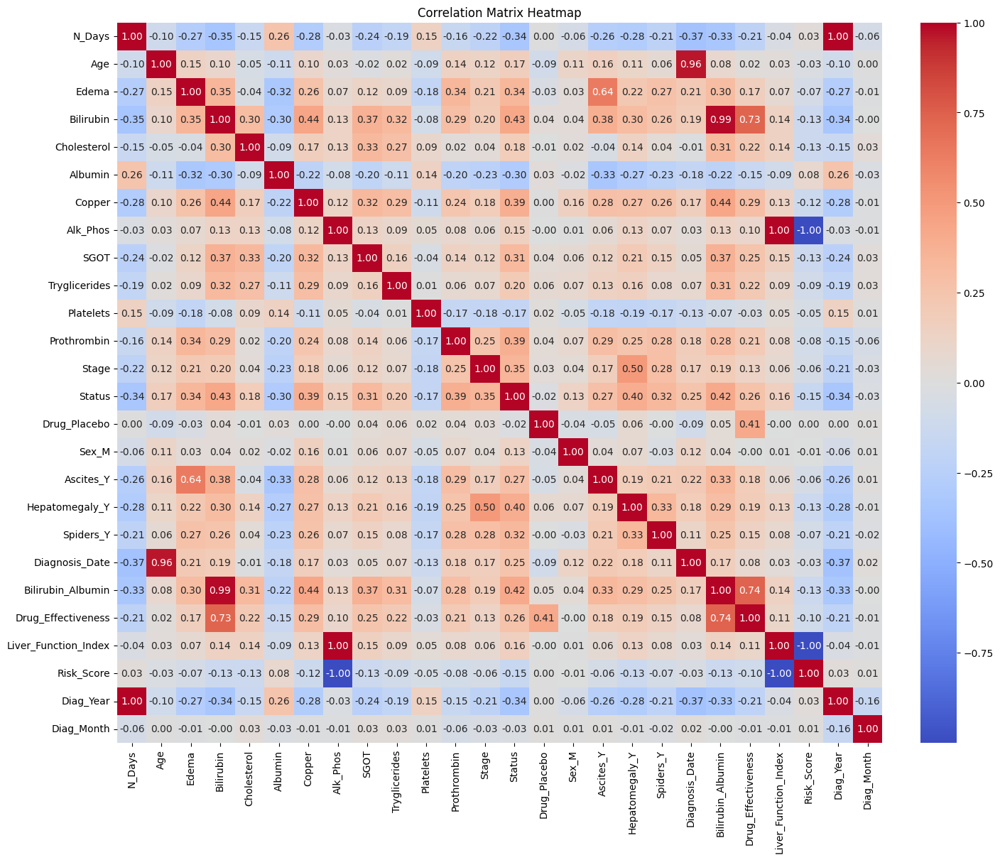

In [38]:
train_eda_pipelined.plot_corr_heatmap(
                                fig_x_size = 14, 
                                fig_y_size = 12, 
                                layout = 'constrained' , 
                                linewidth = 0.5, 
                                cmap = 'coolwarm', # 'Set1', 'Set2', 'Set3', 'Paired','Accent', 'Prism', 'Dark2','Paired', 'coolwarm', 'viridis', 'cubehelix'
                                annot = True, # If True, plot el valor numerico de corrrelacion (entre variables) en la celda del mapa de calor
                                fmt = '.2f' # Especificacion del formato numerico
                                
                                )

In [39]:
# Columnas correlacionadas a dropear:
DROP_COLS = ['Age','N_Days','Bilirubin','Albumin','Drug_Placebo','Bilirubin','Alk_Phos']
train_eda_pipelined_dropped = Eda(data = train_eda_pipelined.data.drop(columns = DROP_COLS))
train_eda_pipelined_dropped.data.columns

Index(['Edema', 'Cholesterol', 'Copper', 'SGOT', 'Tryglicerides', 'Platelets',
       'Prothrombin', 'Stage', 'Status', 'Sex_M', 'Ascites_Y',
       'Hepatomegaly_Y', 'Spiders_Y', 'Diagnosis_Date', 'Age_Years',
       'Age_Group', 'Bilirubin_Albumin', 'Drug_Effectiveness',
       'Liver_Function_Index', 'Risk_Score', 'Diag_Year', 'Diag_Month'],
      dtype='object')

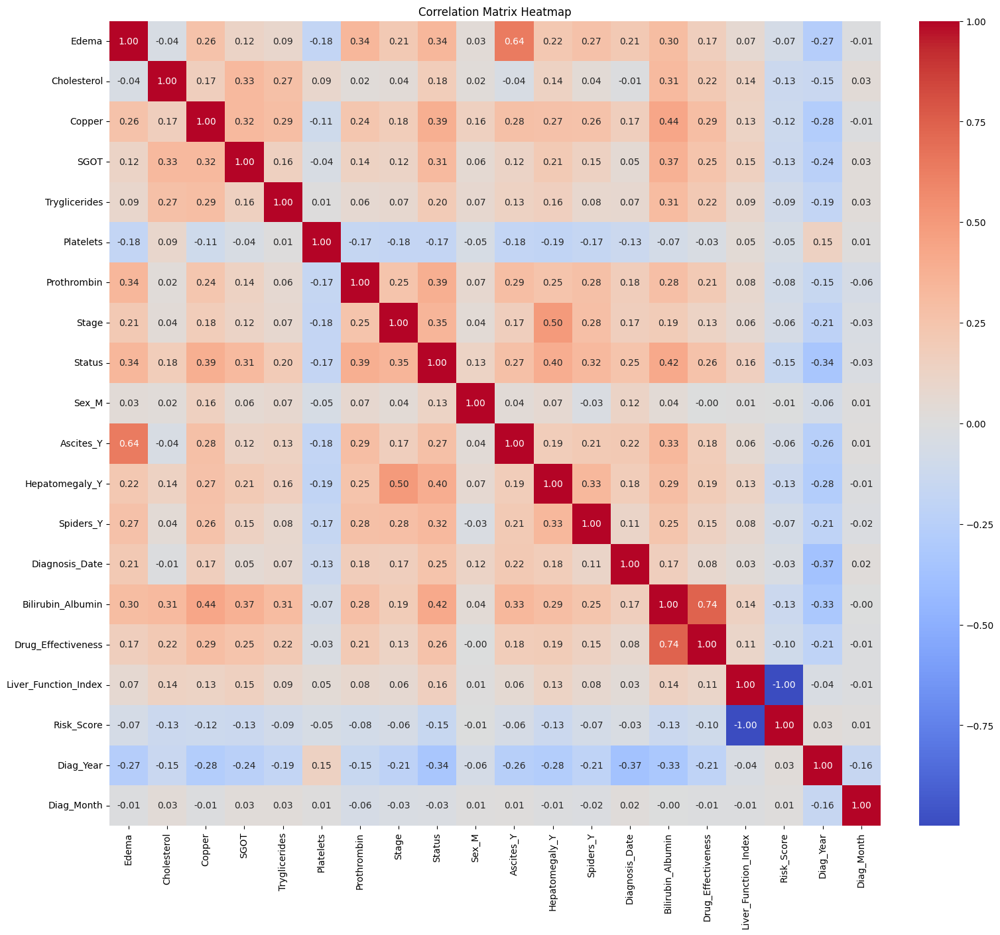

In [40]:
train_eda_pipelined_dropped.plot_corr_heatmap(
                                fig_x_size = 15, 
                                fig_y_size = 14, 
                                layout = 'constrained' , 
                                linewidth = 0.5, 
                                cmap = 'coolwarm', # 'Set1', 'Set2', 'Set3', 'Paired','Accent', 'Prism', 'Dark2','Paired', 'coolwarm', 'viridis', 'cubehelix'
                                annot = True, # If True, plot el valor numerico de corrrelacion (entre variables) en la celda del mapa de calor
                                fmt = '.2f' # Especificacion del formato numerico
                                
                                )

In [41]:
# Aseguramos proporciones de las clases de nuevo
print("New codify classes : ", np.unique(train_eda_pipelined_dropped.data['Status']))
print(f"Frecuencia de clases : {np.bincount(train_eda_pipelined_dropped.data['Status'])}")
for idx, v in enumerate(np.bincount(train_eda_pipelined_dropped.data['Status'])):
    print(f"Proporción de la clase {idx} : {100*v/train_eda_pipelined_dropped.data['Status'].shape[0]:.3f}", '%')

New codify classes :  [0 1 2]
Frecuencia de clases : [4965  275 2665]
Proporción de la clase 0 : 62.808 %
Proporción de la clase 1 : 3.479 %
Proporción de la clase 2 : 33.713 %


## **Separación de la variable objetivo y Split estratificado en Train y Test**


**Como la procedencia del data set es de una competición, no se tiene la target feature en el conjunto de test, por ello, del conjunto de train se van a crear dos subconjuntos de train y test para validar la performance de regularización, el sobreajuste y el sesgo del modelo, entre otras características relevantes.**

In [42]:
# Separación en target y prediction features
X = train_eda_pipelined_dropped.data.drop(columns = 'Status')
y = train_eda_pipelined_dropped.data['Status']

# Características despues del preprocesamiento
FEAT_AFTER_PIPE = X.columns.to_list()

In [43]:
FEAT_AFTER_PIPE

['Edema',
 'Cholesterol',
 'Copper',
 'SGOT',
 'Tryglicerides',
 'Platelets',
 'Prothrombin',
 'Stage',
 'Sex_M',
 'Ascites_Y',
 'Hepatomegaly_Y',
 'Spiders_Y',
 'Diagnosis_Date',
 'Age_Years',
 'Age_Group',
 'Bilirubin_Albumin',
 'Drug_Effectiveness',
 'Liver_Function_Index',
 'Risk_Score',
 'Diag_Year',
 'Diag_Month']

In [44]:
X.head()

,Edema,Cholesterol,Copper,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Sex_M,Ascites_Y,Hepatomegaly_Y,Spiders_Y,Diagnosis_Date,Age_Years,Age_Group,Bilirubin_Albumin,Drug_Effectiveness,Liver_Function_Index,Risk_Score,Diag_Year,Diag_Month
0,0,316.0,172.0,179.80,63.0,394.0,9.7,3.0,1.0,0.0,0.0,0.0,20533,59,2,7.705,0.0,446.6125,-1595.35,2,8
1,0,364.0,63.0,134.85,88.0,361.0,11.0,3.0,0.0,0.0,0.0,0.0,16663,53,2,3.186,0.9,394.8225,-1435.56,7,0
2,2,299.0,131.0,119.35,50.0,199.0,11.7,4.0,0.0,0.0,1.0,1.0,10299,38,1,11.715,3.3,288.8000,-1022.15,9,4
3,0,256.0,58.0,71.30,96.0,269.0,10.7,3.0,0.0,0.0,0.0,0.0,15884,51,2,2.100,0.6,432.1000,-1648.90,7,0
4,0,346.0,63.0,125.55,96.0,298.0,10.6,4.0,0.0,0.0,1.0,0.0,15870,46,1,4.015,1.1,327.8250,-1176.25,2,1


In [45]:
y.head()

0    2
1    0
2    2
3    0
4    0
Name: Status, dtype: int32

In [46]:
# Split (sub) test y (sub) train
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X.values,y.values,test_size=0.3, random_state=42, shuffle=True, stratify = y )

print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(5533, 21) (5533,) (2372, 21) (2372,)


In [47]:
# Aseguramos proporciones de las clases de nuevo en test y train
print("Train target classes : ", np.unique(y_train))
print(f"Frecuencia de clases : {np.bincount(y_train)}")
for idx, v in enumerate(np.bincount(y_train)):
    print(f'Proporción de la clase {idx} : {100*v/y_train.shape[0] : .3f}','%')

Train target classes :  [0 1 2]
Frecuencia de clases : [3475  193 1865]
Proporción de la clase 0 :  62.805 %
Proporción de la clase 1 :  3.488 %
Proporción de la clase 2 :  33.707 %


In [48]:
# Aseguramos proporciones de las clases de nuevo
print("Test target classes : ", np.unique(y_test))
print(f"Frecuencia de clases : {np.bincount(y_test)}")
for idx, v in enumerate(np.bincount(y_test)):
    print(f'Proporción de la clase {idx} : {100*v/y_test.shape[0] : .3f}','%')

Test target classes :  [0 1 2]
Frecuencia de clases : [1490   82  800]
Proporción de la clase 0 :  62.816 %
Proporción de la clase 1 :  3.457 %
Proporción de la clase 2 :  33.727 %


## **TRATAMIENTO DE CLASES DESBALANCEADAS**

### **Siguientes pasos dados para abordar este problema:**

1. Primero y tras el Eda del dataset original, se ha creado un pipeline transformador (aunque no se ha aplicado ninguna estandarización, aún, porque generaría dataleakage si se aplicase antes del split en train y test), generador y codificador. Este pipeline basicamente realiza la codificación de las variables categóricas y la variable objetivo y genera (segun criterio propio) variables o características sintéticas mediante feature engineering. Ha sido necesaria la codificación de las variables nominales (categóricas) para la aplicación posterior de algoritmos de sobremuestreo sintéticos de la clase minoritaria (dado que, estos no soportan variables de esta naturaleza o, si lo hacen, aplican internamente una codificación no controlada por nostros). 

2. Una vez se cuenta con el dataset transformado y codificado, se ha llevado acabo la separación estratificada (esto es, manteniendo la proporción de las clases a prededcir en ambos subconjuntos) en train y test. 

3. En este punto y **solo sobre el conjunto de train** se van a aplicar:
   - Diferentes técnicas de resample.
   - Diferentes algoritmos de clasificación multiclase.
   - Diferentes técnicas de cross validation.
   - Diferentes métricas de evaluación de performance de estos algoritmos tanto en el conjunto de train sobremuestreado como en el conjunto de test (este último no está sobremuestreado con el objetivo de ver la capacidad de generalización de los algoritmos con la proporción de clases desbalanceadas originales).
   
3. Una vez se ha hecho este estudio, se elige la técnica de resample que mejores métricas ha propiciado y que ha logrado la mejor solución de compromiso entre sobreajuste y sesgo, que es la que se va a aplicar sobre el conjunto de **train** finalmente.

Nota: Cabe destacar que para no generar unas métricas excesivamente elevadas en el train set sobremuestreado comparado con el test set no sobremuestreado, el aumento de muestras de la clase minoritaria no será muy drástico. [Se espera pasar de un 3% a un 11% mas o menos en la proporción de la clase minoritaria]


*Antes de nada se estandarizan las variables del conjunto de X_train (que tienen muy variadas escalas), debido a que los algoritmos de remuestreo sintéticos y no sintéticos, que trabajen con distancias entre datapoints, se pueden ver afectados.*

*Pero también (y, por separado para evitar dataleakage) se estandariza el conjunto de test.*

In [49]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
X_train_std = std.fit_transform(X_train)
X_test_std = std.transform(X_test)

In [50]:
# Función propia que realiza la técnica de muestreo especificada
from Paquetes.imbalanced import synthetic_resample

## **Exposición de las técnicas de remuestreo sintético a utilizar, consideraciones útiles e intuición sobre cuál puede ser la óptima para el problema en cuestión.**

### 1.  **SMOTE (Synthetic Minority Over-sampling Technique)**:

   SMOTE es la técnica "padre" y consiste en un enfoque de sobremuestreo en el cual el número de muestras o datapoints de la clase minoritaria se aumentan mediante la creación de ejemplos "sintéticos" en lugar de hacerlo, por ejemplo, mediante un sobremuestreo con reemplazo.

   Este enfoque, según sus creadores Chawla, N.V., Bowyer, K.W., Hall, L.O., & Kegelmeyer, W.P. en **SMOTE: Synthetic Minority Over-sampling Technique**, se inspira en una técnica exitosa en el reconocimiento de caracteres manuscritos (Ha & Bunke, 1997). En dicha técnica se generaban datos de entrenamiento adicionales realizando ciertas operaciones en datos reales, como rotación y deformación, lo cual perturbaba los datos de entrenamiento.

   En SMOTE, se generan ejemplos sintéticos de una manera menos específica de aplicación, operando en el "espacio de características" en lugar del "espacio de datos". La clase minoritaria se sobremuestrea tomando cada muestra de la clase minoritaria e introduciendo ejemplos sintéticos a lo largo de los segmentos de línea que unen cualquier/todos los k vecinos más cercanos de la clase minoritaria, es decir, interpolando.

   Dependiendo de la cantidad de sobremuestreo requerida, se eligen aleatoriamente un número de vecinos dentro de los k vecinos más cercanos determinados y elegido este número como hiperparámetro del algoritmo. En la función propia creada **synthetic_resample** dentro del módulo propio **imbalanced.py** (y, como en el paper original), el número de k vecinos se fija a 5.

   En este paper los autores recomiendan elegir el número de vecinos dentro de esos k vecinos más "cercanos" (a nivel de relación geométrica entre muestras) usados para la interpolación en función del grado de sobremuestreo de clase que se requiera. Por ejemplo, si se necesita un sobremuestreo del 200%, se eligen solo dos vecinos de los k más cercanos y se genera una muestra en la dirección de cada uno. Esto significa unir el datapoint que se está considerando en esta iteración con los dos vecinos elegidos, interpolar de cierta manera que ahora se detalla y generar dos muestras sintéticas sobre esas rectas entre: datapoint considerado-vecino elegido. Más específicamente, estas muestras sintéticas se generan tomando la diferencia entre el vector de características de la muestra bajo consideración y su vecino más cercano. Luego, esta diferencia se multiplica por un número aleatorio entre 0 y 1, y se agrega a este vector de características de la muestra (datapoint) bajo consideración. Como se ha adelantado antes, esta operación provoca la selección de un punto aleatorio a lo largo del segmento que une vecino elegido y datapoint de la clase minoritaria considerado.

   Según afirman en el paper tras estudios basados en graficar una serie de curvas ROC para diferentes poblaciones y realizar un análisis ROC, las muestras sintéticas causan que clasificadores de tipo árbol creen regiones de decisión más grandes y menos específicas, en lugar de regiones más pequeñas y específicas. Estos aprenden regiones más generales para las muestras de la clase minoritaria en lugar de que estas sean absorbidas por las muestras de la clase mayoritaria que las rodean. Como resultado, los árboles de decisión generalizan mejor.

   **Dicho esto y por el hecho de que en el presente trabajo se va a hacer uso de árboles de decisión como modelos base de metamodelos o de modelos ensamblados, hemos pensado que esta técnica y sus variantes para llevar a cabo el remuestreo y no el sobremuestreo de la clase minoritaria con reemplazo. Además, en el paper, los autores comparan ambas técnicas usando este tipo de algoritmos no paramétricos basados en árboles de decisión y, según demuestran, obtienen mejores resultados de clasificación mediante SMOTE.**

   
   - **Ventajas aportadas**:

     - Ayuda a evitar el sobreajuste al generar muestras sintéticas que están cerca de las instancias originales de la clase minoritaria.
     - Este enfoque fuerza que la región de decisión de la clase minoritaria se vuelva más general.
     - La cantidad de sobremuestreo es un hiperparámetro del algoritmo.
    
  - **Consideraciones**:
  
     - Es un algoritmo que no maneja variables nominales (en su versión original) por ello se ha decidido en el trabajo codificar y ESTANDARIZAR las muestras previamente. Al ser un algoritmo basado en distancias entre muestras este hecho es importante. 
     - Habria que reconsiderar el tipo de codificacion aplicada debido a que una codificacion tipo one hot podria haber generado (dado que hay un número considerable de variables categóricas) la pérdida o variación en la realción gemoétrica entre las muestras.
     - En la implementación de la técnica usando la funcion propia **synthetic_resample** se definen los diferentes hiperparámetros de esta y otras técnicas que se describen a continuación, como el ratio de sobremuestreo. Este es relativo simepre a la clase mayoritaria, tanto en "oversampling" como en "undersampling".

   *Referencia: Chawla, N.V., Bowyer, K.W., Hall, L.O., & Kegelmeyer, W.P. (2002). SMOTE: Synthetic Minority Over-sampling Technique. Journal of Artificial Intelligence Research, 16, 321-357.*

### 2. **ADASYN (Adaptive Synthetic Sampling)**:

   ADASYN es una extensión de SMOTE que ajusta la densidad de muestras sintéticas generadas para adaptarse a la distribución local de la clase minoritaria.
   En concreto según exponen  Haibo He, Yang Bai, Edwardo A. Garcia, and Shutao Li en **ADASYN: Adaptive Synthetic Sampling Approach for Imbalanced Learning**, ADASYN se basa en la idea de generar muestras de datos minoritarios en función de sus distribuciones. Se generan más datos sintéticos para las muestras de clases minoritarias más difíciles de aprender en comparación con las muestras de clases minoritarias más fáciles de aprender. El método ADASYN no sólo puede reducir el sesgo de aprendizaje introducido por la distribución original de datos desequilibrada, sino que también puede también desplazar de forma adaptativa el límite de decisión para centrarse en las muestras difíciles de aprender. 

   El algoritmo ADASYN utiliza la densidad de distribución ˆri para determinar automáticamente el número de muestras sintéticas que se generan para cada ejemplo de datos minoritarios, según su dificultad de aprendizaje. Esto permite obtener un conjunto de datos equilibrado según el coeficiente β definido como hiperparámetro, además de centrar el algoritmo de aprendizaje en los ejemplos difíciles de aprender. 
   
   A diferencia de SMOTE, ADASYN adapta la generación de muestras sintéticas según la dificultad de aprendizaje de cada ejemplo minoritario. Los resultados experimentales en el paper muestran que ADASYN puede mejorar el rendimiento de clasificación al reducir el sesgo introducido en los conjuntos de datos desequilibrados originales a medida que se aumenta el nivel de equilibrio mediante este algoritmo.

   - **Ventajas aportadas**:
   
     - Proporciona una mayor capacidad de adaptación a la distribución local de la clase minoritaria, lo que puede mejorar el rendimiento en conjuntos de datos con distribuciones no uniformes.
     - Reduce el sesgo introducido por la generación de muestras sintéticas al centrarse en regiones donde la clase minoritaria está menos representada.
   

   *Referencia: He, H. & Ma, Y. (2013). Imbalanced Learning with ADASYN. In IEEE International Conference on Systems, Man, and Cybernetics (SMC), 2782-2787.*

### 3. **BorderlineSMOTE**:

En el paper, los autores se centran en los métodos de sobremuestreo sintético con SVM como clasificador base para tratar el problema del desequilibrio de clases. Buscan la generación de nuevas instancias de clase minoritarias en la frontera entre las clases de datos. Esto se debe al hecho de que las instancias fronterizas son las más propensas a ser clasificadas erróneamente y, por tanto, cruciales para clasificar correctamente. Centrar el remuestreo en este área puede ser más beneficioso que en toda la clase minoritaria. 

Una característica destacable de esta técnica es que puede ayudar a ampliar la clase minoritaria en áreas donde la densidad de instancias de la clase mayoritaria no es tan alta. Con este enfoque, las instancias de la clase minoritaria pueden reconocerse incluso en las regiones cercanas al límite en las que no hay ningún representante de ellas en el conjunto de entrenamiento.

El método en sí, generará instancias de la clase minoritaria a lo largo del límite de decisión (marcado por los vectores soporte de dicha clase, calculados mediante SVM), ya que las instancias en esta área son muy críticas para estimar el límite de decisión óptimo. El muestreo en toda la clase minoritaria puede no ser necesario. En el paper han demostrado que se obtiene un mejor rendimiento. 

El enfoque que aporta esta técnica es que la zona límite se aproxima por los vectores de soporte obtenidos tras entrenar un clasificador SVMs estándar en el conjunto de entrenamiento original. 

Después, se crearán aleatoriamente muestras sintéticas a lo largo de las líneas que unen cada vector soporte de la clase minoritaria con un número de sus vecinos más cercanos utilizando la técnica de interpolación (Fig. a) o extrapolación (Fig. b) en función de la densidad de instancias de clase mayoritaria a su alrededor. 

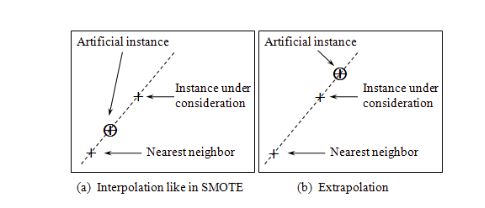

Es decir, BorderlineSMOTE es similar a SMOTE, pero en este algoritmo las muestras de la clase minoritaía (o datapoints) consideradas en cada iteración tienen que pertenecer al conjunto de vectores soporte de esa clase (no cualquier muestra de la clase minoritaría) que previamente se han obtenido mediante SVM.

Para determiar el tipo de interpolación se aplica el siguiente criterio en función de la densidad de instancias de clase mayoritaria alrededor de la instancia/muestra de la clase minoritaria (que en este caso es un vector soporte de esa clase):

Si las instancias de la clase mayoritaria cuentan con menos de la mitad de sus vecinos más cercanos, se crearán nuevas instancias con extrapolación para ampliar el área de la clase minoritaria hacia la mayoritaria. Esta expansión puede lograrse porque la dirección de extrapolación puede ir desde el interior (la instancia vecina) hacia el exterior (la instancia limítrofe considerada/ vector soporte) de del área ocupada por las instancias de la clase minoritaria. En el caso contrario debido a la aglomeración de instancias de la clase mayoritaria, en lugar de de ampliar el área, el área límite actual de la clase minoritaria se consolidará de forma similar a SMOTE. Un punto diferente del método propuesto en comparación con SMOTE es que las nuevas instancias se crearán en el orden del primero al k-ésimo vecino más cercano en lugar de seleccionar aleatoriamente un vecino más cercano. 

Es decir, BorderlineSMOTE es una variante de SMOTE que se enfoca en las instancias en el límite (borde) entre las clases para generar muestras sintéticas y "reforzar" de la clase minoritaria ese subespacio del conjunto de entrenamiento.

   - **Ventajas aportads**:
     - Se centra en las instancias más difíciles de clasificar, lo que puede ayudar a mejorar la generalización del modelo.
     - Puede ser más efectiva en conjuntos de datos con clases superpuestas o con solapamiento entre las clases.

   - **Consideraciones**:

      - **La última ventaja mencionada, según se demuestra posteriormente, es la que intuitivamente nos ha llevado a pensar que de entre todas las técnicas, esta iba a ser la más efectiva. O, al menos, una basada en la utilización de SVM para la generación de muestras sintéticas. Esto es porque, una vez realizado el EDA, en la mayoría de los diagramas de dispersión se observa un gran solapamiento entre clases. A pesar de esto, se van a poner a prueba cada una de estas técnicas para probar esta intuición.**

   *Referencia: Han, H. & Wang, W.Y. (2005). Borderline-SMOTE: A New Over-Sampling Method in Imbalanced Data Sets Learning. In International Conference on Intelligent Computing (ICIC), 878-887.*

### 4. **SVMSMOTE (Support Vector Machine SMOTE)**:

Esta técnica es realmente la definida en el apartado anterior de BorderlineSMOTE. Este método siempre utiliza para determinar las muestras limítrofes una máquina de vector soporte, mientras que BorderlineSMOTE es más general y puede determinar estas muestras limítrofes mediante otras técnicas. En cualquier caso, ambas técnicas son muy similares y lo definido en Borderline es extrapolable para esa técnica.

   - **Ventajas**:
     - Utiliza información adicional proporcionada por el SVM para generar muestras sintéticas que son más útiles para mejorar la separabilidad entre clases.
     - Puede ser más efectiva en conjuntos de datos con estructuras de distribución no lineales o clases solapadas.

   *Referencia: Douzas, G., & Bacao, F. (2018). Using Ensemble of Subset Evaluations for Imbalanced Learning: An Empirical Study. Knowledge-Based Systems, 161, 127-137.*


In [51]:
# Bucle de remuestreo: crear varios conjuntos de datos con diferentes técnicas de remuestreo
techniques = ["SMOTE","ADASYN","BorderlineSMOTE","SVMSMOTE"]
resampled_train_sets = {t: synthetic_resample(X = X_train_std,y  = y_train,ratio = 0.2 ,technique = t, verbose  = 1) for _ , t in enumerate(techniques)}

y input type : int32  | y input shape :  (5533,)
X input type : float64 | X input shape :  (5533, 21)
-----------------------------------------------------------
Original dataset number of samples : 5533
Classes in the target variable :  [0 1 2]
Class frequencies : [3475  193 1865]
Proportion of class 0 :  62.80 %
Proportion of class 1 :  3.49 %
Proportion of class 2 :  33.71 %
-----------------------------------------------------------
Using: SMOTE resampling technique
-----------------------------------------------------------
X resampled shape :  (6035, 21)
y resampled shape :  (6035,)
New dataset number of samples : 6035
% of increment compare to original dataset : 9.07 %
Target classes :  [0 1 2]
New class frequencies : [3475  695 1865]
New proportion of class 0 :  57.58 %
New proportion of class 1 :  11.52 %
New proportion of class 2 :  30.90 %
y input type : int32  | y input shape :  (5533,)
X input type : float64 | X input shape :  (5533, 21)
-----------------------------------

*Para todas las técnicas se ha elegido solo sobremuestrear de manera sintética la clase en menor proporción y, como se ha dicho anteriormente, no generando en estos nuevos datasets un incremento de esa clase mayor al 12 % en proporción con las otras dos clases.*

*A continuación, se instancian los modelos que se van a utilizar para validar las diferentes técnicas de remuestreo utilizadas y la capacidad que pueden o no otorgar de generalización, para tener una justificación a la que aferrarse para elegir entre una u otra técnica. A pesar de esto, la intuición de cuál puede ser la técnica más eficiente para mejorar las predicciones sobre la clase minoritaria ya se ha mencionado.*

In [52]:
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from imblearn.ensemble import RUSBoostClassifier,BalancedRandomForestClassifier


# Predictors from Imbalance learned library:
balanced_rdf_clf = BalancedRandomForestClassifier(
                            n_estimators=100, 
                            criterion='entropy', 
                            max_depth=10, 
                            min_samples_split=5, 
                             min_samples_leaf=1,
                            max_features='sqrt', 
                            sampling_strategy='auto',
                            replacement=True,
                            n_jobs=-1, 
                            random_state=42, 
                            class_weight='balanced',
)
roboost_clf =RUSBoostClassifier(
                           estimator = RandomForestClassifier(
                                                            n_estimators=100, 
                                                            max_depth=10, 
                                                            min_samples_split=5,
                                                            class_weight='balanced',
                                                            max_features='sqrt', 
                                                            random_state=42,
                                                            n_jobs=-1
                                                             ), 
                           n_estimators=50, 
                           learning_rate=1.0, 
                           algorithm='SAMME.R', 
                           sampling_strategy='auto', 
                           replacement=False, 
                           random_state=42
)


# Para comparar con un modelo muy simple (Decision tree):
tree = DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state=1)

# Predictors from sklearn library:
ada_clf = AdaBoostClassifier(estimator=tree, n_estimators=50, learning_rate=0.1, random_state=1)
rdf_tree_clf = RandomForestClassifier(   
                                    n_estimators=100,
                                    criterion='entropy', 
                                    max_depth=6, 
                                    min_samples_split=3,
                                    bootstrap=True, 
                                    oob_score=False, 
                                    n_jobs=-1, 
                                    random_state=42, 
        
                                  )


pipelines = [tree,balanced_rdf_clf,roboost_clf,ada_clf,rdf_tree_clf]

## La metodología de elección de la técnica de remuestreo es la siguiente:

1. Se instancian una serie de algoritmos (como ya se adelantó) de tipo árbol o con modelos base de tipo árbol.
2. Se entrenan en el conjunto de entrenamiento sobremuestreado con cierta técnica.
3. Se evalúa el modelo haciendo uso de las métricas adecuadas en este caso (y que se describirán después) sobre las predicciones en ese conjunto de entrenamiento sintético y el conjunto de prueba **NO MODIFICADO** (con la proporción de clases originales).
4. De entre todos los algoritmos se elige el que mejor rendimiento ha tenido y sobre qué conjunto de entrenamiento sintético ha sido.
5. Se escoge dicho algoritmo y dicho conjunto de entrenamiento sintético y se lleva a cabo una estrategia de validación cruzada final con muchas más métricas (en este caso la estrategia de validación cruzada es muy positiva pero porque solo se usa el conjunto de datos de entrenamiento sintético sin incluir el test).
6. Se realiza un entrenamiento final de dicho modelo sobre este conjunto de entrenamiento sintético y se predice sobre el conjunto de prueba no sintético. Después se obtienen las matrices de confusión de entrenamiento y prueba que muestran una visión más global y real del rendimiento.

## Métricas de evaluación:

Se van a utilizar para validar el método de remuestreo elegido varias técnicas y varias métricas para evaluar la performance de los modelos elegidos sobre cada dataset sintético generado, considerando que se trata de un problema de clasificación multiclase.

Las técnicas elegidas son:
- macro
- micro
- 'weighted' (aunque esta última es una versión ponderada de la técnica macro)

*(en el reporte final se obtendrán las métricas individuales de cada clase para una mejor evaluación del modelo)*

Y las métricas (aunque luego se utilicen más como precisión, recall o roc_auc_ovr_weighted entre otras) más destacadas o que más deben considerarse en este tipo de problemas desbalanceados son:

- F1Score
- geometric mean_score


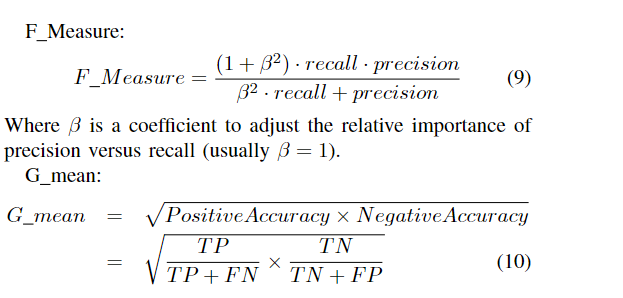

*Referencia: ADASYN: Adaptive Synthetic Sampling Approach for Imbalanced Learning. Haibo He, Yang Bai, Edwardo A. Garcia, and Shutao Li.*


Para computar ambas métricas en un problema multiclase desbalanceado realmente interesa la técnica macro. Porque al hacer la media entre, por ejemplo, las tres F1-Score para cada clase, da una idea de, si es muy baja sobre la clase minoritaria, como de malo es el modelo prediciendo esta clase. Esto es porque si la métrica F1-Score (de la clase minoritaria) fuese muy baja, el valor medio de la F1-Score caería bastante.

Otra técnica que va a ser clave y que se aplica en el paso 6 es la obtención de la matriz de confusión sobre el conjunto de entrenamiento y prueba. En esta se ve de manera clara el número de muestras de la clase minoritaria (clase '1' en dicha matriz) del conjunto de test que es capaz de predecir correctamente el modelo (**y por tanto la capacidad de generalización que aporta dicha técnica de remuestreo sintética sobre el conjunto de test no sobremuestreado**).

**WEIGHTED METRICS:**

In [53]:
"""from Paquetes.metrics import  clasification_metrics

metrics_list = {}   
# Metrics:
for r_technique,train_set in resampled_train_sets.items():
    metrics_list[r_technique] = clasification_metrics(
                                                            y_train = train_set[1],
                                                            x_train= train_set[0],
                                                            y_test  = y_test,
                                                            x_test = X_test_std,
                                                            clasifier = pipelines,
                                                            average = 'weighted', # altera "macro" para tener en cuenta el desequilibrio de clases
                                                            metrics = [
                                                                            "Recall" ,
                                                                            "Precision",
                                                                            "F1Score",
                                                                            "geometric_mean_score"
                                                                        ],
                                                            plot_roc_curve = False,
                                                            plot_confusion_matrix = False,

                                                    )"""

'from Paquetes.metrics import  clasification_metrics\n\nmetrics_list = {}   \n# Metrics:\nfor r_technique,train_set in resampled_train_sets.items():\n    metrics_list[r_technique] = clasification_metrics(\n                                                            y_train = train_set[1],\n                                                            x_train= train_set[0],\n                                                            y_test  = y_test,\n                                                            x_test = X_test_std,\n                                                            clasifier = pipelines,\n                                                            average = \'weighted\', # altera "macro" para tener en cuenta el desequilibrio de clases\n                                                            metrics = [\n                                                                            "Recall" ,\n                                                                     

In [54]:
"""df_aux = []
for k in resampled_train_sets.keys():
    metrics_list[k] = pd.concat(metrics_list[k],ignore_index=False)
    metrics_list[k].loc[k,:] = np.nan 
    df_aux.append(metrics_list[k])
metrics = pd.concat(df_aux,ignore_index=False)"""

'df_aux = []\nfor k in resampled_train_sets.keys():\n    metrics_list[k] = pd.concat(metrics_list[k],ignore_index=False)\n    metrics_list[k].loc[k,:] = np.nan \n    df_aux.append(metrics_list[k])\nmetrics = pd.concat(df_aux,ignore_index=False)'

In [55]:
"""metrics.head(30)"""

'metrics.head(30)'

**MICRO METRICS:**

In [56]:
"""from Paquetes.metrics import  clasification_metrics

metrics_list = {}     
# Metrics:
for r_technique,train_set in resampled_train_sets.items():
    metrics_list[r_technique] = clasification_metrics(
                                                            y_train = train_set[1],
                                                            x_train= train_set[0],
                                                            y_test  = y_test,
                                                            x_test = X_test_std,
                                                            clasifier = pipelines,
                                                            average = 'micro',
                                                            metrics = [
                                                                            "Recall" ,
                                                                            "Precision",
                                                                            "F1Score",
                                                                            "geometric_mean_score"
                                                                        ],
                                                            plot_roc_curve = False,
                                                            plot_confusion_matrix = False,

                                                    )"""

'from Paquetes.metrics import  clasification_metrics\n\nmetrics_list = {}     \n# Metrics:\nfor r_technique,train_set in resampled_train_sets.items():\n    metrics_list[r_technique] = clasification_metrics(\n                                                            y_train = train_set[1],\n                                                            x_train= train_set[0],\n                                                            y_test  = y_test,\n                                                            x_test = X_test_std,\n                                                            clasifier = pipelines,\n                                                            average = \'micro\',\n                                                            metrics = [\n                                                                            "Recall" ,\n                                                                            "Precision",\n                                             

In [57]:
"""df_aux = []
for k in resampled_train_sets.keys():
    metrics_list[k] = pd.concat(metrics_list[k],ignore_index=False)
    metrics_list[k].loc[k,:] = np.nan 
    df_aux.append(metrics_list[k])
metrics = pd.concat(df_aux,ignore_index=False)"""

'df_aux = []\nfor k in resampled_train_sets.keys():\n    metrics_list[k] = pd.concat(metrics_list[k],ignore_index=False)\n    metrics_list[k].loc[k,:] = np.nan \n    df_aux.append(metrics_list[k])\nmetrics = pd.concat(df_aux,ignore_index=False)'

In [58]:
"""metrics.head(30)"""

'metrics.head(30)'

**MACRO METRICS:**

In [59]:
"""from Paquetes.metrics import  clasification_metrics
     
metrics_list = {} 
# Metrics:
for r_technique,train_set in resampled_train_sets.items():
    metrics_list[r_technique] = clasification_metrics(
                                                            y_train = train_set[1],
                                                            x_train= train_set[0],
                                                            y_test  = y_test,
                                                            x_test = X_test_std,
                                                            clasifier = pipelines,
                                                            average = 'macro',
                                                            metrics = [
                                                                            "Recall" ,
                                                                            "Precision",
                                                                            "F1Score",
                                                                            "geometric_mean_score"
                                                                        ],
                                                            plot_roc_curve = False,
                                                            plot_confusion_matrix = False,

                                                    )"""

'from Paquetes.metrics import  clasification_metrics\n     \nmetrics_list = {} \n# Metrics:\nfor r_technique,train_set in resampled_train_sets.items():\n    metrics_list[r_technique] = clasification_metrics(\n                                                            y_train = train_set[1],\n                                                            x_train= train_set[0],\n                                                            y_test  = y_test,\n                                                            x_test = X_test_std,\n                                                            clasifier = pipelines,\n                                                            average = \'macro\',\n                                                            metrics = [\n                                                                            "Recall" ,\n                                                                            "Precision",\n                                            

In [60]:
"""df_aux = []
for k in resampled_train_sets.keys():
    metrics_list[k] = pd.concat(metrics_list[k],ignore_index=False)
    metrics_list[k].loc[k,:] = np.nan 
    df_aux.append(metrics_list[k])
metrics = pd.concat(df_aux,ignore_index=False)"""

'df_aux = []\nfor k in resampled_train_sets.keys():\n    metrics_list[k] = pd.concat(metrics_list[k],ignore_index=False)\n    metrics_list[k].loc[k,:] = np.nan \n    df_aux.append(metrics_list[k])\nmetrics = pd.concat(df_aux,ignore_index=False)'

In [61]:
"""metrics.head(30)"""

'metrics.head(30)'

## **Resultados:**

**Como se habia intuido los mejores resultados los ofrece la técnica SVM SMOTE, en concreto usando el algoritmo de RUSBoostClassifier.**

**A partir de aquí y según los resultados obtenidos, se usará este dataset creado mediante la técnica de SVM SMOTE para el conjunto de train.**

In [62]:
X_train_svmsmote = resampled_train_sets["SVMSMOTE"][0]
y_train_svmsmote = resampled_train_sets["SVMSMOTE"][1]

In [63]:
# Proporción de clases en el conjunto de train que se va a usar finalmente
print("Clases objetivo : ", np.unique(y_train_svmsmote))
print(f"Frecuencia de clases : {np.bincount(y_train_svmsmote)}")
for idx, v in enumerate(np.bincount(y_train_svmsmote)):
    print(f'Proporción de la clase {idx} : {100*v/y_train_svmsmote.shape[0] : .3f}','%')

Clases objetivo :  [0 1 2]
Frecuencia de clases : [3475  527 1865]
Proporción de la clase 0 :  59.230 %
Proporción de la clase 1 :  8.982 %
Proporción de la clase 2 :  31.788 %


### Paso 5 en: La metodología de elección de la técnica de remuestreo: 

    RUSBoostClassifier y validfacion cruzada sobre dataset resampled mediante SVM SNMOTE 

In [64]:
"""from Paquetes.cross_validate import cv_function

roboost_clf = RUSBoostClassifier(
                                    estimator = RandomForestClassifier(
                                                            n_estimators=100, 
                                                            max_depth=10, 
                                                            min_samples_split=5,
                                                            class_weight='balanced',
                                                            max_features='sqrt', 
                                                            random_state=42,
                                                            n_jobs=-1
                                                             ), 
                                    n_estimators=50, 
                                    learning_rate=1.0, 
                                    algorithm='SAMME.R', 
                                    sampling_strategy='auto', 
                                    replacement=False, 
                                    random_state=42
                                    )
metrics = [
                'accuracy', 
                'precision_micro',
                'precision_macro',
                'recall_micro',
                'recall_macro',
                'f1_micro',
                'f1_macro',
                'jaccard_micro',
                'jaccard_macro',
                'roc_auc_ovr',
                'roc_auc_ovo',
                'roc_auc_ovr_weighted',
                'roc_auc_ovo_weighted'
            ]
cv_str = ['k-folds', 'Stratified K-folds']

scores = cv_function(
                        X_train =X_train_svmsmote , 
                        y_train = y_train_svmsmote, 
                        n_splits=5,
                        pipelines = [roboost_clf], 
                        metrics = metrics,
                        cv_strategies = cv_str,
                        random_state =  0,
                        shuffle = True
                    )"""


"from Paquetes.cross_validate import cv_function\n\nroboost_clf = RUSBoostClassifier(\n                                    estimator = RandomForestClassifier(\n                                                            n_estimators=100, \n                                                            max_depth=10, \n                                                            min_samples_split=5,\n                                                            class_weight='balanced',\n                                                            max_features='sqrt', \n                                                            random_state=42,\n                                                            n_jobs=-1\n                                                             ), \n                                    n_estimators=50, \n                                    learning_rate=1.0, \n                                    algorithm='SAMME.R', \n                                    sampling_st

In [65]:
"""scores['Pipeline : 0'].head(50)"""

"scores['Pipeline : 0'].head(50)"

### Paso 6 en: La metodología de elección de la técnica de remuestreo: 

    A continuación se plotean las matrices de confusión enfocandose en el dataset SVM SMOTE y usando RUSBoostClassifier

In [66]:
"""from Paquetes.metrics import  clasification_metrics
roboost_clf = RUSBoostClassifier(
                                    estimator = RandomForestClassifier(
                                                            n_estimators=100, 
                                                            max_depth=10, 
                                                            min_samples_split=5,
                                                            class_weight='balanced',
                                                            max_features='sqrt', 
                                                            random_state=42,
                                                            n_jobs=-1
                                                             ), 
                                    n_estimators=50, 
                                    learning_rate=1.0, 
                                    algorithm='SAMME.R', 
                                    sampling_strategy='auto', 
                                    replacement=False, 
                                    random_state=42
                                    )
roboost_clf.fit(X_train_svmsmote, y_train_svmsmote) 
metrics_list = clasification_metrics(
                                        y_train = y_train_svmsmote,
                                        x_train= X_train_svmsmote,
                                        y_test  = y_test,
                                        x_test = X_test_std,
                                        clasifier = [roboost_clf],
                                        average = 'macro',
                                        metrics = [
                                                        "Recall" ,
                                                        "Precision",
                                                        "F1Score",
                                                        "Especificidad" ,
                                                        "JaccardIndex" ,
                                                        "geometric_mean_score"
                                                    ],
                                        plot_roc_curve = True,
                                        plot_confusion_matrix = True,

                                        )"""


'from Paquetes.metrics import  clasification_metrics\nroboost_clf = RUSBoostClassifier(\n                                    estimator = RandomForestClassifier(\n                                                            n_estimators=100, \n                                                            max_depth=10, \n                                                            min_samples_split=5,\n                                                            class_weight=\'balanced\',\n                                                            max_features=\'sqrt\', \n                                                            random_state=42,\n                                                            n_jobs=-1\n                                                             ), \n                                    n_estimators=50, \n                                    learning_rate=1.0, \n                                    algorithm=\'SAMME.R\', \n                                    sam

In [67]:
"""metrics_list[0].head()"""

'metrics_list[0].head()'

#### **Como se observa, el rendimiento del modelo es muy pobre a pesar de ser el mejor dataset y modelo elegido de entre todos los posibles. De ahora en adelante se van a intentar tomar medidas para mejorar este hecho.**


### **Selección de características**

El siguiente paso tras el sobremuestreo de la clase minoritaria sintética es la selección de características más relevantes. El EDA realizado sugiere, por ejemplo, que hay ciertas características donde la clase minoritaria no está presente, lo que tal vez pueda estar introduciendo ruido. Esto es muy común en datasets de origen médico, donde a veces hay características sobrantes. En este contexto, se van a aplicar tres técnicas para la selección de las características más relevantes:

1. **Sequential Feature Selection (técnica de tipo Wrapper)**:
   - Utilizando como estimadores:
        - RandomForest 

2. **Selección de importancia basada en algoritmos tipo árbol**, donde estos, en función de la maximización de la ganancia de información, deciden dividir las muestras en un nodo fijándose en una característica u otra (*Forest Family Selector*).
   - Utilizando como estimadores/clasificadores:
        - ExtraTreeClassifier
        - GradientBoostingClassifier
        - BalancedRandomForestClassifier

3. **Selección de características utilizando PCA**, en concreto usando la componente 1 de PCA (primer autovector de la matriz de correlación entre las características del dataset resampled). Esta componente se ha combinado linealmente con cada una de las características y en qué grado lo ha hecho para conservar la mayor varianza posible. Es decir, si este autovector es una combinación lineal de las demás características, tendrá una mayor proporción de ciertos vectores unitarios asociados a ciertas características, y esas son las variables o características que permiten maximizar la conservación de la varianza del espacio de características original en el nuevo espacio de componentes principales. Estas variables se tomarán como las características que otorgan una mayor importancia de predicción.

Una vez aplicados los tres métodos y obtenidas las características que cada método considera importantes, se seleccionan las k primeras características de cada uno, se eliminan las repetidas y se usan solo estas características seleccionadas en el dataset resampled de entrenamiento mediante SVMSMOTE y en el de test original.

In [68]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SequentialFeatureSelector

# Estimators
SQS_estimators = [
                    (
                        'RandomForestClassifier',
                        RandomForestClassifier(
                                                    n_estimators=50, 
                                                    max_depth=10, 
                                                    min_samples_split=5,
                                                    class_weight='balanced',
                                                    max_features='sqrt', 
                                                    random_state=42,
                                                    n_jobs=-1

                                                
                                                )
                     )
                
                ]

In [69]:
selected_features = {}
for  _,stm in enumerate(SQS_estimators):
    
    # Sequential feature selector
    sfs = SequentialFeatureSelector(
                                        estimator  =stm[1], 
                                        n_features_to_select = 5, 
                                        direction='backward',
                                        cv = 5,
                                        n_jobs = -1
                                    )

    # Fit to the training data
    sfs.fit(X_train_svmsmote, y_train_svmsmote)

    # Transformed features
    selected_features[stm[0]] = X.columns[sfs.get_support(indices=False)]

print(selected_features)

{'RandomForestClassifier': Index(['Copper', 'Prothrombin', 'Age_Years', 'Bilirubin_Albumin', 'Diag_Year'], dtype='object')}


**Forest family selectors :** 

In [70]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.feature_selection import SelectFromModel

clf = ExtraTreesClassifier(
                            n_estimators=100, 
                            criterion='entropy', 
                            max_depth=10,
                            min_samples_split=5, 
                            min_samples_leaf=1,
                            class_weight='balanced',
                            max_features='sqrt', 
                            random_state=42
                            )

clf = clf.fit(X_train_svmsmote, y_train_svmsmote)
feature_importances_indx = list(np.argsort(clf.feature_importances_  ).flatten())
feature_importances_indx.reverse()
features_sorted_by_importance_etc = X.columns[feature_importances_indx] 


In [71]:
features_sorted_by_importance_etc 

Index(['Age_Group', 'Hepatomegaly_Y', 'Bilirubin_Albumin', 'Diag_Year',
       'Age_Years', 'Edema', 'Diagnosis_Date', 'Stage', 'Copper', 'Spiders_Y',
       'SGOT', 'Prothrombin', 'Drug_Effectiveness', 'Cholesterol', 'Ascites_Y',
       'Diag_Month', 'Liver_Function_Index', 'Tryglicerides', 'Platelets',
       'Sex_M', 'Risk_Score'],
      dtype='object')

In [72]:
importance_by_feature = pd.DataFrame(data = clf.feature_importances_.reshape(1,-1), columns = list(X.columns))

In [73]:
importance_by_feature.head()

,Edema,Cholesterol,Copper,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Sex_M,Ascites_Y,Hepatomegaly_Y,Spiders_Y,Diagnosis_Date,Age_Years,Age_Group,Bilirubin_Albumin,Drug_Effectiveness,Liver_Function_Index,Risk_Score,Diag_Year,Diag_Month
0,0.064382,0.026487,0.051715,0.040878,0.019314,0.019296,0.035771,0.057786,0.017731,0.024696,0.104426,0.043713,0.063969,0.069105,0.107859,0.090204,0.026982,0.019601,0.017365,0.07552,0.023201


In [74]:
from imblearn.ensemble import RUSBoostClassifier,BalancedRandomForestClassifier

In [75]:
clf = BalancedRandomForestClassifier(
                            n_estimators=100, 
                            criterion='entropy', 
                            max_depth=10, 
                            min_samples_split=5, 
                             min_samples_leaf=1,
                            max_features='sqrt', 
                            sampling_strategy='auto',
                            replacement=True,
                            n_jobs=-1, 
                            random_state=42, 
                            class_weight='balanced',
)

clf = clf.fit(X_train_svmsmote, y_train_svmsmote)
feature_importances_indx = list(np.argsort(clf.feature_importances_  ).flatten())
feature_importances_indx.reverse()
features_sorted_by_importance_brf = X.columns[feature_importances_indx] 

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\imblearn\ensemble\_forest.py:600: FutureWarning:

The default of `bootstrap` will change from `True` to `False` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `False` to silence this warning and adopt the future behaviour.



In [76]:
features_sorted_by_importance_brf

Index(['Bilirubin_Albumin', 'Diagnosis_Date', 'Age_Years', 'Copper',
       'Age_Group', 'Diag_Year', 'Prothrombin', 'SGOT', 'Platelets',
       'Tryglicerides', 'Liver_Function_Index', 'Risk_Score', 'Cholesterol',
       'Diag_Month', 'Drug_Effectiveness', 'Stage', 'Edema', 'Hepatomegaly_Y',
       'Spiders_Y', 'Ascites_Y', 'Sex_M'],
      dtype='object')

In [77]:
importance_by_feature = pd.DataFrame(data = clf.feature_importances_.reshape(1,-1), columns = list(X.columns))
importance_by_feature.head()

,Edema,Cholesterol,Copper,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Sex_M,Ascites_Y,Hepatomegaly_Y,Spiders_Y,Diagnosis_Date,Age_Years,Age_Group,Bilirubin_Albumin,Drug_Effectiveness,Liver_Function_Index,Risk_Score,Diag_Year,Diag_Month
0,0.018775,0.044039,0.080474,0.067347,0.04712,0.047402,0.068322,0.024422,0.003547,0.003822,0.013829,0.008778,0.08463,0.081336,0.075043,0.113121,0.026779,0.046409,0.045423,0.069962,0.029419


In [78]:
clf =RUSBoostClassifier(
                           estimator = RandomForestClassifier(
                                                            n_estimators=100, 
                                                            max_depth=10, 
                                                            min_samples_split=5,
                                                            class_weight='balanced',
                                                            max_features='sqrt', 
                                                            random_state=42,
                                                            n_jobs=-1
                                                             ), 
                           n_estimators=50, 
                           learning_rate=1.0, 
                           algorithm='SAMME.R', 
                           sampling_strategy='auto', 
                           replacement=False, 
                           random_state=42
)

clf = clf.fit(X_train_svmsmote, y_train_svmsmote) 
feature_importances_indx = list(np.argsort(clf.feature_importances_  ).flatten())
feature_importances_indx.reverse()
features_sorted_by_importance_rbc = X.columns[feature_importances_indx] 

In [79]:
clf.feature_importances_.reshape(1,-1)

array([[nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
        nan, nan, nan, nan, nan, nan, nan, nan]])

In [80]:
features_sorted_by_importance_rbc 

Index(['Diag_Month', 'Ascites_Y', 'Cholesterol', 'Copper', 'SGOT',
       'Tryglicerides', 'Platelets', 'Prothrombin', 'Stage', 'Sex_M',
       'Hepatomegaly_Y', 'Diag_Year', 'Spiders_Y', 'Diagnosis_Date',
       'Age_Years', 'Age_Group', 'Bilirubin_Albumin', 'Drug_Effectiveness',
       'Liver_Function_Index', 'Risk_Score', 'Edema'],
      dtype='object')

In [81]:
importance_by_feature = pd.DataFrame(data = clf.feature_importances_.reshape(1,-1), columns = list(X.columns))
importance_by_feature.head()

,Edema,Cholesterol,Copper,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Sex_M,Ascites_Y,Hepatomegaly_Y,Spiders_Y,Diagnosis_Date,Age_Years,Age_Group,Bilirubin_Albumin,Drug_Effectiveness,Liver_Function_Index,Risk_Score,Diag_Year,Diag_Month
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Estudio de PCA:**

Se hace uso de la clase de creación propia *PCAStudy*, que incorpora métodos y atributos que agilizan el proceso de estudio de PCA mediante los objetos PCAStudy (cada uno con su codificación de variables categóricas, transformación numérica, número de componentes ...)

Sobre todo, la comparación entre varios objetos PCAStudy se realiza haciendo uso del método estático de la clase: *combined_study*.

In [82]:
# Crea objeto dataframe necesario para pasar como parametro o argumento en la instancia de la clase PCAStudy 
df_X_train_svmsmote = pd.DataFrame(data = X_train_svmsmote, columns = list(X.columns))

In [83]:
from Paquetes.dimensionality_reduction import PCAStudy
from sklearn.preprocessing import StandardScaler,MinMaxScaler,MaxAbsScaler,RobustScaler
from sklearn.preprocessing import OneHotEncoder

pca_1 = PCAStudy(data = df_X_train_svmsmote , encoder = OneHotEncoder(), pca_components = 3 , num_transformer = None,verbose  = 1)
pca_2 = PCAStudy(data = df_X_train_svmsmote , encoder = OneHotEncoder(), pca_components = 3, num_transformer = None,verbose  = 1)

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\tqdm\auto.py:21: TqdmWarning:

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html



In [84]:
pca_1.study_case
#pca_1.plot_variance_retained
#pca_1.plot_feature_weights

combinations [(OneHotEncoder(), 3)]
Columns with NA  []
No NA values in the dataframe
Numero de features tras step ColumnTransformer(remainder='passthrough',
                  transformers=[('encoder', OneHotEncoder(), [])]):  21
-----------------------------------------------------------------


In [85]:
pca_2.study_case
#pca_2.plot_variance_retained
#pca_2.plot_feature_weights

combinations [(OneHotEncoder(), 3)]
Columns with NA  []
No NA values in the dataframe
Numero de features tras step ColumnTransformer(remainder='passthrough',
                  transformers=[('encoder', OneHotEncoder(), [])]):  21
-----------------------------------------------------------------


In [86]:
PCAStudy.combined_study(pca_1,pca_2)

,ENCODER,ORIGINAL_FEATURES,ENCODED_FEATURES,NUMERICAL_TRANSFORMER,PCA_COMPONENTS,ORIGINAL_VARIANCE_RETAINED
0,OneHotEncoder(),21,21,None,3,0.420033
0,OneHotEncoder(),21,21,None,3,0.420035


In [87]:
data = np.vstack((  
                    selected_features['RandomForestClassifier'].to_list() + ['']*(len(X.columns) - len(selected_features['RandomForestClassifier'].to_list())) ,
                    features_sorted_by_importance_etc.values,
                    features_sorted_by_importance_brf.values,
                    features_sorted_by_importance_rbc.values,
                    X.columns[np.flip(np.argsort(np.abs(pca_1.eigenvectors[0,:])), axis=0)],
                    X.columns[np.flip(np.argsort(np.abs(pca_2.eigenvectors[0,:])), axis=0)]
                    
                    ))
print(data.shape)



index = [
                'RandomForestClassifier sqf', 
                'ExtraTreesClassifier',
                'BalancedRandomForestClassifier',
                'RUSBoostClassifier',
                f'PCA {pca_1.__class__.__name__} ',
                f'PCA {pca_2.__class__.__name__} '

                
        ]
important_features_results = pd.DataFrame(data = data, columns = list(range(1,len(X.columns)+1)), index = index )



(6, 21)


In [88]:
important_features_results

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
RandomForestClassifier sqf,Copper,Prothrombin,Age_Years,Bilirubin_Albumin,Diag_Year,,,,,,,,,,,,,,,,
ExtraTreesClassifier,Age_Group,Hepatomegaly_Y,Bilirubin_Albumin,Diag_Year,Age_Years,Edema,Diagnosis_Date,Stage,Copper,Spiders_Y,SGOT,Prothrombin,Drug_Effectiveness,Cholesterol,Ascites_Y,Diag_Month,Liver_Function_Index,Tryglicerides,Platelets,Sex_M,Risk_Score
BalancedRandomForestClassifier,Bilirubin_Albumin,Diagnosis_Date,Age_Years,Copper,Age_Group,Diag_Year,Prothrombin,SGOT,Platelets,Tryglicerides,Liver_Function_Index,Risk_Score,Cholesterol,Diag_Month,Drug_Effectiveness,Stage,Edema,Hepatomegaly_Y,Spiders_Y,Ascites_Y,Sex_M
RUSBoostClassifier,Diag_Month,Ascites_Y,Cholesterol,Copper,SGOT,Tryglicerides,Platelets,Prothrombin,Stage,Sex_M,Hepatomegaly_Y,Diag_Year,Spiders_Y,Diagnosis_Date,Age_Years,Age_Group,Bilirubin_Albumin,Drug_Effectiveness,Liver_Function_Index,Risk_Score,Edema
PCA PCAStudy,Bilirubin_Albumin,Diagnosis_Date,Copper,Hepatomegaly_Y,Edema,Ascites_Y,Diag_Year,Drug_Effectiveness,Prothrombin,Age_Years,Age_Group,Stage,Spiders_Y,SGOT,Tryglicerides,Liver_Function_Index,Risk_Score,Platelets,Cholesterol,Sex_M,Diag_Month
PCA PCAStudy,Bilirubin_Albumin,Diagnosis_Date,Copper,Hepatomegaly_Y,Edema,Ascites_Y,Diag_Year,Drug_Effectiveness,Prothrombin,Age_Years,Age_Group,Stage,Spiders_Y,SGOT,Tryglicerides,Liver_Function_Index,Risk_Score,Platelets,Cholesterol,Sex_M,Diag_Month


## **Resultados del proceso de selección de características**

Una vez (según se observa en el dataframe anterior) se tienen las características ordenadas por importancia según la técnica y algoritmo usado, se procede a seleccionar las *NUM_FEATS_TO_SELECT* de cada método concatenando todas y eliminando (usando un set) las repetidas. Luego, se eliminan del dataset de entrenamiento sobremuestreado y del conjunto de test.

Las variables elegidas son ... argumentar por que puede ser

In [89]:
NUM_FEATS_TO_SELECT = 4
SELECTORS = important_features_results.index.to_list()
# selecciona de entre todos los selectores las primeras NUM_FEATS_TO_SELECT features elegidas de esas NUM_FEATS_TO_SELECT*num selectors features coge las no repetidas
SELECT_FEATS = set(important_features_results.loc[SELECTORS,0:NUM_FEATS_TO_SELECT].values.flatten())
NUM_FEATS_TO_SELECT = len(SELECT_FEATS)

In [90]:
FEAT_AFTER_PIPE

['Edema',
 'Cholesterol',
 'Copper',
 'SGOT',
 'Tryglicerides',
 'Platelets',
 'Prothrombin',
 'Stage',
 'Sex_M',
 'Ascites_Y',
 'Hepatomegaly_Y',
 'Spiders_Y',
 'Diagnosis_Date',
 'Age_Years',
 'Age_Group',
 'Bilirubin_Albumin',
 'Drug_Effectiveness',
 'Liver_Function_Index',
 'Risk_Score',
 'Diag_Year',
 'Diag_Month']

In [91]:
# limpieza del set por si hay columnas no existentes en el dataset pipelined
SELECT_FEATS = {x for x in SELECT_FEATS if x in FEAT_AFTER_PIPE}

In [92]:
# Caracteristicas seleccionadas
SELECT_FEATS

{'Age_Group',
 'Age_Years',
 'Ascites_Y',
 'Bilirubin_Albumin',
 'Cholesterol',
 'Copper',
 'Diag_Month',
 'Diag_Year',
 'Diagnosis_Date',
 'Hepatomegaly_Y',
 'Prothrombin'}

In [93]:
# Numero de caracteristicas seleccionadas 
NUM_FEATS_TO_SELECT

11

In [94]:
# Indices de cada columna seleccionada en el dataframe transformado o pipelined
SELECT_INDX = [index for index, value in enumerate(FEAT_AFTER_PIPE) if value in SELECT_FEATS]

In [95]:
SELECT_INDX

[1, 2, 6, 9, 10, 12, 13, 14, 15, 19, 20]

## **UMAP : *Uniform manifold approximation and projection***

### **Problemas en este punto y el por qué de UMAP:**

En este punto, se tiene un conjunto de entrenamiento sobremuestreado de manera sintética al que previamente se le han añadido nuevas características creadas mediante ingeniería de características. Despues, se han codificado las variables categóricas utilizando label o one-hot, y se han transformado las variables numéricas codificadas y originales mediante estandarización. Sin embargo, tras una serie de intentos con varios modelos de clasificación, el conjunto de entrenamiento no permitía una buena generalización sobre el conjunto de test. El sobreajuste era demasiado elevado y las métricas pobres.

En esta situación, volviendo a observar el EDA sobre el dataset original, pensamos que era un problema no linealmente separable de alta dimensionalidad y con ruido, debido a variables que ni siquiera contenían muestras de la clase minoritaria. Esto podia significar que los datapoints estuviesen distribuidos en un manifold en el espacio original (de alta dimension). Es decir, que cada clase habitase en una variedad subyacente de dimensiones inferiores pero incrustada en el espacio de alta dimensión. Investigando, se nos ocurrió usar algún algoritmo que transformara nuestro espacio inicial de características en otro espacio de menor dimensión donde resolver el problema de clasificación fuera más sencillo porque se conservasen cada uno de estos subespacios o de dimensiones dentro de la dimension original. 

Estudiando ciertos papers llegamos a la conclusion de que necesitabamos conservar la relación geométrica (es decir, la distancia entre datapoints), lo que se conoce como conservar el "manifold" en el espacio de alta dimensionalidad, pero en un espacio de menor dimensión, de tal forma que los datapoints de la misma clase en el espacio de alta dimensionalidad se agrupasen entre sí y se separasen a la vez de las otras clases en nuestro espacio transformado de menor dimensión. 

Además, esta reducción de dimensionalidad aportaría interpretabilidad, permitiendo graficar nuestro problema de manera completa (incluyendo todas las muestras en un único espacio). 

Además, como la técnica de SVMSMOTE utilizada habia generado muestras sintéticas de una misma clase (la minoritaria) por interpolación y cercanas unas a otras, es decir, geométricamente similares entre sí, tenía sentido utilizar UMAP, que prioriza la conservación de estas distancias entre datapoints a la hora de llevar a cabo esta transformación o reducción de dimensionalidad no lineal.

### **Algoritmo, problemas encotrados y transfoirmacion realizada mediante el objeto *mapper*:**

- **Explicación breve y rigurosa a nivel teórica del algoritmo:**

    UMAP es una técnica de reducción dimensional que puede utilizarse para la visualización de forma similar a t-SNE, pero también para la reducción dimensional no lineal general. El algoritmo se basa en tres hipótesis sobre los datos:

    1. Los datos se distribuyen uniformemente en un *Riemannian manifold* 

    2. La métrica de *Riemannian* es localmente constante (o puede aproximarse como tal)

    3. La *Riemannian manifold*  está localmente conectada.

    A partir de estos supuestos, es posible modelizar el *manifold* (en el espacio de alta dimensión) con una estructura topológica difusa. La incrustación se encuentra buscando una proyección de baja dimensión de los datos que tenga la estructura topológica difusa equivalente más cercana posible optimizando una función de coste basada en la divergencia de Jensen-Shannon.
    Con esta función se mide el grado de similitud entre puntos en el espacio original y en el espacio de menor dimensión y al ser optimizada se encuentra una representación de los datos en el espacio de menor dimensión que conserva la relación geométrica local (o manifold en la alta dimension) de las muestras.

- **Explicación a alto nivel del algoritmo:**

    1. Primero deben calcularse (mediante la métrica de distancia que se quiera o admita en este caso el algoritmo) la distancia entre las muestras en el espacio de alta dimensionalidad.

    2. Se deben definir el número de vecinos el cual UMAP utiliza para calcular, para cada muestra, las puntuaciones de similitud en el espacio de alta dimensionalidad. Básicamente se calculan las puntuaciones de similitud entre cada muestra considerada y los demás datapoints mediante una función exponencial negativa que recibe como parámetro la resta entre la distancia en bruto entre un par de datapoints (obtenidas en el paso uno), le resta la mínima distancia entre esa muestra considerada y todos los "neighborhood" datapoints y divide esta cantidad entre un parámetro sigma. El valor de este parámetro viene determinado por el número de vecinos pasado como hiperparámetro al algoritmo. La suma (para cada datapoint) de la puntuación de similitud con las demás muestras debe ser igual a la suma del logaritmo en base dos del número de vecinos. De esta forma se ajusta sigma.

    3. Una vez se tienen las puntuaciones de similitud por muestra en el espacio de alta dimensionalidad con respecto a las demás muestras, se tienen dos medidas de similitud (distintas o no) entre cada par de muestras. Para corregir esto y conseguir la simetría en las medidas de similitud se aplica (a diferencia del algoritmo t-sne que simplemente calcula la media) la operación de unión difusa [que es parte de la teoría de espacios topológicos en la que se desarrolla este algoritmo]. Esto permite disponer de un único conjunto de puntuaciones simétricas de similitud entre cada par de muestras dentro del mismo "neighborhood" o también llamado "cluster".

    4. En este momento UMAP inicializa la ubicación de los datapoints, mediante la técnica de incrustación espectral, en un espacio de dimensión inferior y cuya dimensión se especifica como hiperparámetro (n_components).

    5. Ahora con los datapoints incrustados, en este espacio de menor dimensión, calcula las puntuaciones de similitud entre cada muestra incrustada en este espacio. El cálculo de estas puntuaciones de similitud entre cada par de puntos se realiza haciendo uso de una distribución t-student simétrica que a su vez hace uso de la "distancia" o relación geométrica de los datapoints en EL ESPACIO DE BAJA DIMENSIONALIDAD no en el de alta.

    6. Ahora para "recolocar" cada muestra en el espacio de menor dimensión de tal manera que las puntuaciones de similitud en ambos espacios (alta dimensión y baja dimensión) entre cada par de puntos sean similares, optimiza la función de coste basada en la divergencia de Jensen-Shannon. Esta función, en términos generales, va disminuyendo a medida que la reubicación de una muestra incrustada provoca el aumento de la puntuación de similitud de baja dimensión entre esta muestra y otra muestra con una alta puntuación de similitud en el espacio de alta dimensionalidad. Y es mayor si la reubicación de esta muestra incrustada provoca el aumento de la puntuación de similitud en el espacio de baja dimensión entre esta muestra y otra muestra con una baja puntuación de similitud en el espacio de alta dimensionalidad.
    En resumen, esta función de coste penaliza reubicaciones de muestras en el espacio de menor dimensión si esta reubicación implica "acercarse" a muestras que en el espacio de alta dimensionalidad no están "cercanas" (que no pertenecen a su subespacio de dimensión menor dentro del manifold o, coloquialmente "neighborhood"). 

    7. Por ultimo, la optimización de esta funcion de coste se realiza aplicando el gradiente descendiente estocástico debido a que solo se reubican una serie de datapoints por iteración. Como criterio de parada puede hacer uso de un numero de iteraciones, pero tipicamente hace uso del hiperparametro min_dist que sirve como distancia de baja dimensionalidad mínina que se quiere entre una muestra y su muestra mas similar en el espacio de alta dimensión. Esto significa que valores bajos de min_dist resultarán en incrustaciones más toscas. Esto puede ser útil si se está interesado en la agrupación, o en una estructura topológica más fina. Valores mayores de min_dist evitarán que UMAP empaquete puntos y se centrará en la preservación de la estructura topológica más amplia.

- **Problemas encontrados y como se ha usado UMAP para resolver el problema:**

    UMAP aporta ventajas destacables para nuestros problemas, como tener la capacidad de utilizar etiquetas (es decir, las clases de cada muestra) para la reducción de dimensión supervisada, y además, lo más importante, la capacidad de transformar nuevos datos no vistos en un espacio de incrustación preentrenado. Es decir, entrenar un mapeador en el conjunto de entrenamiento y usar este objeto mapeador entrenado para transformar el conjunto de prueba a este nuevo espacio.

    El principal desafío ha sido encontrar la métrica de distancia óptima entre muestras en el espacio de alta dimensión. Según muestran las gráficas, ciertas distancias como la euclidea no funcionaban muy bien. La distancia que permite conservar el "manifold" de manera más eficiente en el espacio de menor dimensión es la distancia **Hamming**. 

    Esta distancia es óptima para vectores binarios y se usa para el cálculo de distancias entre vectores de esta naturaleza. Básicamente, compara pares de elementos del vector en la misma posición; si son diferentes, almacena para esa posición el valor de '1', y si son iguales (0 o 1), almacena en esa posición un '0'. Luego lleva a cabo el sumatorio de las componentes de este pseudovector creado, y esta es la distancia entre ambos. En el caso de que no sean puramente binarios, la fórmula es una adaptación de la anterior.

    A pesar de no ser exactamente el caso de nuestro dataset, sí tiene sentido que esta métrica de distancia Hamming aporte los mejores resultados debido a la codificación previa de las variables nominales haciendo uso de one hot encoding.

    - Hiperparametro n_neighbors:

        Este parámetro es clave, controla cómo UMAP equilibra la estructura local frente a la global en los datos. Lo hace restringiendo el tamaño de la vecindad local que UMAP mirará cuando intente aprender la estructura múltiple de los datos. Esto significa que los valores bajos de n_neighbors forzarán a UMAP a concentrarse en la estructura muy local , mientras que los valores grandes empujarán a UMAP a mirar vecindarios más grandes de cada punto cuando estime la estructura múltiple de los datos, perdiendo la estructura de detalle fino en aras de obtener la más amplia de los datos.

        Sabiendo esto, hemos optado por valores pequeños de este hiperparametro (aunque se ha probado también conn un rango de ellos) para buscar que UMAP se centre en la estructura muy local de muestras de la clase desbalanceada.

        

De nuevo, como en casos anteriores, la aplicación de esta técnica mediante el uso de esta librería *umap* y la lógica en la llamada a su API se realiza mediante la función propia *UMAPStudy* alojada en el módulo *dimensionality_reduction*. Esta función gestiona la creación y el entrenamiento del objeto *mapper*, así como la creación de las gráficas de muestras en el nuevo espacio de menor dimensión donde se han incrustado o mapeado.

In [96]:
# UMAP: Uniform manifold approximation and projection (non-linear dimensionality reduction)
from Paquetes.dimensionality_reduction import UMAPStudy

In [97]:
X_train_svmsmote[:,SELECT_INDX].shape

(5867, 11)

**ESTUDIO UMAP :**

In [98]:
"""distances =[
            "cosine",
            "hamming",
            "euclidean",
            "manhattan"
            ]

for n_neighbor in [2,50,100]:
    for n_c in [2]:
        for metric_i in distances:
            for min_dist in [0.1,0.5,1]:
                try:
                    X_train_UMAP,X_test_UMAP ,_= UMAPStudy(
                                                            X_train= X_train_svmsmote[:,SELECT_INDX],
                                                            y_train=y_train_svmsmote, 
                                                            X_test= X_test_std[:,SELECT_INDX],
                                                            y_test=y_test, 
                                                            min_dist  = min_dist,
                                                            n_neighbors = n_neighbor,
                                                            n_components = n_c, 
                                                            metric = metric_i,
                                                            random_state = 42,
                                                            title = f'n_neighbors:{n_neighbor} - n_components:{n_c} - metric: {metric_i} - min_dist: {min_dist}' 
                                                            )
                except ValueError as e:
                    print(e)"""

'distances =[\n            "cosine",\n            "hamming",\n            "euclidean",\n            "manhattan"\n            ]\n\nfor n_neighbor in [2,50,100]:\n    for n_c in [2]:\n        for metric_i in distances:\n            for min_dist in [0.1,0.5,1]:\n                try:\n                    X_train_UMAP,X_test_UMAP ,_= UMAPStudy(\n                                                            X_train= X_train_svmsmote[:,SELECT_INDX],\n                                                            y_train=y_train_svmsmote, \n                                                            X_test= X_test_std[:,SELECT_INDX],\n                                                            y_test=y_test, \n                                                            min_dist  = min_dist,\n                                                            n_neighbors = n_neighbor,\n                                                            n_components = n_c, \n                                         

In [99]:
UMAP_PARAM = {
                'n_neighbors': [10,20,50,100],
                'n_components': [2],
                'min_dist': [0.1,0.5,1],
                'metric': ['hamming']

                }


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\Paquetes\visualization.py:1525: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1879: UserWarning:

gradient function is not yet implemented for hamming distance metric; inverse_transform will be unavailable

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\umap\umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0
Filas de la figura:  1
Columnas de la figura:  2
plotting_vars =  ['0', '1']
Detected outliers in ('0_outlier', '1_outlier') :  0


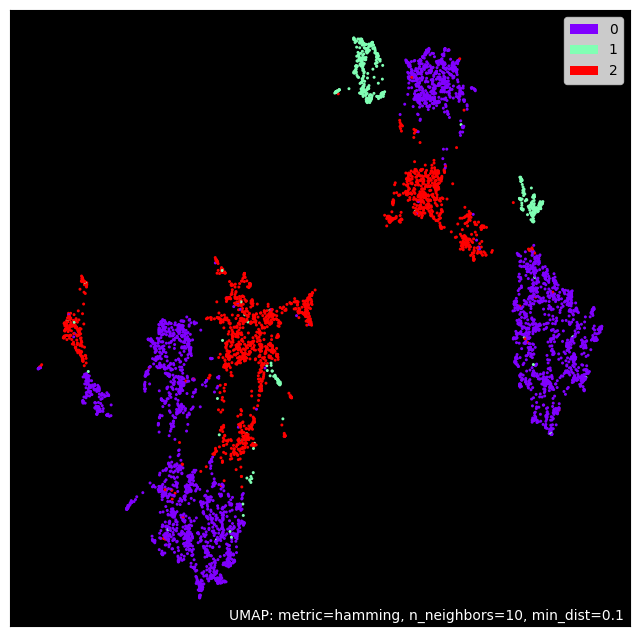

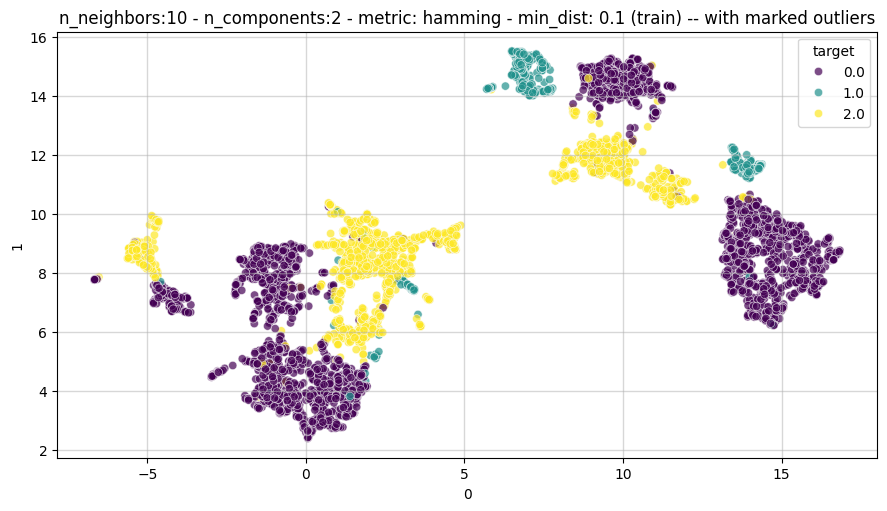

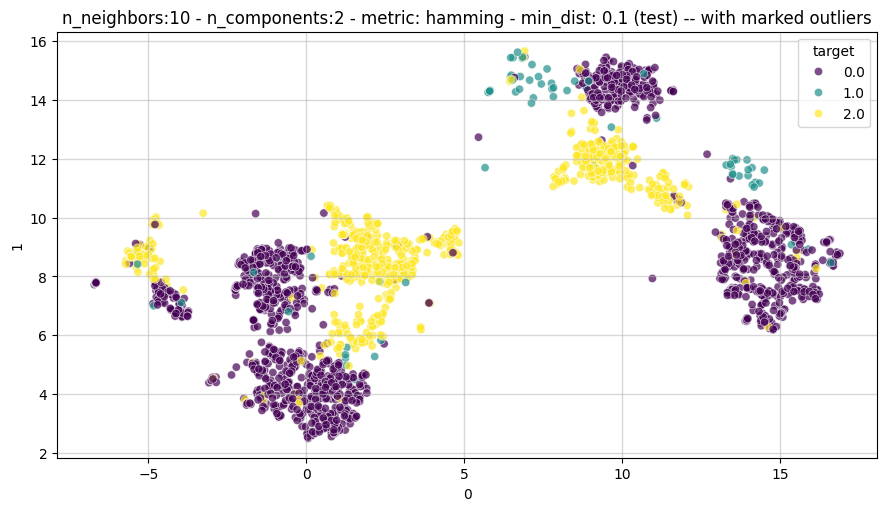

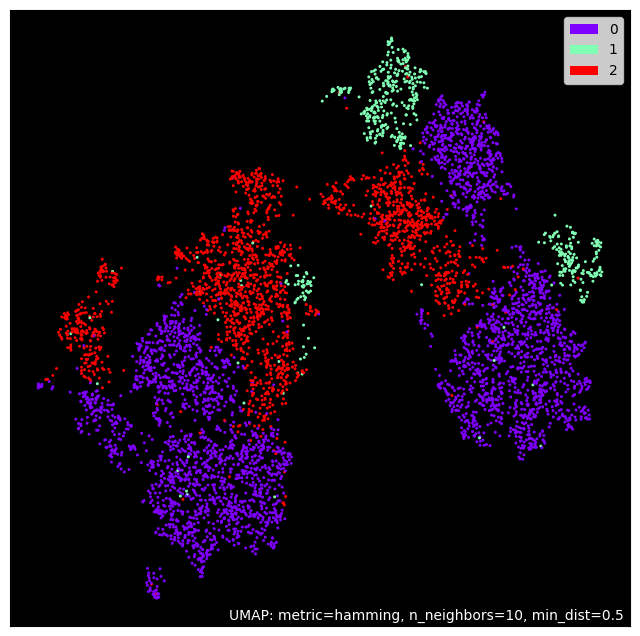

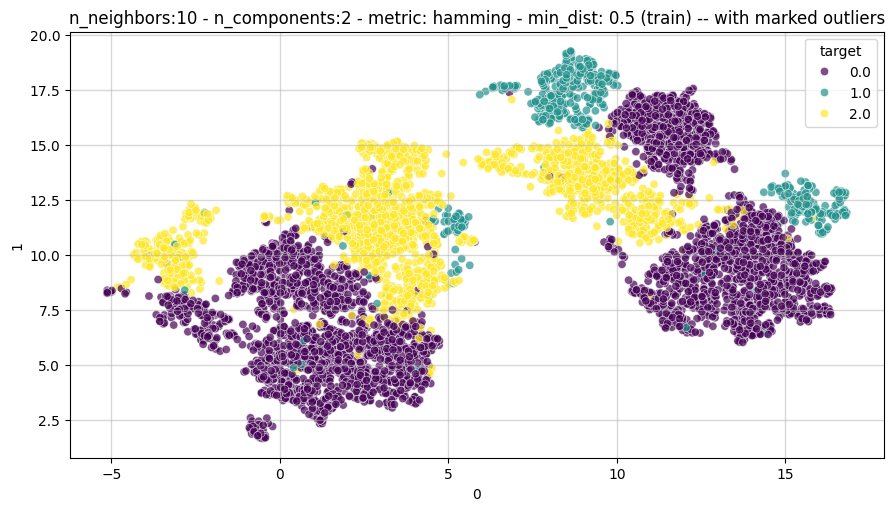

...

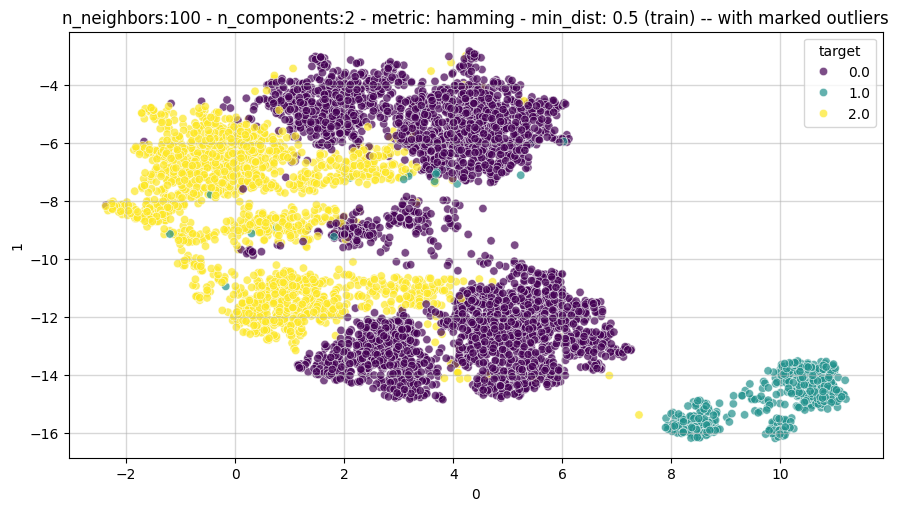

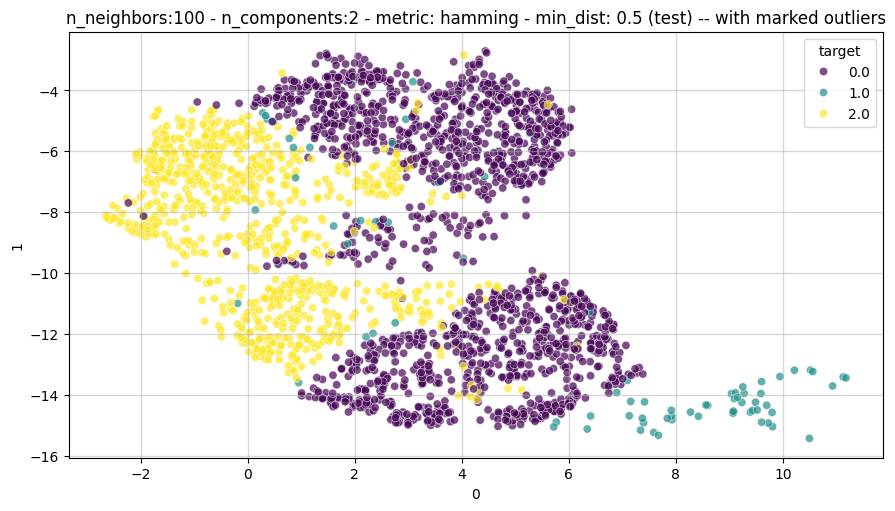

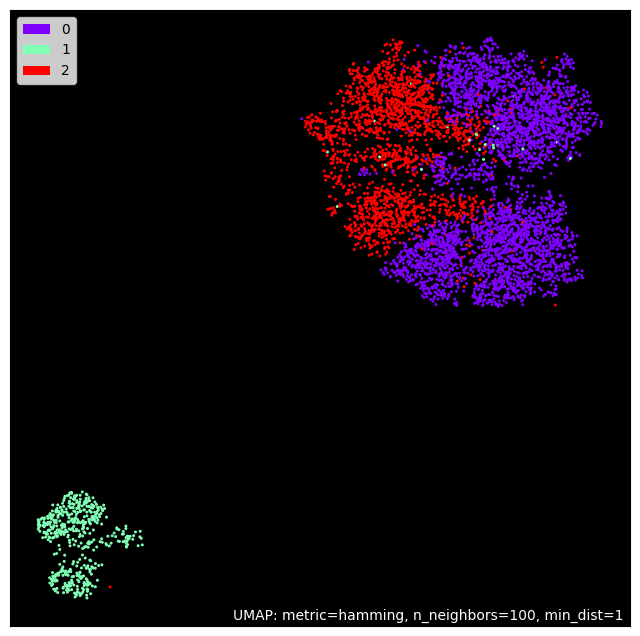

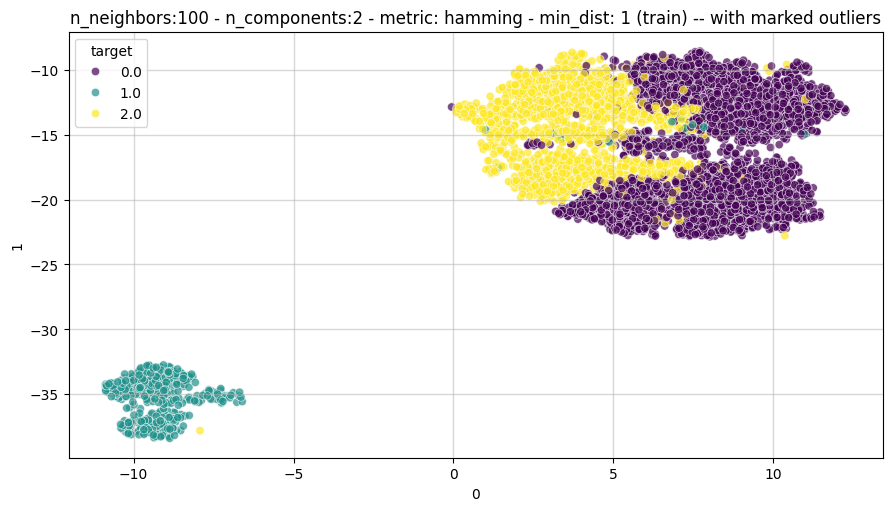

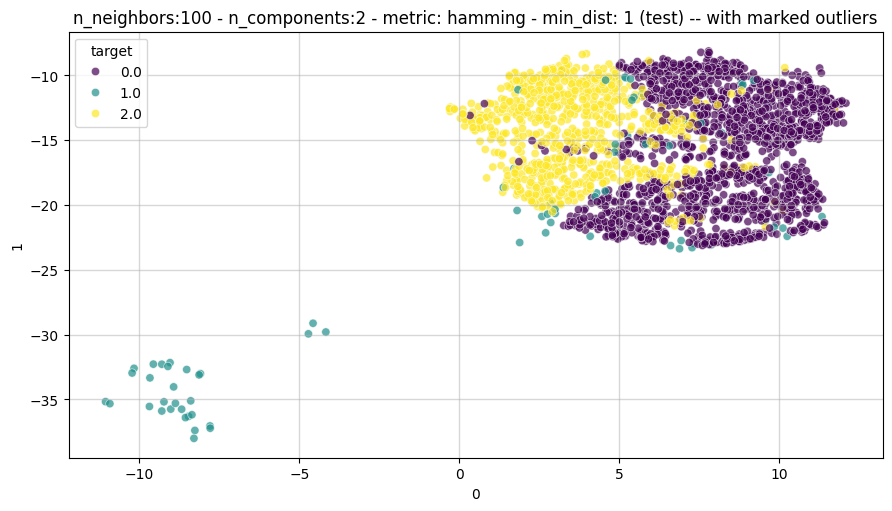

In [100]:
UMAP_RESULTS = []
for n_neighbor in UMAP_PARAM['n_neighbors']:
    for n_c in UMAP_PARAM['n_components']:
        for metric_i in UMAP_PARAM['metric']:
            for _,min_dist in enumerate(UMAP_PARAM['min_dist']):
                try: 
                    UMAP_RESULTS.append(
                                        {
                                            f'{metric_i}-{n_c}-{n_neighbor}-{min_dist}':UMAPStudy(
                                                                                                    X_train= X_train_svmsmote[:,SELECT_INDX],
                                                                                                    y_train=y_train_svmsmote, 
                                                                                                    X_test= X_test_std[:,SELECT_INDX],
                                                                                                    y_test=y_test, 
                                                                                                    min_dist  = min_dist,
                                                                                                    n_neighbors = n_neighbor,
                                                                                                    n_components = n_c, 
                                                                                                    metric = metric_i,
                                                                                                    random_state = 42,
                                                                                                    title = f'n_neighbors:{n_neighbor} - n_components:{n_c} - metric: {metric_i} - min_dist: {min_dist}' 
                                                                                                    )
                                            }
                                        )
                except ValueError as e:
                    print(e)

### **Como se adelanto, la medida de distancias que mejor conserva conservar el "manifold" es la metrica Hamming**

**Una vez fijada el tipo de metrica óptima, se van a buscar los Los demás hiperparámetros óptimos. Aunque segun se adelantó, se intuye que estos serán valores bajos del número de vecinos y valores bajos de la min_dist. Por otro lado y por razones de visualización, el número de componentes sera 2 (el espacio de menor dimension donde se mapean/incrustan los datapoints originales es bidimensional)**


**Para esta tarea:**

1. Se definen un rango de valores para cada hiperparámetro entre los cuales se estima que estará el óptimo.
2. Se crea un mapeador y se generan tantos conjuntos de entrenamiento y prueba mapeados a dos dimensiones como mapeadores creados.
3. Se entrena y predice (usando un SVC cuyos hiperparámetros no están optimizados) sobre cada conjunto de entrenamiento-prueba transformado y se selecciona el mapeador, X_train y X_test que mejores métricas y rendimiento de generalización proporcionan.

In [101]:
UMAP_RESULTS

[{'hamming-2-10-0.1': (array([[15.564262 ,  9.547604 ],
          [-1.0690513,  7.7534738],
          [-2.170518 ,  7.6268873],
          ...,
          [13.502366 , 11.603159 ],
          [13.973483 , 11.431207 ],
          [ 7.1536574, 14.113475 ]], dtype=float32),
   array([[ 3.6236694,  6.2046614],
          [ 0.8992733,  4.784204 ],
          [ 7.0702896, 14.675594 ],
          ...,
          [14.297722 , 10.357222 ],
          [-2.0031219,  7.7369347],
          [ 2.8085446,  9.223215 ]], dtype=float32),
   UMAP(metric='hamming', n_neighbors=10, random_state=42, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True}))},
 {'hamming-2-10-0.5': (array([[16.06834   ,  9.62723   ],
          [ 0.49358478,  8.600419  ],
          [-0.36612204,  7.240699  ],
          ...,
          [16.26497   , 11.27362   ],
          [15.372427  , 12.303691  ],
          [ 8.235122  , 16.49074   ]], dtype=float32),
  

### Antes de aplicar nuestros modelos óptimos sobre este nuevo espacio de características, vamos a llevar a cabo un primer enfoque con una máquina de vectores soporte para demostrar la mejora del rendimiento en la clasificación de la clase minoritaria en el conjunto de test.

**Se pueden observar en los reportes y gráficas de límite de decisión (sin usar un modelo de SVC muy optimizado) el incremento de las métricas y la mejora del rendimiento de generalización del modelo**

In [102]:
from sklearn.svm import SVC
svm =  SVC(
                                kernel='rbf', 
                                class_weight='balanced', 
                                gamma=0.1, 
                                C=1,
                                probability=True, 
                                random_state=42
                                )
clf_for_UMAP_set = {'SVC':svm}

Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [=         ] 10%

Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 4.237552165985107
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.957629  0.956463  0.957043          NaN             0.970252
Test   0.834151  0.873224  0.851755          NaN             0.896476
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 3.606968641281128
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.955859  0.959512  0.957667          NaN             0.968266
Test   0.817371  0.850577  0.832616          NaN             0.883768
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 4.235751628875732
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.941693  0.913028  0.926311          NaN              0.95767
Test   0.791574  0.762591  0.774974          NaN             0.866042
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 3.973670482635498
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.965928  0.980197   0.97286          NaN             0.975274
Test   0.808473  0.934584  0.853043          NaN             0.883402
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 4.2205281257629395
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.960402  0.972765  0.966429          NaN             0.971643
Test   0.802232  0.879867  0.832931          NaN             0.878606
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 3.568183422088623
        Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC        NaN       NaN       NaN          NaN                  NaN
Train  0.94979  0.960934  0.955201          NaN               0.9625
Test   0.78688   0.86094  0.815148          NaN             0.864941
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 3.006941795349121
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.975017  0.984763  0.979789          NaN             0.981167
Test    0.80772  0.971088  0.858293          NaN             0.885138
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 3.13600492477417
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.955763  0.962154  0.958662          NaN             0.964279
Test   0.796393  0.947408  0.843904          NaN             0.871637
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 3.446648597717285
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.946738  0.954824  0.950437          NaN             0.956639
Test   0.797548  0.939291  0.843322          NaN             0.869559
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 2.2282791137695312
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.974453  0.985467  0.979809          NaN             0.981368
Test   0.797445  0.968028   0.84809          NaN             0.878399
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 3.2584307193756104
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.958003  0.963622  0.960469          NaN             0.966279
Test   0.804076  0.951967   0.85163          NaN             0.876999
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [          ] 0%

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\sklearn\metrics\_plot\confusion_matrix.py:136: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 4.360371351242065
         Recall Precision   F1Score JaccardIndex geometric_mean_score
SVC         NaN       NaN       NaN          NaN                  NaN
Train  0.949049  0.954945  0.951661          NaN             0.958259
Test   0.735872  0.938173  0.780167          NaN             0.834094


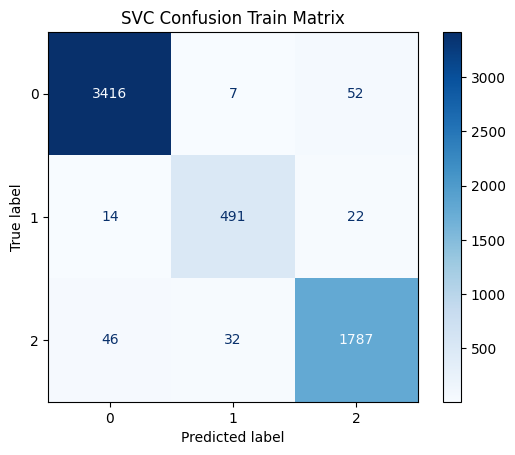

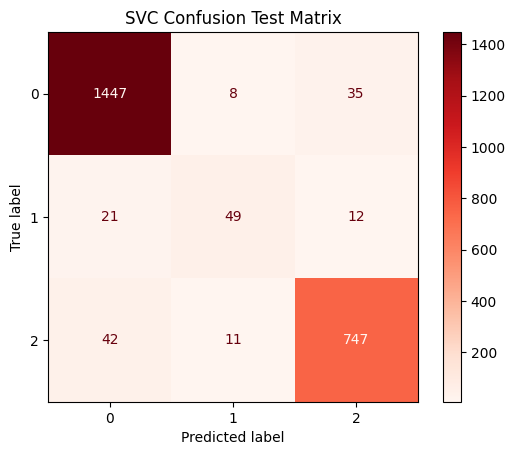

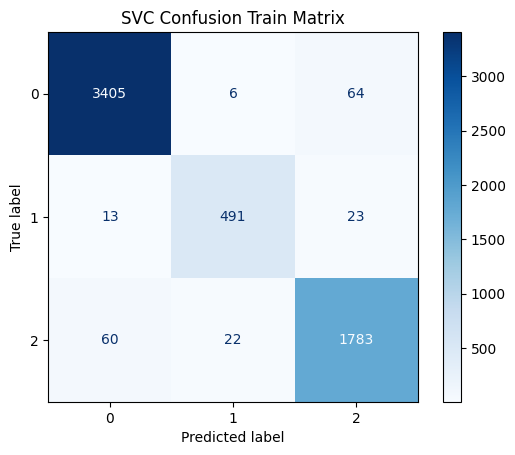

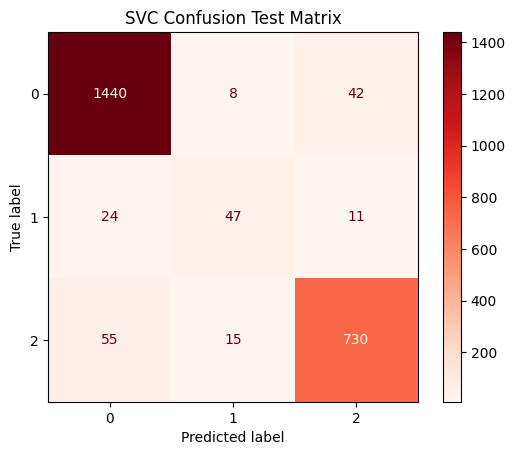

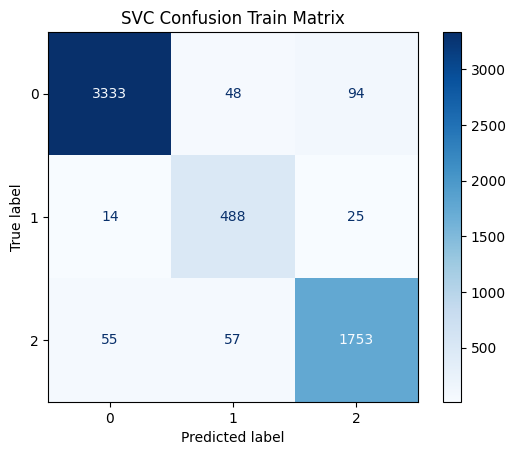

...

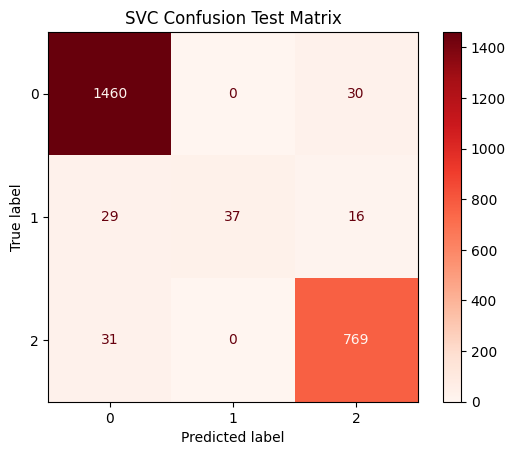

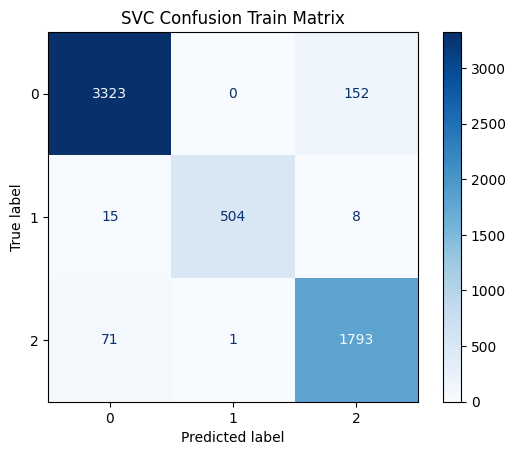

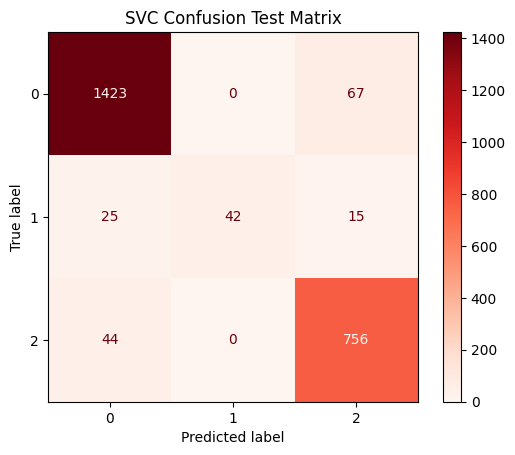

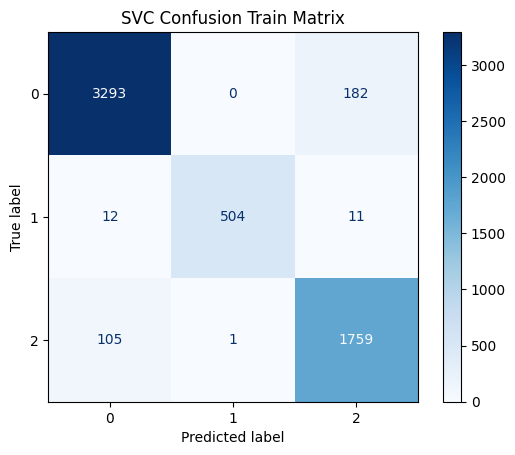

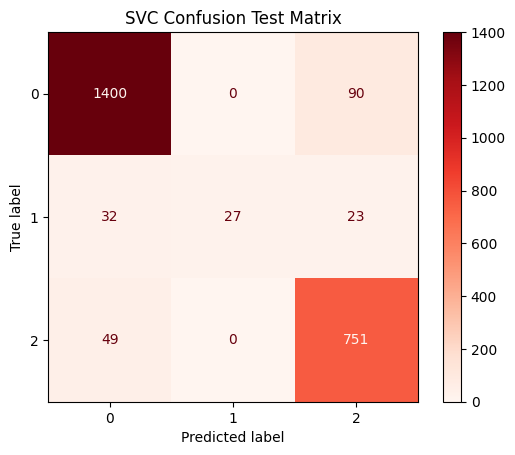

In [103]:
from Paquetes.visualization import plt_decison_boundaries
from Paquetes.metrics import  clasification_metrics


for UMAP_result_i in UMAP_RESULTS:
    svm =  SVC(
                                kernel='rbf', 
                                class_weight='balanced', 
                                gamma=0.1, 
                                C=1,
                                probability=True, 
                                random_state=42
                                )
    clf_for_UMAP_set = {'SVC':svm}
    
    X_train_UMAP = list(UMAP_result_i.values())[0][0]
    X_test_UMAP = list(UMAP_result_i.values())[0][1]
    UMAP_mapper = list(UMAP_result_i.values())[0][2]
    
    metrics_UMAP = {}
    for name,clf in clf_for_UMAP_set.items():
        plt_decison_boundaries (
                                    y_test = y_test ,
                                    x_test = X_test_UMAP ,
                                    y_train = y_train_svmsmote ,
                                    x_train = X_train_UMAP ,
                                    classifier = clf ,
                                    resolution = 0.1,
                                    title =  f'{name} {list(UMAP_result_i.keys())[0]}'
                                    )
        metrics_UMAP= clasification_metrics(
                                                            y_train = y_train_svmsmote,
                                                            x_train= X_train_UMAP,
                                                            y_test  = y_test,
                                                            x_test = X_test_UMAP,
                                                            clasifier = [clf],
                                                            average = 'macro',
                                                            metrics = [
                                                                            "Recall" ,
                                                                            "Precision",
                                                                            "F1Score",
                                                                            "Especificidad" ,
                                                                            "geometric_mean_score"
                                                                        ],
                                                            plot_roc_curve = False,
                                                            plot_confusion_matrix = True,

                                                            )
    print(metrics_UMAP[0].head())

In [104]:
metrics_UMAP[0].head()

,Recall,Precision,F1Score,JaccardIndex,geometric_mean_score
SVC,NaN,NaN,NaN,NaN,NaN
Train,0.949049,0.954945,0.951661,NaN,0.958259
Test,0.735872,0.938173,0.780167,NaN,0.834094


In [105]:
for name,clf in clf_for_UMAP_set.items():
    clf.fit(X_train_UMAP, y_train_svmsmote)

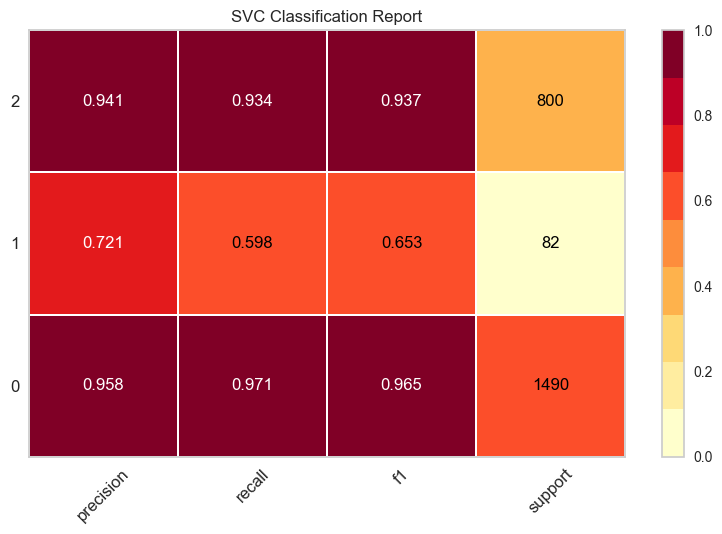

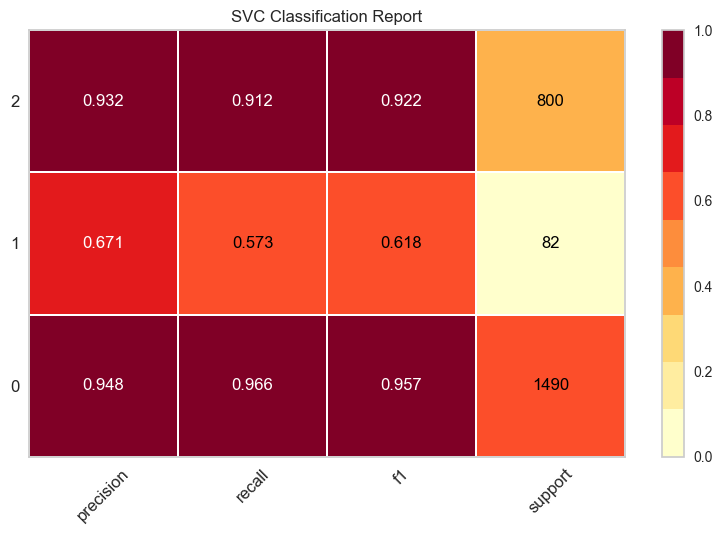

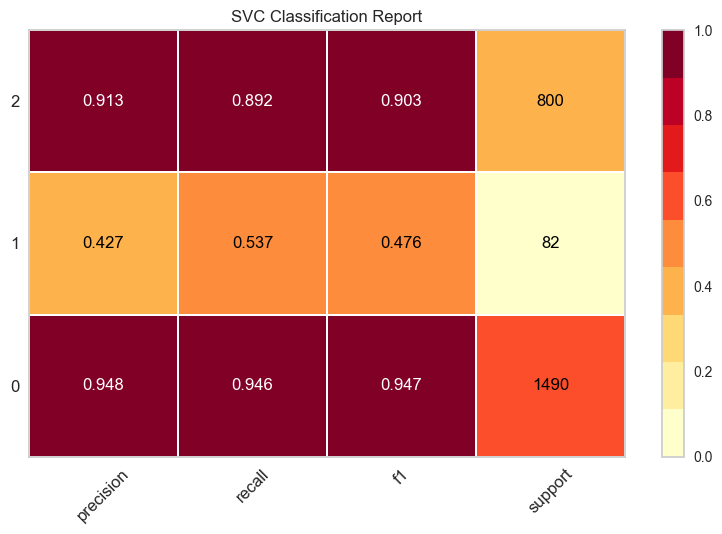

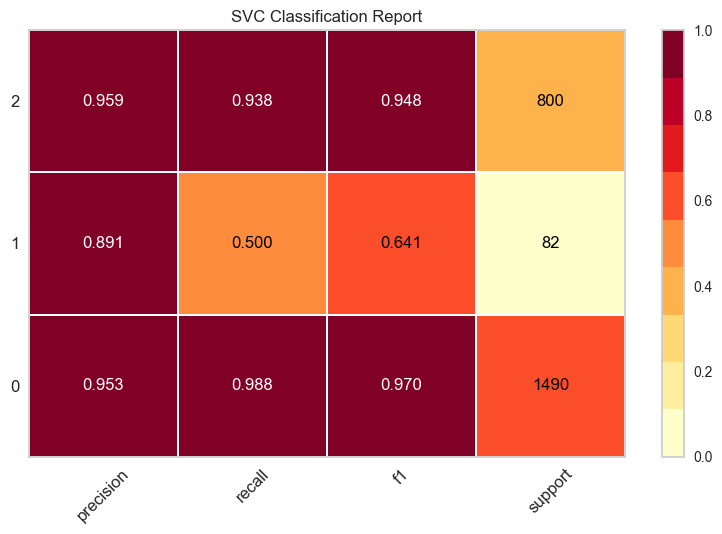

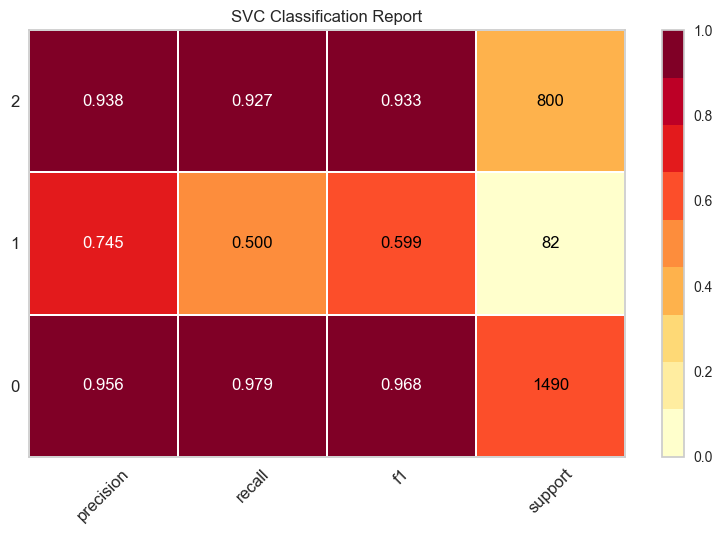

...

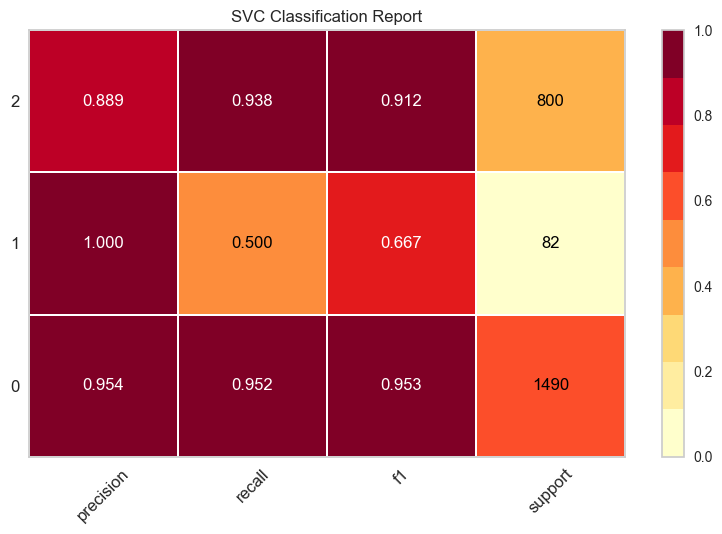

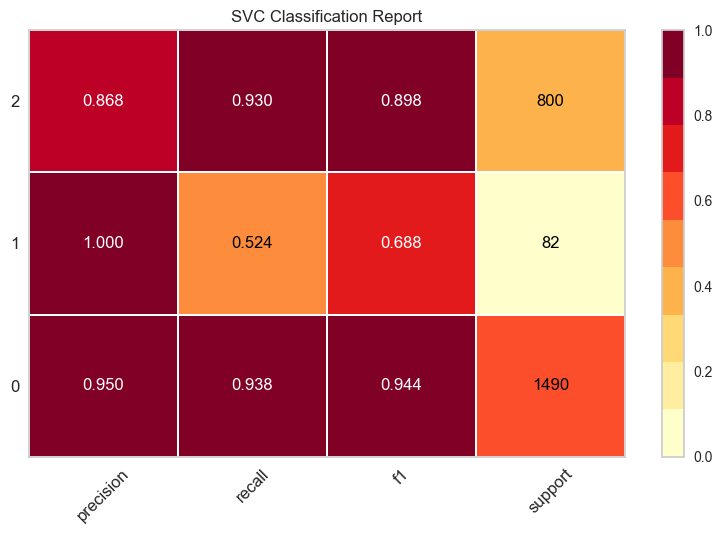

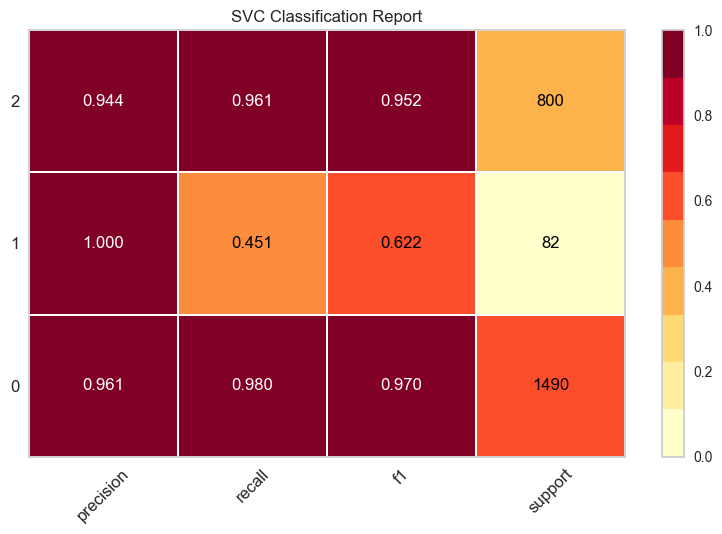

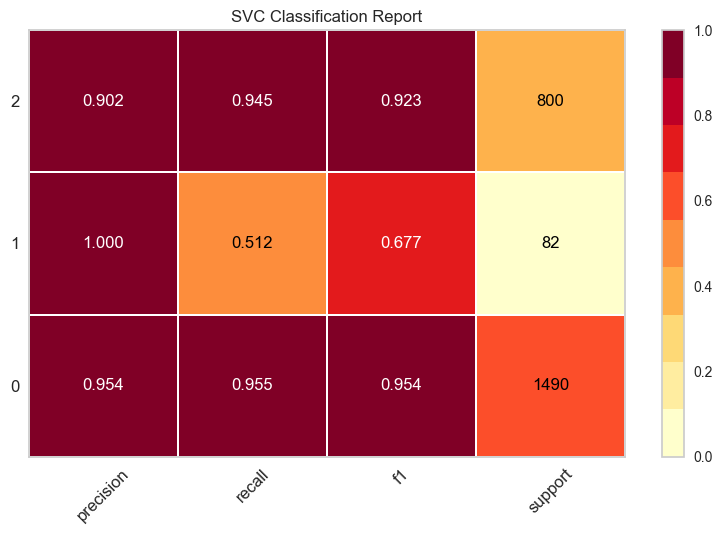

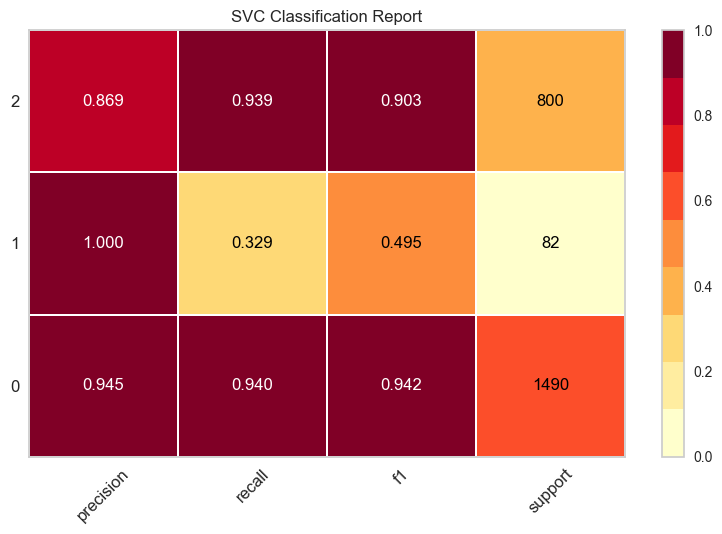

In [106]:
from yellowbrick.classifier import ClassificationReport
# Specify the target classes

classes = list(np.unique(y_train_svmsmote))

for UMAP_result_i in UMAP_RESULTS:
    svm =  SVC(
                                kernel='rbf', 
                                class_weight='balanced', 
                                gamma=0.1, 
                                C=1,
                                probability=True, 
                                random_state=42
                                )
    clf_for_UMAP_set = {'SVC':svm}
    
    X_train_UMAP = list(UMAP_result_i.values())[0][0]
    X_test_UMAP = list(UMAP_result_i.values())[0][1]
    UMAP_mapper = list(UMAP_result_i.values())[0][2]
    
    for name,clf in clf_for_UMAP_set.items():
        visualizer = ClassificationReport(clf, classes=classes, support=True)
        visualizer.fit(X_train_UMAP, y_train_svmsmote)       
        visualizer.score(X_test_UMAP, y_test)       
        visualizer.show()   

#### **Hiperparámetro n_neighbors:**

A medida que aumenta el número de vecinos (como era de esperar), UMAP "aisla" menos la clase minoritaria. Esto es que al aumentar estos vecinos, UMAP pasa de concentrarse en la estructura muy local a una más global, perdiendo la estructura de detalle. Esto se traduce en una **caída en el recall de la clase minoritaria 1**. Es decir, al perder la conservación de la estructura local, predecimos menos instancias de la clase minoritaria respecto de las instancias que realmente son de la clase 1 en el conjunto de prueba. Se consiguen predecir menos instancias de la clase minoritaria porque han quedado mas cerca de otras clases al conservar menor detalle del manifold. 

No hay que fijarse tanto en la precisión sobre esta clase porque esta me indica: de todas las instancias predichas de la clase 1, cuáles eran realmente de esta clase (cuáles eran TP). 
Y a nosotros nos interesa abarcar más predicciones correctas de la clase 1 (la minoritaria).

Por ello, el hiperparámetro óptimo es el menor número de vecinos. Como mejora del trabajo, se podrían, por ejemplo, bajar el número de vecinos, observar qué forma genera el mapeador a partir de los datos incrustados o transformados y mirar si mejora el rendimiento de esta SVC.

#### **Por otro lado, está el hiperparámetro min_dist:**

El parámetro min_dist controla lo ajustado que UMAP puede empaquetar los puntos. Literalmente, proporciona la distancia mínima a la que se permite que estén los puntos en la representación de baja dimensión. Esto significa que valores bajos de min_dist resultarán en incrustaciones más "compactas". Esto es útil para nuestro problema porque estamos interesados en la agrupación, o en la estructura topológica más fina.

Luego tendría sentido una menor distancia, aunque para n_neighbors = 10, apenas hay variación en el recall al cambiar la distancia mínima (mejora ligeramente para un valor medio pero empeora  la precisión sobre esa clase), luego no es muy determinante y se elige la menor distancia mínima del rango de valores escogido. [0.1].


## **Resultados finales de UMAP:**

### **Hiperparametros optimos**

- **Metrica de distancia** : Hamming

- **n_neighbors:** : 10

- **n_components:** : 2

- **min_dist:** : 0.1

*A continuación, se escoge el mapper definitivo y el conjunto de train-test transformados mediante este mapper*

**De ahora en adelante, se aplicarán las predicciones sobre este conjunto de test y train en este nuevo espacio bidimensional**

**El mapper se añadirá al pipeline final y toda muestra quedará mapeada o incrustada en este nuevo espacio antes de predecir su clase.**

In [107]:
select_case = 'hamming-2-10-0.1'
for UMAP_result_i in UMAP_RESULTS:
    if UMAP_result_i.get(select_case,None) != None:
        X_train_UMAP = UMAP_result_i[select_case][0]
        X_test_UMAP = UMAP_result_i[select_case][1]
        UMAP_mapper = UMAP_result_i[select_case][2]

# GRID SEARCH Y TRAINING JOSEBA

In [108]:
### X train, y train, X test, y test
X_train = X_train_UMAP
y_train = y_train_svmsmote
X_test = X_test_UMAP
y_test = y_test

In [109]:
xgb_cl = xgb.XGBClassifier()
rf_cl = RandomForestClassifier()
gb_cl = GradientBoostingClassifier()
svm =  SVC()

In [110]:
# Local optuna optimization test (cross val score: .4129666179319006), 21 FEATS
xgb_params = {'objective': 'multi_logloss', 'early_stopping_rounds': 50, 'max_depth': 9, 'min_child_weight': 8, 'learning_rate': 0.0337716365315986, 'n_estimators': 733, 'subsample': 0.6927955384688348, 'colsample_bytree': 0.1234702658812108, 'reg_alpha': 0.18561628377665318, 'reg_lambda': 0.5565488299127089, 'random_state': 42}
xgb_params2 = {'objective': 'multi_logloss', 'max_depth': 9, 'min_child_weight': 8, 'n_estimators': 733, 'subsample': 0.6927955384688348, 'colsample_bytree': 0.1234702658812108, 'reg_alpha': 0.18561628377665318, 'reg_lambda': 0.5565488299127089, 'random_state': 42}

In [111]:
# Add parameters for each classifier to test out in Randomized Search
random_forest_params = {
    'n_estimators': [10, 50, 100, 200, 300],
    'max_features': [ 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

xgboost_params = {
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'n_estimators': [50, 100, 200, 300],
    'max_depth': [3, 5, 7, 9],
    'min_child_weight': [1, 3, 5],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
    'gamma': [0, 0.1, 0.2, 0.3, 0.4],
    'num_class':[3]
}

gradient_boosting_params = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.2, 0.3],
    'max_depth': [3, 5, 7, 9],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'subsample': [0.8, 0.9, 1.0]
}

svc_params = {
    'C': [0.1, 1, 10, 100],  # Parámetro de regularización
    'kernel': ['rbf', 'sigmoid'],  # Tipo de kernel
    'gamma': ['scale', 'auto'],  # Coeficiente del kernel ('scale' usa 1 / (n_features * X.var()) y 'auto' usa 1 / n_features)
    'shrinking': [True, False],  # Si se debe usar el encojimiento heurístico
    'probability': [True]  # Si se deben habilitar estimaciones de probabilidad
}


In [112]:
# Add possible parameters for each classifier to a list
rs_params = [random_forest_params, xgboost_params, gradient_boosting_params,svc_params]

# Initialize dictionary of best params
best_params_rs = {}

In [113]:
# Store all classifiers in a list of dictionaries
models = [
    {"name": "rf_cl", "model": rf_cl,'best_hparams':random_forest_params},
    {"name": "xgb_cl", "model": xgb_cl,'best_hparams': xgboost_params},
    {"name": "gb_cl", "model": gb_cl,'best_hparams': gradient_boosting_params},
    {"name": "svm_cl", "model": svm,'best_hparams': svc_params},
]

In [114]:
models

[{'name': 'rf_cl',
  'model': RandomForestClassifier(),
  'best_hparams': {'n_estimators': [10, 50, 100, 200, 300],
   'max_features': ['sqrt', 'log2'],
   'max_depth': [None, 10, 20, 30, 40, 50],
   'min_samples_split': [2, 5, 10],
   'min_samples_leaf': [1, 2, 4],
   'bootstrap': [True, False]}},
 {'name': 'xgb_cl',
  'model': XGBClassifier(base_score=None, booster=None, callbacks=None,
                colsample_bylevel=None, colsample_bynode=None,
                colsample_bytree=None, device=None, early_stopping_rounds=None,
                enable_categorical=False, eval_metric=None, feature_types=None,
                gamma=None, grow_policy=None, importance_type=None,
                interaction_constraints=None, learning_rate=None, max_bin=None,
                max_cat_threshold=None, max_cat_to_onehot=None,
                max_delta_step=None, max_depth=None, max_leaves=None,
                min_child_weight=None, missing=nan, monotone_constraints=None,
                multi_st

In [115]:
# Create Randomized Search for each algorithm
for i, model in enumerate(models): 
    rs = RandomizedSearchCV(estimator=model['model'], param_distributions=model['best_hparams'], n_iter=10, cv=6, random_state=42, n_jobs=-1)
    rs.fit(X_train, y_train)
    models[i]['best_hparams'] = rs.best_params_
    print(model['name'], ':', rs.best_params_)


rf_cl : {'n_estimators': 10, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'log2', 'max_depth': 30, 'bootstrap': True}
xgb_cl : {'subsample': 0.8, 'num_class': 3, 'n_estimators': 200, 'min_child_weight': 1, 'max_depth': 9, 'learning_rate': 0.1, 'gamma': 0.4, 'colsample_bytree': 1.0}
gb_cl : {'subsample': 0.8, 'n_estimators': 50, 'min_samples_split': 2, 'min_samples_leaf': 4, 'max_depth': 5, 'learning_rate': 0.2}
svm_cl : {'shrinking': False, 'probability': True, 'kernel': 'rbf', 'gamma': 'auto', 'C': 100}


In [116]:
models

[{'name': 'rf_cl',
  'model': RandomForestClassifier(),
  'best_hparams': {'n_estimators': 10,
   'min_samples_split': 2,
   'min_samples_leaf': 2,
   'max_features': 'log2',
   'max_depth': 30,
   'bootstrap': True}},
 {'name': 'xgb_cl',
  'model': XGBClassifier(base_score=None, booster=None, callbacks=None,
                colsample_bylevel=None, colsample_bynode=None,
                colsample_bytree=None, device=None, early_stopping_rounds=None,
                enable_categorical=False, eval_metric=None, feature_types=None,
                gamma=None, grow_policy=None, importance_type=None,
                interaction_constraints=None, learning_rate=None, max_bin=None,
                max_cat_threshold=None, max_cat_to_onehot=None,
                max_delta_step=None, max_depth=None, max_leaves=None,
                min_child_weight=None, missing=nan, monotone_constraints=None,
                multi_strategy=None, n_estimators=None, n_jobs=None,
                num_parallel_tree=No

In [117]:
with open('BestModels/random_search_models.pkl', 'wb') as f:
    pickle.dump(models, f)
if os.path.exists('BestModels/random_search_models.pkl'):
    with open('BestModels/random_search_models.pkl', 'rb') as f:
        models_rs = pickle.load(f)
else:
    print('No models found')


In [118]:
models_rs

[{'name': 'rf_cl',
  'model': RandomForestClassifier(),
  'best_hparams': {'n_estimators': 10,
   'min_samples_split': 2,
   'min_samples_leaf': 2,
   'max_features': 'log2',
   'max_depth': 30,
   'bootstrap': True}},
 {'name': 'xgb_cl',
  'model': XGBClassifier(base_score=None, booster=None, callbacks=None,
                colsample_bylevel=None, colsample_bynode=None,
                colsample_bytree=None, device=None, early_stopping_rounds=None,
                enable_categorical=False, eval_metric=None, feature_types=None,
                gamma=None, grow_policy=None, importance_type=None,
                interaction_constraints=None, learning_rate=None, max_bin=None,
                max_cat_threshold=None, max_cat_to_onehot=None,
                max_delta_step=None, max_depth=None, max_leaves=None,
                min_child_weight=None, missing=nan, monotone_constraints=None,
                multi_strategy=None, n_estimators=None, n_jobs=None,
                num_parallel_tree=No

In [119]:
"""models_gs = []
for _, model in enumerate(models_rs):
    print(model['name'])
    gs = GridSearchCV(estimator=model['model'], param_grid=model['best_hparams'], cv=6, n_jobs=-1, verbose=0)
    gs.fit(X_train, y_train)
    models_gs.append(
                        {'name' : model['name'],
                         "model": model['model'], # duda si eso o : gs.best_estimator_
                         'best_hparams': gs.best_params_
                         }
                    )


with open('BestModels/grid_search_models.pkl', 'wb') as f:
    pickle.dump(models_gs, f)

# Deserialize 
with open('BestModels/grid_search_models.pkl', 'rb') as f:
    models_gs = pickle.load(f)"""



'models_gs = []\nfor _, model in enumerate(models_rs):\n    print(model[\'name\'])\n    gs = GridSearchCV(estimator=model[\'model\'], param_grid=model[\'best_hparams\'], cv=6, n_jobs=-1, verbose=0)\n    gs.fit(X_train, y_train)\n    models_gs.append(\n                        {\'name\' : model[\'name\'],\n                         "model": model[\'model\'], # duda si eso o : gs.best_estimator_\n                         \'best_hparams\': gs.best_params_\n                         }\n                    )\n\n\nwith open(\'BestModels/grid_search_models.pkl\', \'wb\') as f:\n    pickle.dump(models_gs, f)\n\n# Deserialize \nwith open(\'BestModels/grid_search_models.pkl\', \'rb\') as f:\n    models_gs = pickle.load(f)'

In [120]:
models_gs = models_rs

#### Complex Approach

In [121]:
fitted_models = {model['name'] : model['model'].set_params(**model['best_hparams']).fit(X_train,y_train) for _,model in enumerate(models_gs)}

In [122]:
with open('BestModels/grid_search_fitted_models.pkl', 'wb') as f:
    pickle.dump(fitted_models, f)

# Deserialize 
with open('BestModels/grid_search_fitted_models.pkl', 'rb') as f:
    fitted_models = pickle.load(f)


In [123]:
fitted_models

{'rf_cl': RandomForestClassifier(max_depth=30, max_features='log2', min_samples_leaf=2,
                        n_estimators=10),
 'xgb_cl': XGBClassifier(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bynode=None,
               colsample_bytree=1.0, device=None, early_stopping_rounds=None,
               enable_categorical=False, eval_metric=None, feature_types=None,
               gamma=0.4, grow_policy=None, importance_type=None,
               interaction_constraints=None, learning_rate=0.1, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=9, max_leaves=None,
               min_child_weight=1, missing=nan, monotone_constraints=None,
               multi_strategy=None, n_estimators=200, n_jobs=None, num_class=3,
               num_parallel_tree=None, ...),
 'gb_cl': GradientBoostingClassifier(learning_rate=0.2, max_depth=5, min_samples_leaf=4,
                 

Note for RandomForestClassifier : model already fitted
Note for XGBClassifier : model already fitted
Note for GradientBoostingClassifier : model already fitted


Note for SVC : model already fitted
Exexcution time of clasification_metrics 2.8237335681915283


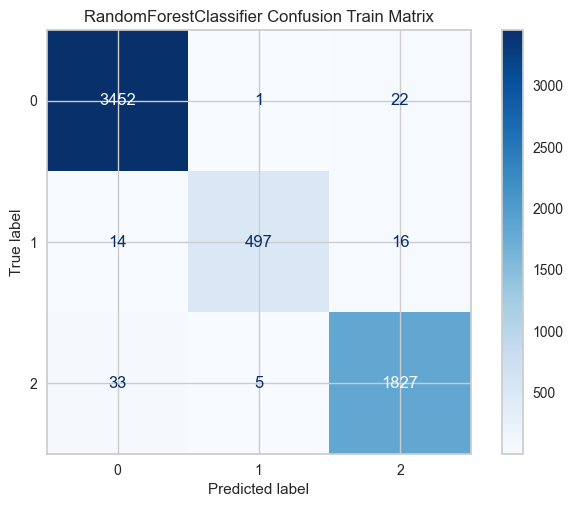

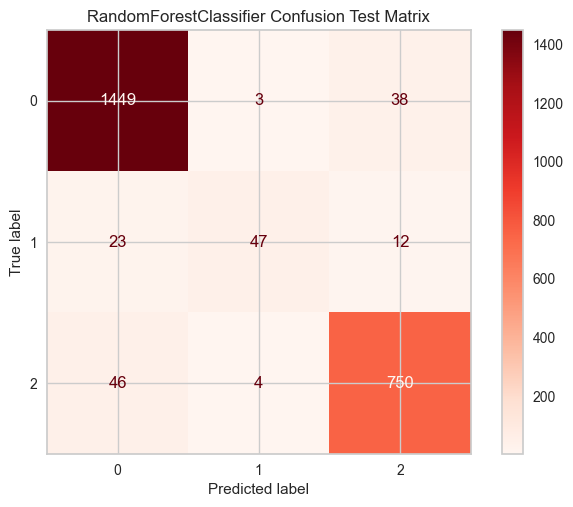

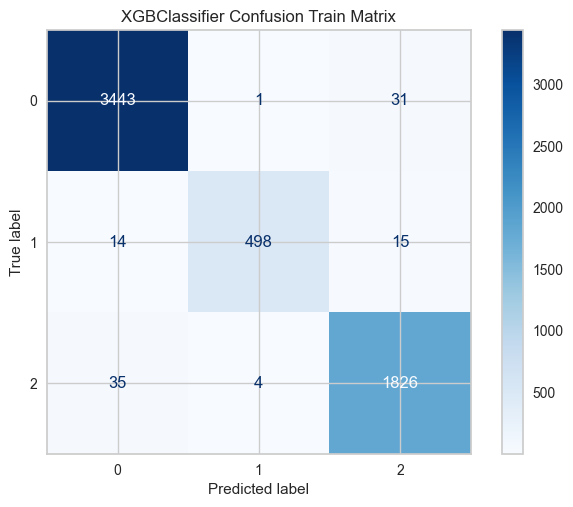

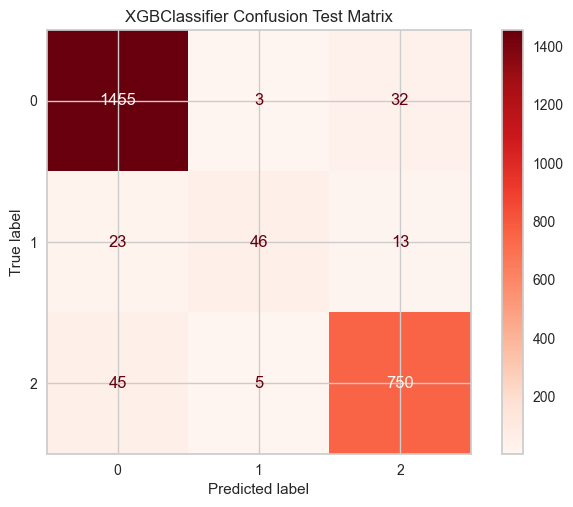

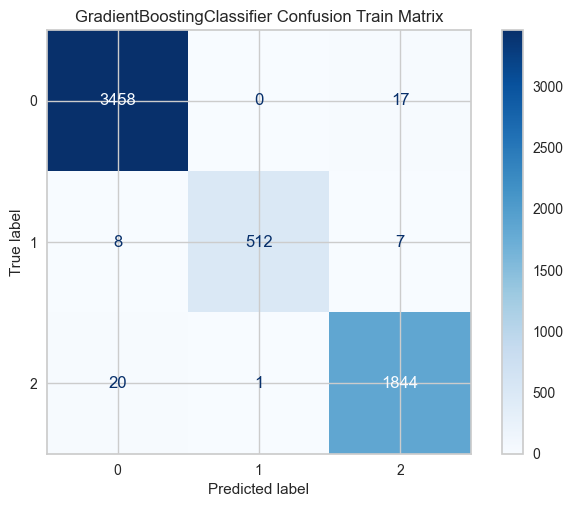

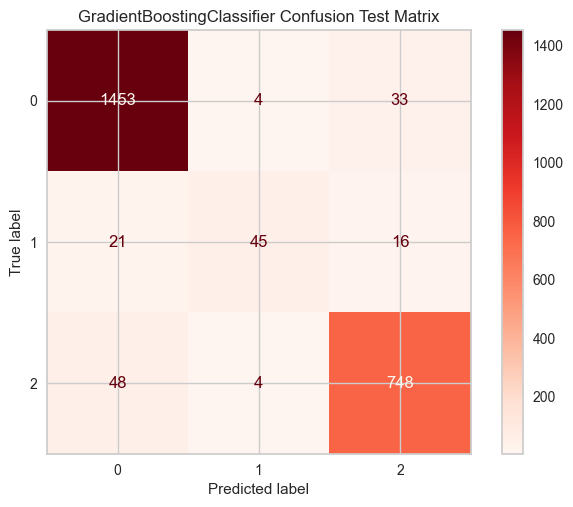

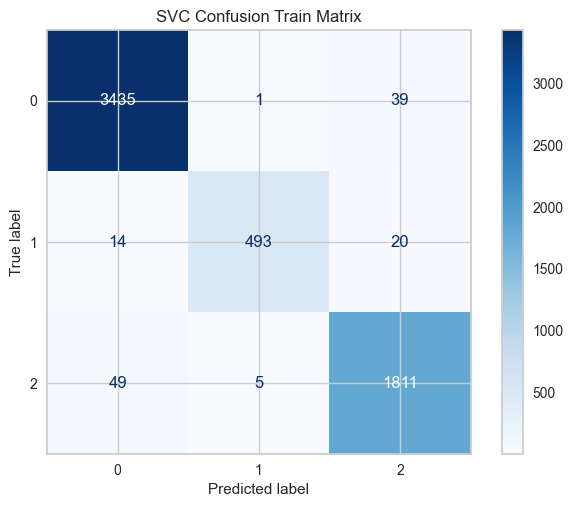

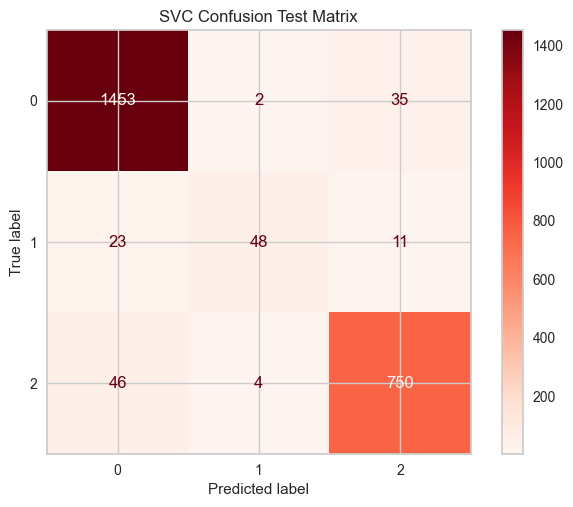

In [124]:
from Paquetes.metrics import  clasification_metrics
performace_ = clasification_metrics(
                                                            y_train = y_train,
                                                            x_train= X_train,
                                                            y_test  = y_test,
                                                            x_test = X_test,
                                                            clasifier =  [fit_model for fit_model in fitted_models.values()],
                                                            average = 'macro',
                                                            metrics = [
                                                                            "Recall" ,
                                                                            "Precision",
                                                                            "F1Score",
                                                                            "geometric_mean_score"
                                                                        ],
                                                            plot_roc_curve = False,
                                                            plot_confusion_matrix = True,

                                                    )

In [125]:
performace_[0].head()

,Recall,Precision,F1Score,JaccardIndex,geometric_mean_score
RandomForestClassifier,NaN,NaN,NaN,NaN,NaN
Train,0.972027,0.984755,0.978212,NaN,0.980928
Test,0.827718,0.920805,0.864036,NaN,0.892477


In [126]:
performace_[1].head()

,Recall,Precision,F1Score,JaccardIndex,geometric_mean_score
XGBClassifier,NaN,NaN,NaN,NaN,NaN
Train,0.971617,0.983818,0.97754,NaN,0.980284
Test,0.824995,0.916866,0.860908,NaN,0.891606


In [127]:
performace_[2].head()

,Recall,Precision,F1Score,JaccardIndex,geometric_mean_score
GradientBoostingClassifier,NaN,NaN,NaN,NaN,NaN
Train,0.985128,0.99239,0.988699,NaN,0.989572
Test,0.819649,0.91408,0.856077,NaN,0.888147


In [128]:
from Paquetes.cross_validate import cv_function
metrics = [
                'accuracy', 
                'precision_micro',
                'precision_macro',
                'recall_micro',
                'recall_macro',
                'f1_micro',
                'f1_macro',
                'jaccard_micro',
                'jaccard_macro',
                'roc_auc_ovr',
                'roc_auc_ovo',
                'roc_auc_ovr_weighted',
                'roc_auc_ovo_weighted'
            ]
cv_str = ['k-folds', 'Stratified K-folds']

scores = cv_function(
                        X_train = X_train , 
                        y_train = y_train, 
                        n_splits=5,
                        pipelines = [fit_model for fit_model in fitted_models.values()], 
                        metrics = metrics,
                        cv_strategies = cv_str,
                        random_state =  0,
                        shuffle = True
                    )


Note for RandomForestClassifier : model already fitted
Note for XGBClassifier : model already fitted


Note for GradientBoostingClassifier : model already fitted
Note for SVC : model already fitted


In [129]:
list(scores.values())

[                           k-folds Stratified K-folds
 RandomForestClassifier         NaN                NaN
 Val accuracy                 0.977              0.978
 Val precision_micro          0.977              0.978
 Val precision_macro          0.978              0.978
 Val recall_micro             0.977              0.978
 Val recall_macro             0.964              0.964
 Val f1_micro                 0.977              0.978
 Val f1_macro                  0.97              0.971
 Val jaccard_micro            0.955              0.956
 Val jaccard_macro            0.943              0.943
 Val roc_auc_ovr              0.983              0.984
 Val roc_auc_ovo              0.981              0.982
 Val roc_auc_ovr_weighted     0.986              0.987
 Val roc_auc_ovo_weighted     0.983              0.983
 Train accuracy               0.985              0.985
 Train precision_micro        0.985              0.985
 Train precision_macro        0.985              0.985
 Train rec

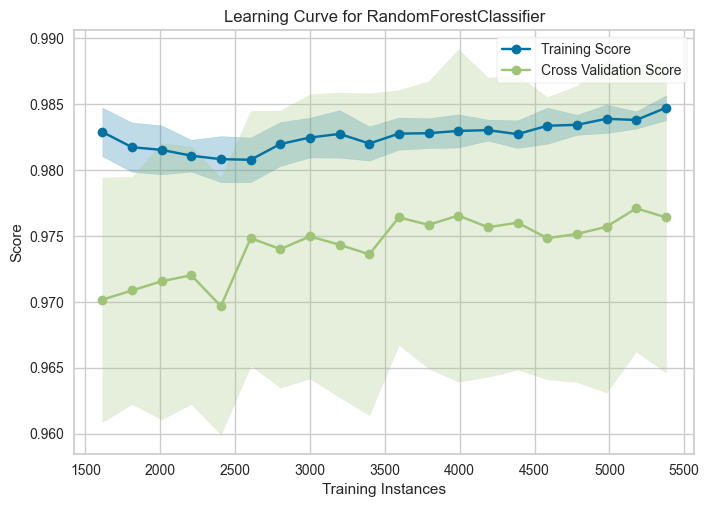

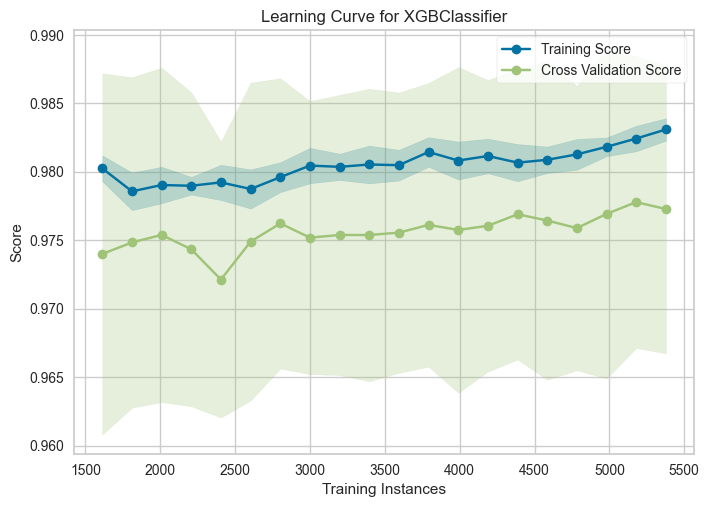

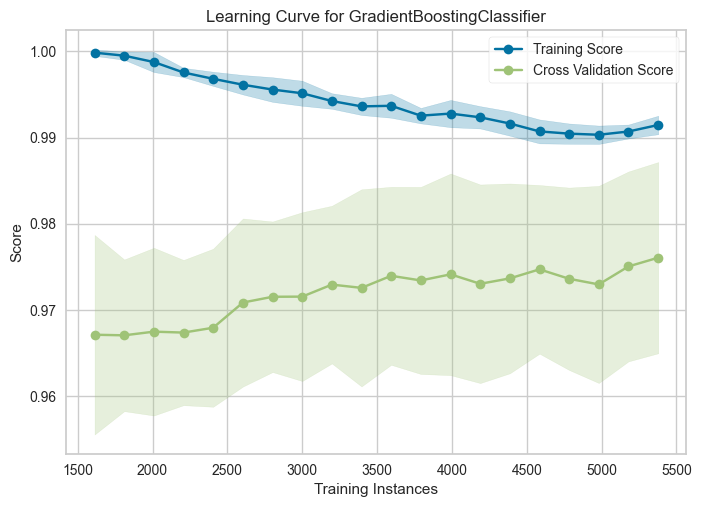

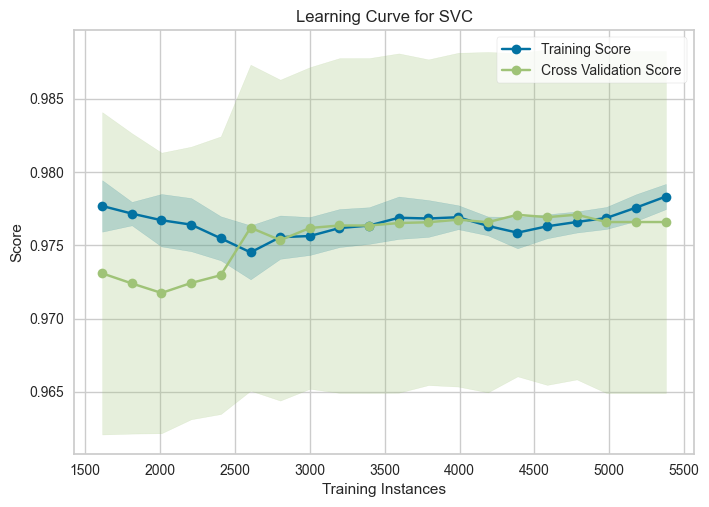

In [130]:
import numpy as np
from yellowbrick.model_selection import LearningCurve

# Create the learning curve visualizer
cv = StratifiedKFold(n_splits=12)
sizes = np.linspace(0.3, 1.0, 20)

# Instantiate the classification model and visualizer
for pipe in [fit_model for fit_model in fitted_models.values()]:
    visualizer = LearningCurve(
                                pipe, cv=cv, scoring='f1_weighted', train_sizes=sizes, n_jobs=-1
                            )
    visualizer.fit(X_train, y_train)       
    visualizer.show()   

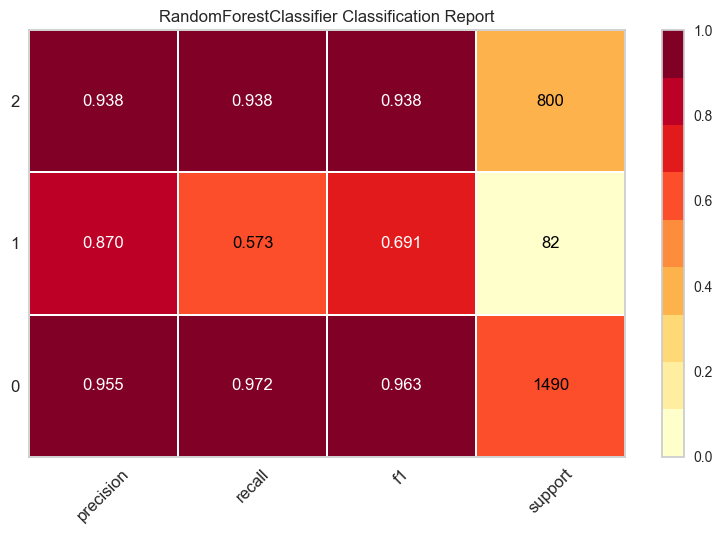

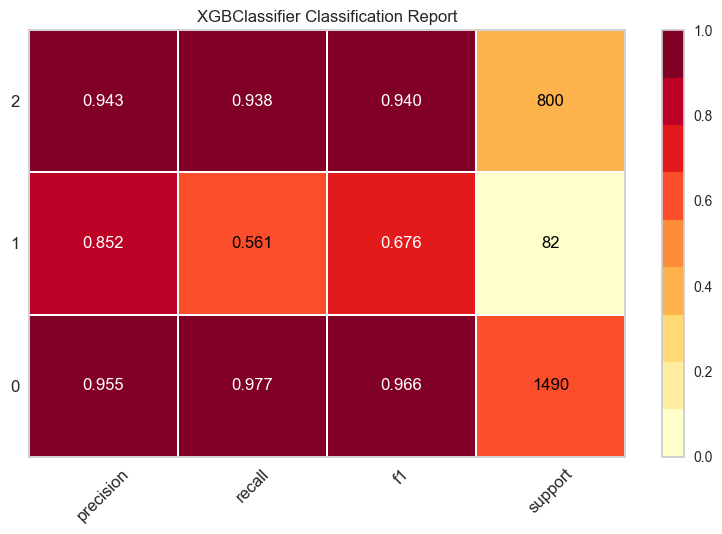

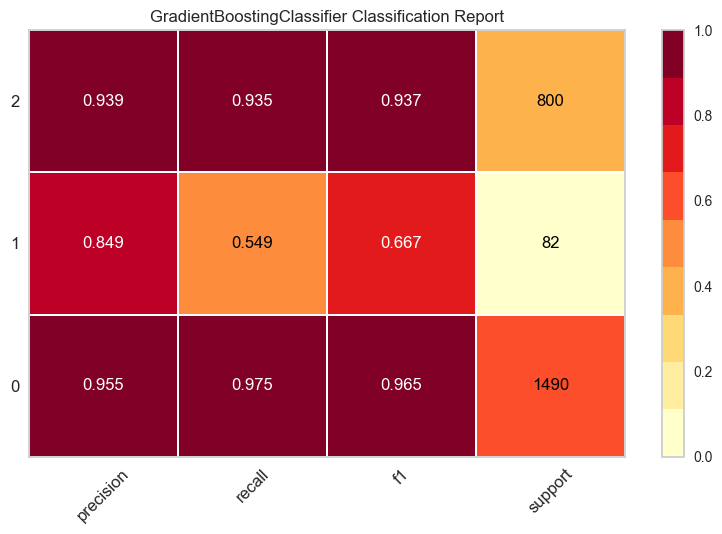

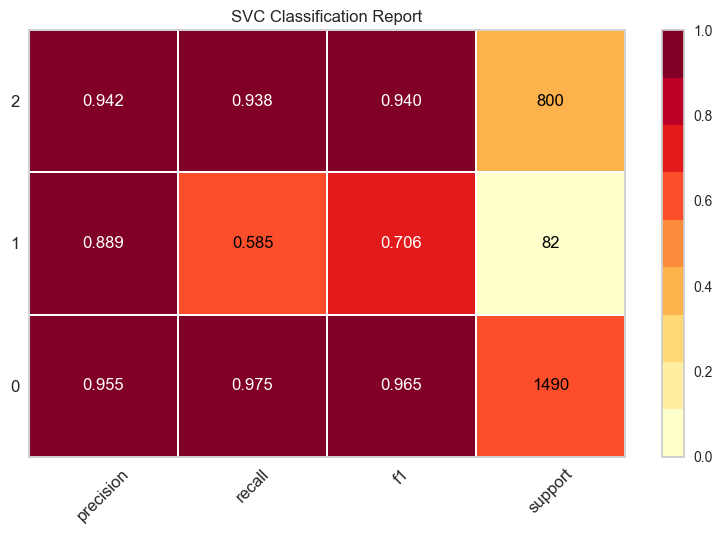

In [131]:
from yellowbrick.classifier import ClassificationReport
# Specify the target classes
classes = list(np.unique(y_train))

for pipe in [fit_model for fit_model in fitted_models.values()]:
    visualizer = ClassificationReport(pipe, classes=classes, support=True)
    visualizer.fit(X_train, y_train)       
    visualizer.score(X_test, y_test)       
    visualizer.show()         

In [132]:
from Paquetes.metrics import plot_learning_curves

Note for RandomForestClassifier : This RandomForestClassifier instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training RandomForestClassifier model [          ] 0%

Training RandomForestClassifier model [==========] 100%

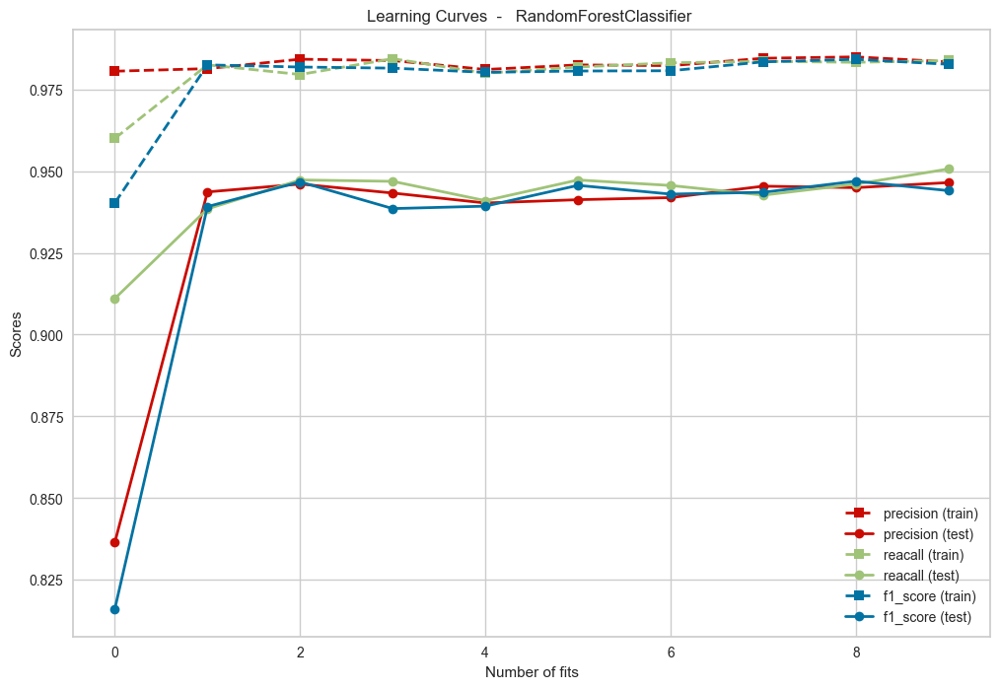

Note for XGBClassifier : need to call fit or load_model beforehand
Training XGBClassifier model [          ] 0%0%

c:\Users\Koke\Desktop\MASTER_IA\TareaFinalSupervised\env\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Training XGBClassifier model [==========] 100%

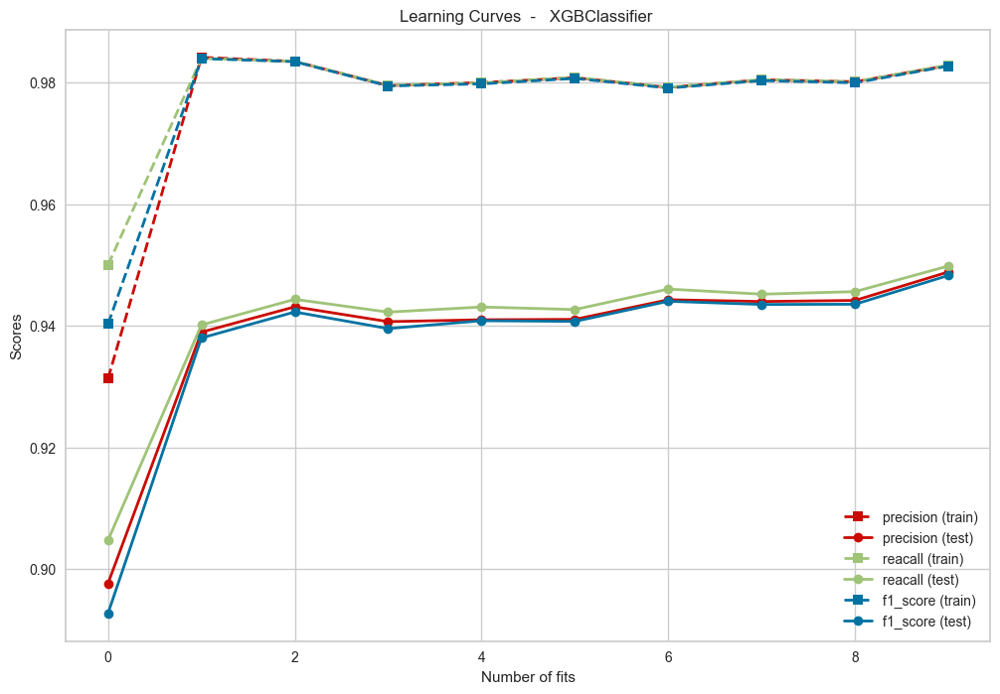

Note for GradientBoostingClassifier : This GradientBoostingClassifier instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training GradientBoostingClassifier model [==========] 100%

KeyboardInterrupt: 

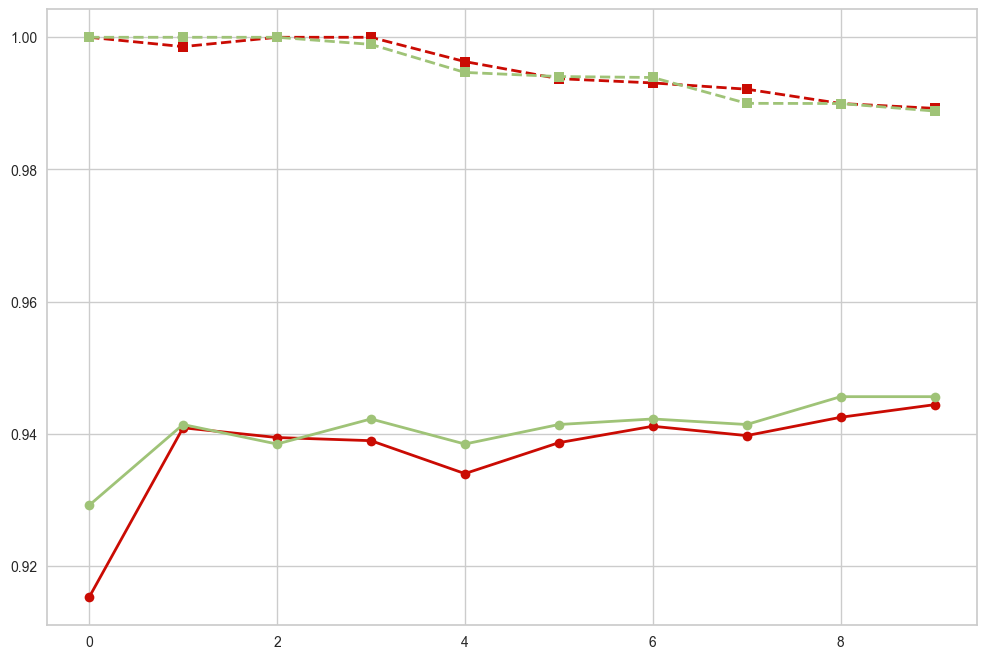

In [133]:
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score
with open('BestModels/random_search_models.pkl', 'rb') as f:
    models_rs = pickle.load(f)
for _,model in enumerate(models_rs):
    plot_learning_curves(
                        model = model['model'].set_params(**model['best_hparams']),
                        title = '',
                        X_train = X_train, 
                        y_train = y_train, 
                        X_test = X_test,
                        y_test = y_test,
                        metrics = {
                            'precision':precision_score,
                            'reacall':recall_score,
                            'f1_score':f1_score
                        },
                        n_fits = 10
    )

[{'name': 'rf_cl', 'model': RandomForestClassifier(), 'best_hparams': {'n_estimators': 10, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'log2', 'max_depth': 30, 'bootstrap': True}}, {'name': 'xgb_cl', 'model': XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...), 'best_hparams

Note for RandomForestClassifier : model already fitted
Exexcution time of clasification_metrics 0.49518442153930664
Note for XGBClassifier : need to call fit or load_model beforehand
Training XGBClassifier model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for XGBClassifier : model already fitted
Exexcution time of clasification_metrics 0.16300344467163086
Note for GradientBoostingClassifier : This GradientBoostingClassifier instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training GradientBoostingClassifier model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for GradientBoostingClassifier : model already fitted
Exexcution time of clasification_metrics 0.3714587688446045
Note for SVC : This SVC instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.
Training SVC model [==========] 100%X shape :  (8239, 2)
y_real_pred shape :  (8239,)
y_real shape :  (8239,)


Note for SVC : model already fitted
Exexcution time of clasification_metrics 4.758428335189819


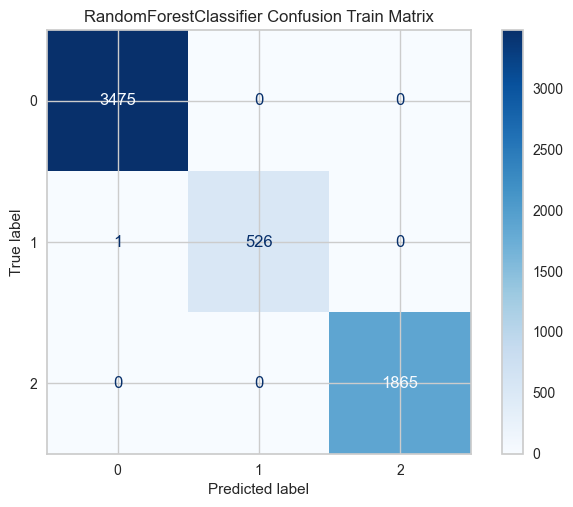

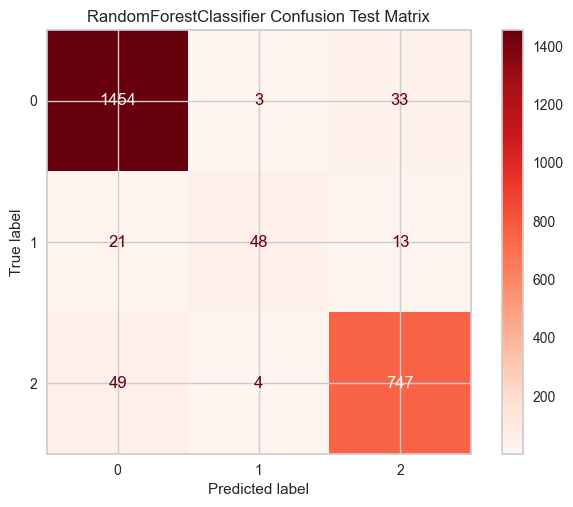

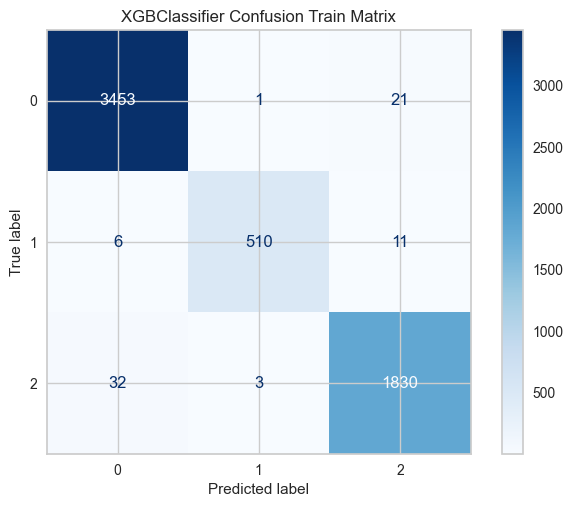

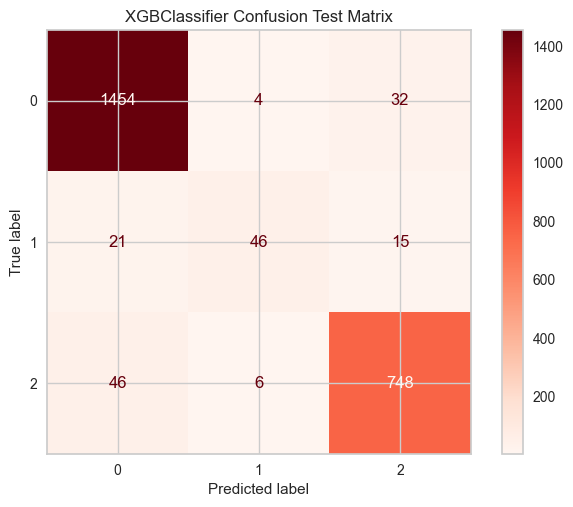

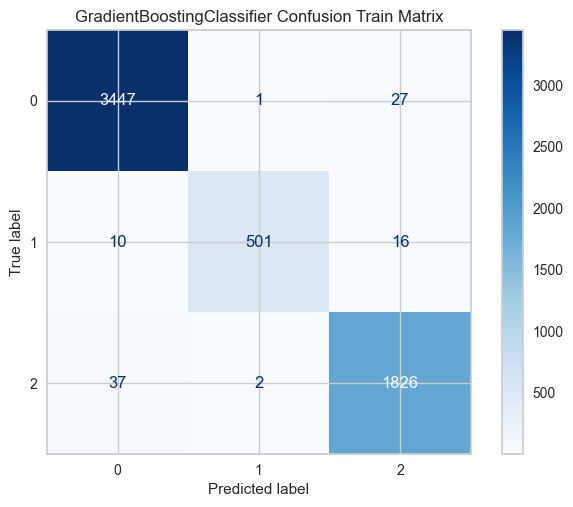

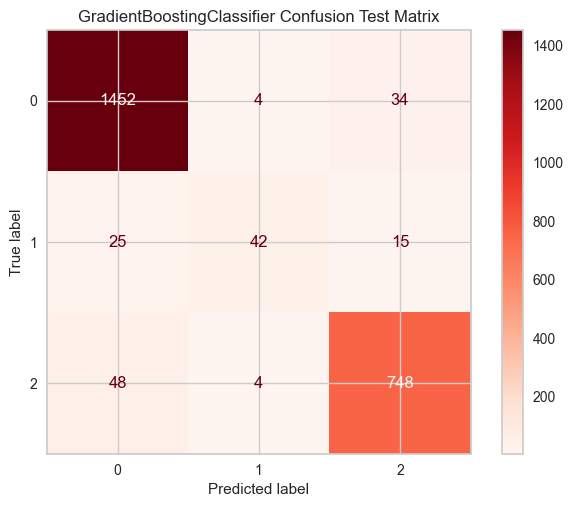

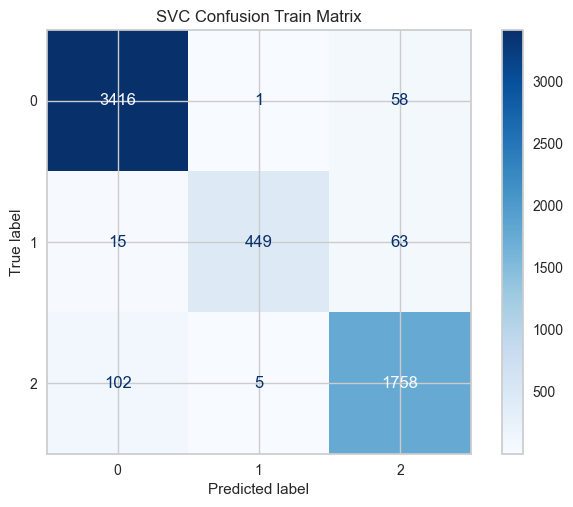

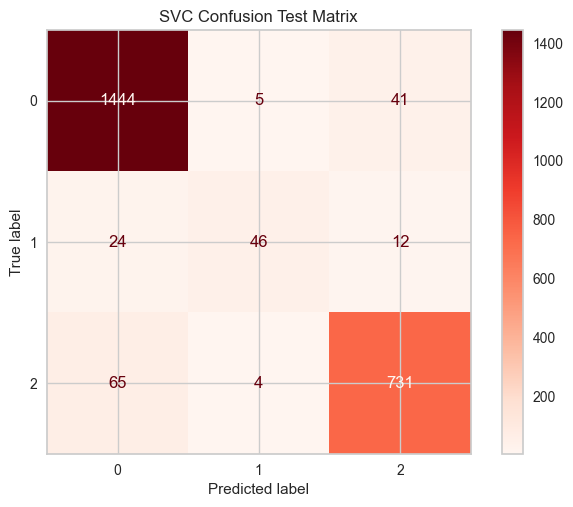

In [134]:
from Paquetes.visualization import plt_decison_boundaries
with open('BestModels/random_search_models.pkl', 'rb') as f:
    models_rs = pickle.load(f)

print(models_rs)

metrics_final = {}
for _,model in enumerate(models_rs):
    plt_decison_boundaries (
                                y_test = y_test ,
                                x_test = X_test ,
                                y_train = y_train ,
                                x_train = X_train ,
                                classifier = model['model'] ,
                                resolution = 0.1,
                                title =  f"{model['name']}"
                                )
    metrics_final[model['name']] = (clasification_metrics(
                                                        y_train = y_train,
                                                        x_train= X_train,
                                                        y_test  = y_test,
                                                        x_test = X_test,
                                                        clasifier = [model['model']],
                                                        average = 'macro',
                                                        metrics = [
                                                                        "Recall" ,
                                                                        "Precision",
                                                                        "F1Score",
                                                                        "Especificidad" ,
                                                                        "geometric_mean_score"
                                                                    ],
                                                        plot_roc_curve = False,
                                                        plot_confusion_matrix = True,

                                                        ))